# Initial Dataset Exploration for Distribution Shifts

In [18]:
import pandas as pd
import torch
import numpy as np
from scipy.stats import ks_2samp

## Basic Visualizations

In [19]:
# plot distribution for each column in df
import seaborn as sns
import matplotlib.pyplot as plt

def plot_distribution_compare(df1 = None, df2 = None, df3 = None, label1 = None, label2 = None, label3 = None, title = None):
    plt.figure(figsize=(16, 8))
    
    for i, column in enumerate(df1.columns, 1):
        plt.subplot(2, 3, i)
        sns.kdeplot(df1[column], label=label1)
        sns.kdeplot(df2[column], label=label2)
        if df3 is not None and label3 is not None:
            sns.kdeplot(df3[column], label=label3)

        plt.title(f"{column} Distribution")
        plt.legend()
    plt.suptitle(title)
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()

In [20]:
def plot_distribution_compare_class_wise(df1_class1 = None, df1_class2 = None, df2_class1 = None, df2_class2 = None, 
                                         df3_class1 = None, df3_class2= None, label1 = None, label2 = None, label3 = None, 
                                         class_label = None, title = None):
    plt.figure(figsize=(16, 8))


    for i, column in enumerate(df1_class1.columns, 1):
        plt.subplot(2, 3, i)
        sns.kdeplot(df1_class1[column], label=f"{label1} {class_label}")
        sns.kdeplot(df1_class2[column], label=f"{label1} No {class_label}")
        sns.kdeplot(df2_class1[column], label=f"{label2} {class_label}")
        sns.kdeplot(df2_class2[column], label=f"{label2} No {class_label}")

        if df3_class1 is not None and df3_class2 is not None and label3 is not None:
            sns.kdeplot(df3_class1[column], label=f"{label3} {class_label}")
            sns.kdeplot(df3_class2[column], label=f"{label3} No {class_label}")

        plt.title(f"{column} Distribution")
        plt.legend(fontsize='small')
    plt.suptitle(title)
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()

In [78]:
# plot distribution for each column in df
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ks_2samp

def plot_cumulative_distribution_compare_classwise_only_nbp_mean(df1_class1 = None, df1_class2 = None, df2_class1 = None, df2_class2 = None, 
                                                     df3_class1 = None, df3_class2 = None, label1 = None, label2 = None, label3 = None, 
                                                     class_label = None, title = None):

    
    feature = "NBPMean"
    plt.figure(figsize=(12, 6))
    for i, column in enumerate([feature], 1):
        # source train - source test
        ks_statistic_hypotension, p_value_hypotension = ks_2samp(df1_class1[column], df2_class1[column])
        ks_statistic_no_hypotension, p_value_no_hypotension = ks_2samp(df1_class2[column], df2_class2[column])

        if df3_class1 is not None and df3_class2 is not None and label3 is not None:
            ks_statistic_hypotension_1_3, p_value_hypotension_1_3 = ks_2samp(df1_class1[column], df3_class1[column])
            ks_statistic_no_hypotension_1_3, p_value_no_hypotension_1_3 = ks_2samp(df1_class2[column], df3_class2[column])

        stat = "proportion"
        # source train - class 1
        sns.ecdfplot(df1_class1[column], stat=stat, label=f"{label1} {class_label}", color='lightblue')
        # source test - class 1
        sns.ecdfplot(df2_class1[column], stat=stat, label=f"{label2} {class_label}", color='orange')
        sns.ecdfplot(df1_class2[column], stat=stat, label=f"{label1} No {class_label}", color="blue")
        sns.ecdfplot(df2_class2[column], stat=stat, label=f"{label2} No {class_label}", color="red")

        if df3_class1 is not None and df3_class2 is not None and label3 is not None:
            sns.ecdfplot(df3_class1[column], stat=stat, label=f"{label3.replace(' Test', '')} {class_label}", color='lightgreen')
            sns.ecdfplot(df3_class2[column], stat=stat, label=f"{label3.replace(' Test', '')} No {class_label}", color='darkgreen')
            plt.title(f"(B) Feature {column} Classwise Distribution - {class_label}", fontsize=22)
        else:
            plt.title(f"{column} Distribution - \n {class_label}: KS stat: {ks_statistic_hypotension:.4f}, p-value: {p_value_hypotension:.4f} \n No {class_label}: KS stat: {ks_statistic_no_hypotension:.4f}, p-value: {p_value_no_hypotension:.4f}")
        plt.legend(fontsize=16)
        plt.ylabel("Proportion", fontsize=20)
        # remove xlabel
        plt.xlabel(f"{column}", fontsize=20)
        plt.xticks(fontsize=16)
        plt.yticks(fontsize=16)
    plt.show()

In [22]:
# plot distribution for each column in df
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ks_2samp

def plot_cumulative_distribution_compare_classwise(df1_class1 = None, df1_class2 = None, df2_class1 = None, df2_class2 = None, 
                                                     df3_class1 = None, df3_class2 = None, label1 = None, label2 = None, label3 = None, 
                                                     class_label = None, title = None):

    
    plt.figure(figsize=(16, 10))
    for i, column in enumerate(df1_class1.columns, 1):

        plt.subplot(2, 3, i)
        # source train - source test
        ks_statistic_hypotension, p_value_hypotension = ks_2samp(df1_class1[column], df2_class1[column])
        ks_statistic_no_hypotension, p_value_no_hypotension = ks_2samp(df1_class2[column], df2_class2[column])

        if df3_class1 is not None and df3_class2 is not None and label3 is not None:
            ks_statistic_hypotension_1_3, p_value_hypotension_1_3 = ks_2samp(df1_class1[column], df3_class1[column])
            ks_statistic_no_hypotension_1_3, p_value_no_hypotension_1_3 = ks_2samp(df1_class2[column], df3_class2[column])

        stat = "proportion"
        #sns.histplot(df1[column], stat=stat, cumulative=True, alpha=.4)
        sns.ecdfplot(df1_class1[column], stat=stat, label=f"{label1} {class_label}")
        sns.ecdfplot(df2_class1[column], stat=stat, label=f"{label2} {class_label}")
        sns.ecdfplot(df1_class2[column], stat=stat, label=f"{label1} No {class_label}")
        sns.ecdfplot(df2_class2[column], stat=stat, label=f"{label2} No {class_label}")

        if df3_class1 is not None and df3_class2 is not None and label3 is not None:
            sns.ecdfplot(df3_class1[column], stat=stat, label=f"{label3} {class_label}")
            sns.ecdfplot(df3_class2[column], stat=stat, label=f"{label3} No {class_label}")
            plt.title(f"{column} Distribution - \n {class_label} KS stat: Source Train - Source Test: \n "
                     + f"({class_label}) {ks_statistic_hypotension:.4f}, p-value: {p_value_hypotension:.4f} \n"
                     + f"(No {class_label}) {ks_statistic_no_hypotension:.4f}, p-value: {p_value_no_hypotension:.4f} \n"
                     + f"Source Train - Target Test: \n"
                     + f"({class_label}) {ks_statistic_hypotension_1_3:.4f}, p-value: {p_value_hypotension_1_3:.4f} \n"
                     + f"(No {class_label}) {ks_statistic_no_hypotension_1_3:.4f}, p-value: {p_value_no_hypotension_1_3:.4f}")
        else:
            plt.title(f"{column} Distribution - \n {class_label}: KS stat: {ks_statistic_hypotension:.4f}, p-value: {p_value_hypotension:.4f} \n No {class_label}: KS stat: {ks_statistic_no_hypotension:.4f}, p-value: {p_value_no_hypotension:.4f}")
        plt.legend(fontsize='small')
    plt.suptitle(title)
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()

In [ ]:
# plot distribution for each column in df
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ks_2samp

def plot_cumulative_distribution_compare_only_NBPMean(df1 = None, df2 = None, df3 = None, label1 = None, label2 = None, label3 = None, title = None):


    feature = "NBPMean"
    plt.figure(figsize=(12,6))
    for i, column in enumerate([feature], 1):
        ks_statistic, p_value = ks_2samp(df1[column], df2[column])
        if df3 is not None and label3 is not None:
            ks_statistic_1_3, p_value_1_3 = ks_2samp(df1[column], df3[column])
            
        stat = "proportion"
        #sns.histplot(df1[column], stat=stat, cumulative=True, alpha=.4)
        sns.ecdfplot(df1[column], stat=stat, label=label1.capitalize(), color='blue')
        sns.ecdfplot(df2[column], stat=stat, label=label2.capitalize(), color='orange')
        if df3 is not None and label3 is not None:
            sns.ecdfplot(df3[column], stat=stat, label=label3.replace(" Test", "").capitalize(), color='darkgreen')
            plt.title(f"(A) Feature {column} Distribution", fontsize=22)
        else:
            plt.title(f"{column} distribution - KS stat: {ks_statistic:.4f}, p-value: {p_value:.4f}")
        plt.legend(fontsize=16)
        plt.ylabel("Proportion", fontsize=20)
        # remove xlabel
        plt.xlabel(f"{column}", fontsize=20)
        plt.xticks(fontsize=16)
        plt.yticks(fontsize=16)
    plt.show()

In [23]:
# plot distribution for each column in df
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ks_2samp

def plot_cumulative_distribution_compare(df1 = None, df2 = None, df3 = None, label1 = None, label2 = None, label3 = None, title = None):


    plt.figure(figsize=(16, 10))
    for i, column in enumerate(df1.columns, 1):
        plt.subplot(2, 3, i)
        ks_statistic, p_value = ks_2samp(df1[column], df2[column])
        if df3 is not None and label3 is not None:
            ks_statistic_1_3, p_value_1_3 = ks_2samp(df1[column], df3[column])
            
        stat = "proportion"
        #sns.histplot(df1[column], stat=stat, cumulative=True, alpha=.4)
        sns.ecdfplot(df1[column], stat=stat, label=label1)
        sns.ecdfplot(df2[column], stat=stat, label=label2)
        if df3 is not None and label3 is not None:
            sns.ecdfplot(df3[column], stat=stat, label=label3)
            plt.title(f"{column} Distribution - \n KS stat: Source Train - Source Test: {ks_statistic:.4f}, p-value: {p_value:.4f} \n"
                      + f"Source Train - Target Test: {ks_statistic_1_3:.4f}, p-value: {p_value_1_3:.4f}")
        else:
            plt.title(f"{column} Distribution - KS stat: {ks_statistic:.4f}, p-value: {p_value:.4f}")
        plt.legend(fontsize='small')
    plt.suptitle(title)
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()

In [24]:
def visual_comparison_and_kl_divergence_all_channles_all_time_points(source_train, source_test, target_train, target_test, label_source, label_target, display_function):


    source_train = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_{label_source}_cleaned.pt', weights_only=False)
    source_test = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_{label_source}_cleaned.pt', weights_only=False)

    target_train = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_{label_target}_cleaned.pt', weights_only=False)
    target_test = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_{label_target}_cleaned.pt', weights_only=False)



    source_samples = []
    source_train_samples = np.array(source_train["samples"])
    source_test_samples = np.array(source_test["samples"])
    for sample in source_train_samples:
        # average across time dimension
        sample_avg = [sample[:,channel_idx].mean().item() for channel_idx in range(0,6)]
        source_samples.append(sample_avg)
    for sample in source_test_samples:
        sample_avg = [sample[:,channel_idx].mean().item() for channel_idx in range(0,6)]
        source_samples.append(sample_avg)
    source_input_channels_df = pd.DataFrame(source_samples, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    target_samples = []
    target_train_samples = np.array(target_train["samples"])
    target_test_samples = np.array(target_test["samples"])
    for sample in target_train_samples:
        # average across time dimension
        sample_avg = [sample[:,channel_idx].mean().item() for channel_idx in range(0,6)]
        target_samples.append(sample_avg)
    for sample in target_test_samples:
        sample_avg = [sample[:,channel_idx].mean().item() for channel_idx in range(0,6)]
        target_samples.append(sample_avg)
        
    target_input_channels_df = pd.DataFrame(target_samples, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    print("Complete Source - Complete Test")
    display_function(source_input_channels_df, target_input_channels_df, None, f"{label_source.replace("_", " ")}", f"{label_target.replace("_", " ")}", None, f"Complete {label_source.replace("_", " ")} - {label_target.replace("_", " ")} - Averaged Across Time")
    #plot_cumulative_distribution_compare(source_input_channels_df, target_input_channels_df, f"{label_source.replace("_", " ")}", f"{label_target.replace("_", " ")}",  f"Complete {label_source.replace("_", " ")} - {label_target.replace("_", " ")} - Timestep {i}")

    # load labels

    source_labels = source_train["labels"].tolist()
    for label in source_test["labels"]:
        source_labels.append(label)
    source_labels = [entry[0] for entry in source_labels]
    source_labels_df = pd.DataFrame(source_labels, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    target_labels = target_train["labels"].tolist()
    for label in target_test["labels"]:
        target_labels.append(label)
    target_labels = [entry[0] for entry in target_labels]
    target_labels_df = pd.DataFrame(target_labels, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    display_function(source_labels_df, target_labels_df, None, f"{label_source.replace("_", " ")}", f"{label_target.replace("_", " ")}",  None, f"Complete {label_source.replace("_", " ")} - {label_target.replace("_", " ")} - Labels")
    #plot_cumulative_distribution_compare(source_labels_df, target_labels_df, f"{label_source.replace("_", " ")}", f"{label_target.replace("_", " ")}",  f"Complete {label_source.replace("_", " ")} - {label_target.replace("_", " ")} - Labels")



In [25]:
def visual_comparison_source_train_source_test_target_test(source_train, source_test, target_train, target_test, label_source, label_target, display_function):


    source_train = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_{label_source}_cleaned.pt', weights_only=False)
    source_test = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_{label_source}_cleaned.pt', weights_only=False)

    target_train = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_{label_target}_cleaned.pt', weights_only=False)
    target_test = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_{label_target}_cleaned.pt', weights_only=False)

    source_samples_train = []
    source_samples_test = []
    source_train_samples = np.array(source_train["samples"])
    source_test_samples = np.array(source_test["samples"])
    for sample in source_train_samples:
        # average across time dimension
        sample_avg = [sample[:,channel_idx].mean().item() for channel_idx in range(0,6)]
        source_samples_train.append(sample_avg)
    source_train_df = pd.DataFrame(source_samples_train, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    for sample in source_test_samples:
        sample_avg = [sample[:,channel_idx].mean().item() for channel_idx in range(0,6)]
        source_samples_test.append(sample_avg)
    source_test_df = pd.DataFrame(source_samples_test, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    target_samples_test = []
    target_test_samples = np.array(target_test["samples"])
    for sample in target_test_samples:
        sample_avg = [sample[:,channel_idx].mean().item() for channel_idx in range(0,6)]
        target_samples_test.append(sample_avg)
    for sample in np.array(target_train["samples"]):
        sample_avg = [sample[:,channel_idx].mean().item() for channel_idx in range(0,6)]
        target_samples_test.append(sample_avg)
        
    target_test_df = pd.DataFrame(target_samples_test, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    print("Source Train + Source Test + Target Test")
    display_function(source_train_df, source_test_df, target_test_df, f"{label_source.replace("_", " ")} Train", f"{label_source.replace("_", " ")} Test", f"{label_target.replace("_", " ")} Test",  f"Source Train + Source Test + Target Test - \n {label_source.replace("_", " ")} - {label_target.replace("_", " ")} - \n Averaged Across Time")
    #plot_cumulative_distribution_compare(source_input_channels_df, target_input_channels_df, f"{label_source.replace("_", " ")}", f"{label_target.replace("_", " ")}",  f"Complete {label_source.replace("_", " ")} - {label_target.replace("_", " ")} - Timestep {i}")

    # load labels

    source_train_labels = source_train["labels"].tolist()
    source_train_labels = [entry[0] for entry in source_train_labels]
    source_train_labels_df = pd.DataFrame(source_train_labels, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    source_test_labels = source_test["labels"].tolist()
    source_test_labels = [entry[0] for entry in source_test_labels]
    source_test_labels_df = pd.DataFrame(source_test_labels, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    # we evaluate on entire target set
    target_test_labels = target_train["labels"].tolist()
    for label in target_test["labels"]:
        target_test_labels.append(label)
    target_test_labels = [entry[0] for entry in target_test_labels]
    target_test_labels_df = pd.DataFrame(target_test_labels, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    display_function(source_train_labels_df, source_test_labels_df, target_test_labels_df, f"{label_source.replace("_", " ")} Train", f"{label_source.replace("_", " ")} Test", f"{label_target.replace("_", " ")} Test",  f"Complete {label_source.replace("_", " ")} - {label_target.replace("_", " ")} - Labels")


In [26]:
def visual_comparison_source_train_source_test_target_test_class_wise(label_source, label_target, class_label, display_function):


    source_train = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_{label_source}_cleaned.pt', weights_only=False)
    source_test = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_{label_source}_cleaned.pt', weights_only=False)

    target_train = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_{label_target}_cleaned.pt', weights_only=False)
    target_test = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_{label_target}_cleaned.pt', weights_only=False)

    if class_label == "Hypotension":
        threshold = 65
        label_idx = 4
    else:
        threshold = 90
        label_idx = 5

    source_samples_train_class1 = []
    source_samples_train_class2 = []
    source_labels_train_class1 = []
    source_labels_train_class2 = []
    source_samples_test_class1 = []
    source_labels_test_class1 = []
    source_samples_test_class2 = []
    source_labels_test_class2 = []
    for idx in range(len(source_train["samples"])):
        # average across time dimension
        sample_avg = [source_train["samples"][idx][:,channel_idx].mean().item() for channel_idx in range(0,6)]
        if source_train["labels"][idx, 0, label_idx] < threshold:
            source_samples_train_class1.append(sample_avg)
            source_labels_train_class1.append(source_train["labels"][idx][0])
        else:
            source_samples_train_class2.append(sample_avg)
            source_labels_train_class2.append(source_train["labels"][idx][0])
    source_train_class1_df = pd.DataFrame(source_samples_train_class1, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])
    source_train_class2_df = pd.DataFrame(source_samples_train_class2, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])
    source_train_labels_class1_df = pd.DataFrame(source_labels_train_class1, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])
    source_train_labels_class2_df = pd.DataFrame(source_labels_train_class2, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    for idx in range(len(source_test["samples"])):
        sample_avg = [source_test["samples"][idx][:,channel_idx].mean().item() for channel_idx in range(0,6)]
        if source_test["labels"][idx, 0, label_idx] < threshold:
            source_samples_test_class1.append(sample_avg)
            source_labels_test_class1.append(source_test["labels"][idx][0])
        else:
            source_samples_test_class2.append(sample_avg)
            source_labels_test_class2.append(source_test["labels"][idx][0])
    source_test_class1_df = pd.DataFrame(source_samples_test_class1, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])
    source_test_class2_df = pd.DataFrame(source_samples_test_class2, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])
    source_test_labels_class1_df = pd.DataFrame(source_labels_test_class1, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])
    source_test_labels_class2_df = pd.DataFrame(source_labels_test_class2, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    target_samples_test_class1 = []
    target_samples_test_class2 = []
    target_labels_test_class1 = []
    target_labels_test_class2 = []
    target_test_samples = np.array(target_test["samples"])
    for idx in range(len(target_test_samples)):
        sample_avg = [target_test_samples[idx][:,channel_idx].mean().item() for channel_idx in range(0,6)]
        if target_test["labels"][idx, 0, label_idx] < threshold:
            target_samples_test_class1.append(sample_avg)
            target_labels_test_class1.append(target_test["labels"][idx][0])
        else:
            target_samples_test_class2.append(sample_avg)
            target_labels_test_class2.append(target_test["labels"][idx][0])
    for idx in range(len(target_train["samples"])):
        sample_avg = [target_train["samples"][idx][:,channel_idx].mean().item() for channel_idx in range(0,6)]
        if target_train["labels"][idx, 0, label_idx] < threshold:
            target_samples_test_class1.append(sample_avg)
            target_labels_test_class1.append(target_train["labels"][idx][0])
        else:
            target_samples_test_class2.append(sample_avg)
            target_labels_test_class2.append(target_train["labels"][idx][0])
    target_test_class1_df = pd.DataFrame(target_samples_test_class1, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])
    target_test_class2_df = pd.DataFrame(target_samples_test_class2, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])
    target_test_labels_class1_df = pd.DataFrame(target_labels_test_class1, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])
    target_test_labels_class2_df = pd.DataFrame(target_labels_test_class2, columns=["CVP", "HR", "NBPSys", "NBPDias", "NBPMean", "SpO2"])

    #print("Classwise - Source Train + Source Test + Target Test")
    display_function(df1_class1 = source_train_class1_df, df1_class2 = source_train_class2_df, df2_class1 = source_test_class1_df, df2_class2 = source_test_class2_df, 
                                         df3_class1 = target_test_class1_df, df3_class2= target_test_class2_df, label1 = f"{label_source.replace("_", " ")} Train", label2 = f"{label_source.replace("_", " ")} Test", label3 = f"{label_target.replace("_", " ")} Test", 
                                         class_label = class_label, title = f"{class_label} - {label_source.replace("_", " ")} - {label_target.replace("_", " ")} - Features")

    # plot labels 
    display_function(df1_class1 = source_train_labels_class1_df, df1_class2 = source_train_labels_class2_df, df2_class1 = source_test_labels_class1_df, df2_class2 = source_test_labels_class2_df, 
                                         df3_class1 = target_test_labels_class1_df, df3_class2= target_test_labels_class2_df, label1 = f"{label_source.replace("_", " ")} Train", label2 = f"{label_source.replace("_", " ")} Test", label3 = f"{label_target.replace("_", " ")} Test", 
                                         class_label = class_label, title = f"{class_label} - {label_source.replace("_", " ")} - {label_target.replace("_", " ")} - Labels")

In [57]:
vasopressors_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_vasopressors_cleaned.pt', weights_only=False)
vasopressors_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_vasopressors_cleaned.pt', weights_only=False)

no_vasopressors_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_no_vasopressors_cleaned.pt', weights_only=False)
no_vasopressors_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_no_vasopressors_cleaned.pt', weights_only=False)

Source Train + Source Test + Target Test


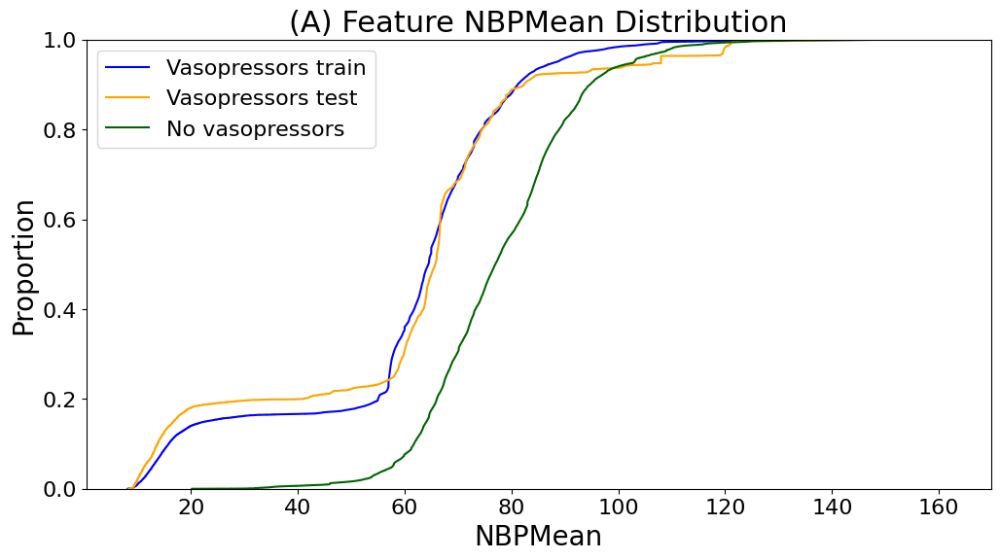

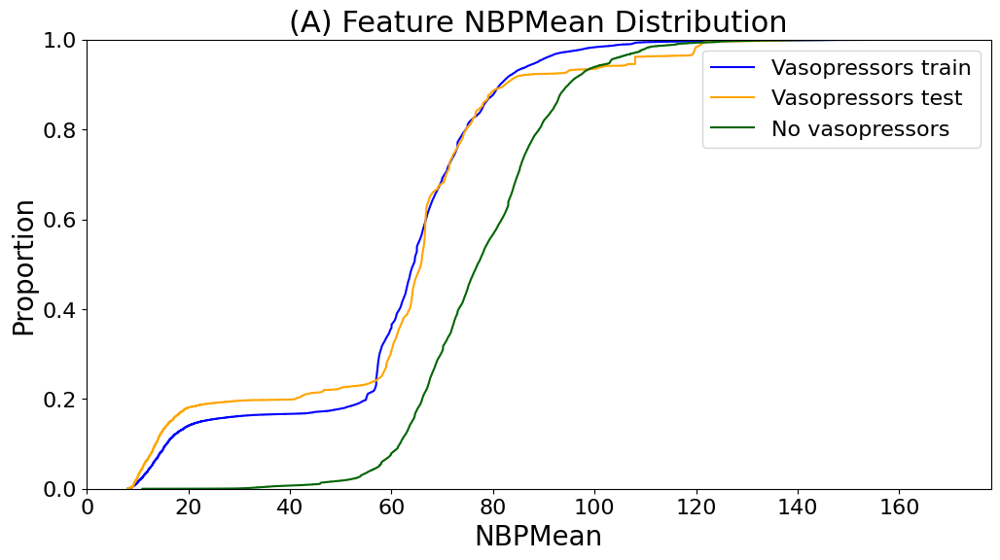

In [75]:
visual_comparison_source_train_source_test_target_test(no_vasopressors_train, no_vasopressors_test, vasopressors_train, vasopressors_test, "vasopressors", "no_vasopressors", plot_cumulative_distribution_compare_only_NBPMean)

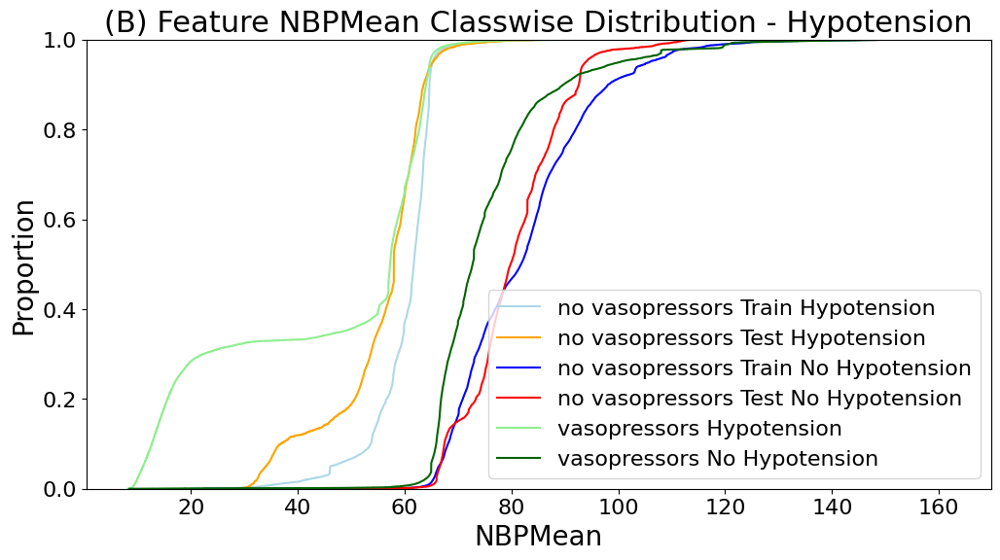

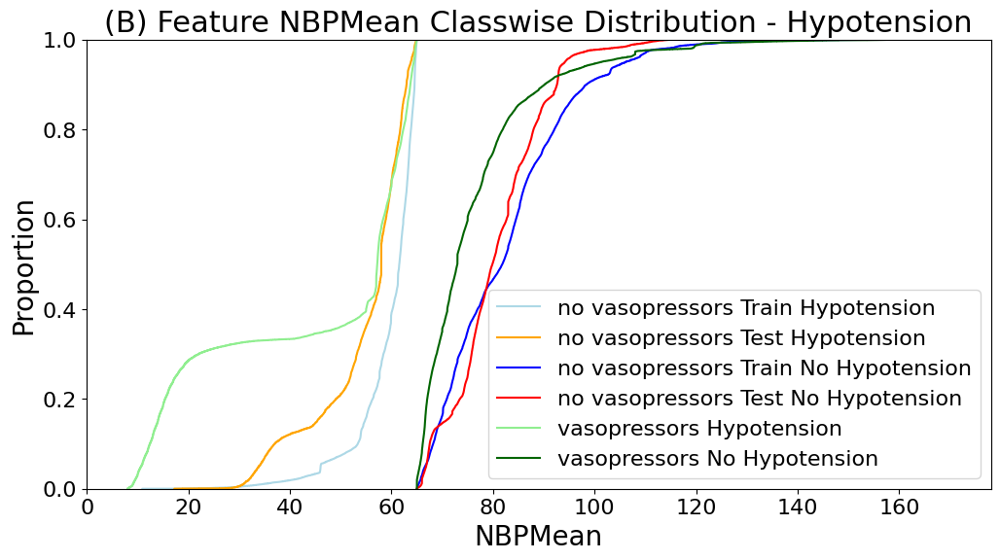

In [79]:
visual_comparison_source_train_source_test_target_test_class_wise("no_vasopressors", "vasopressors", "Hypotension", plot_cumulative_distribution_compare_classwise_only_nbp_mean)

# Compare distributions channels across timesteps

In [ ]:
# whitney u test
from scipy.stats import mannwhitneyu

In [ ]:
def comparison_distributions_across_time_source_train_source_test_target_all(label_source, label_target):

    # load data
    source_train = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_{label_source}_cleaned.pt', weights_only=False)
    source_test = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_{label_source}_cleaned.pt', weights_only=False)
    target_train = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_{label_target}_cleaned.pt', weights_only=False)
    target_test = torch.load(f'../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_{label_target}_cleaned.pt', weights_only=False)
    print("Data Loaded")

    # get samples only
    source_train_samples = np.array(source_train["samples"])
    source_test_samples = np.array(source_test["samples"])
    target_all_samples = np.array(target_train["samples"])
    target_all_samples_test = np.array(target_test["samples"])
    target_all_samples = np.concatenate([target_all_samples, target_all_samples_test], axis=0)
    print("Samples Extracted")


    results_u_test = []
    # mann withney u test for each channel at each time point
    for channel in range(6):
        print(f"Channel {channel}")
        for time_point_1 in range(12):
            for time_point_2 in range(12):
                if time_point_2 == time_point_1:
                    continue
                source_train_tp1 = source_train_samples[:, time_point_1, channel]
                source_train_tp2 = source_train_samples[:, time_point_2, channel]
                mannwhitneyu_statistic_train, p_value_train = mannwhitneyu(source_train_tp1, source_train_tp2, alternative='two-sided')
                entry = {
                    "dataset": "Source Train",
                    "channel": channel,
                    "time_point_1": time_point_1,
                    "time_point_2": time_point_2,
                    "mannwhitneyu_statistic": mannwhitneyu_statistic_train,
                    "p_value": p_value_train,
                    "evidence_for_difference": p_value_train < 0.05
                }
                results_u_test.append(entry)

                source_test_tp1 = source_test_samples[:, time_point_1, channel]
                source_test_tp2 = source_test_samples[:, time_point_2, channel]
                mannwhitneyu_statistic_test, p_value_test = mannwhitneyu(source_test_tp1, source_test_tp2, alternative='two-sided')
                entry = {
                    "dataset": "Source Test",
                    "channel": channel,
                    "time_point_1": time_point_1,
                    "time_point_2": time_point_2,
                    "mannwhitneyu_statistic": mannwhitneyu_statistic_test,
                    "p_value": p_value_test,
                    "evidence_for_difference": p_value_test < 0.05
                }
                results_u_test.append(entry)

                target_tp1 = target_all_samples[:, time_point_1, channel]
                target_tp2 = target_all_samples[:, time_point_2, channel]
                mannwhitneyu_statistic_target, p_value_target = mannwhitneyu(target_tp1, target_tp2, alternative='two-sided')
                entry = {
                    "dataset": "Target All",
                    "channel": channel,
                    "time_point_1": time_point_1,
                    "time_point_2": time_point_2,
                    "mannwhitneyu_statistic": mannwhitneyu_statistic_target,
                    "p_value": p_value_target,
                    "evidence_for_difference": p_value_target < 0.05
                }
                results_u_test.append(entry)

    results_u_test_df = pd.DataFrame(results_u_test)
    results_u_test_df.to_csv(f"./results/mannwhitneyu_test/mannwhitneyu_test_{label_source}_vs_{label_target}.csv", index=False)
    return results_u_test_df   


In [ ]:
results = comparison_distributions_across_time_source_train_source_test_target_all("cardiac_surgery", "no_cardiac_surgery")
# count how many entries have evidence for difference
print("Mann Whitney U Test Results - Cardiac Surgery vs No Cardiac Surgery")
print(results["evidence_for_difference"].sum())

results = comparison_distributions_across_time_source_train_source_test_target_all("no_cardiac_surgery", "cardiac_surgery")
# count how many entries have evidence for difference
print("Mann Whitney U Test Results - No Cardiac Surgery vs Cardiac Surgery")
print(results["evidence_for_difference"].sum())

Data Loaded
Samples Extracted
Channel 0
Channel 1
Channel 2
Channel 3
Channel 4
Channel 5
Mann Whitney U Test Results - Cardiac Surgery vs No Cardiac Surgery
8
Data Loaded
Samples Extracted
Channel 0
Channel 1
Channel 2
Channel 3
Channel 4
Channel 5
Mann Whitney U Test Results - No Cardiac Surgery vs Cardiac Surgery
22


In [ ]:
results = comparison_distributions_across_time_source_train_source_test_target_all("respiratory_surgery", "no_respiratory_surgery")
# count how many entries have evidence for difference
print("Mann Whitney U Test Results - Respiratory Surgery vs No Respiratory Surgery")
print(results["evidence_for_difference"].sum())

results = comparison_distributions_across_time_source_train_source_test_target_all("no_respiratory_surgery", "respiratory_surgery")
# count how many entries have evidence for difference
print("Mann Whitney U Test Results - No Respiratory Surgery vs Respiratory Surgery")
print(results["evidence_for_difference"].sum())

Data Loaded
Samples Extracted
Channel 0
Channel 1
Channel 2
Channel 3
Channel 4
Channel 5
Mann Whitney U Test Results - Respiratory Surgery vs No Respiratory Surgery
72
Data Loaded
Samples Extracted
Channel 0
Channel 1
Channel 2
Channel 3
Channel 4
Channel 5
Mann Whitney U Test Results - No Respiratory Surgery vs Respiratory Surgery
58


In [ ]:
results = comparison_distributions_across_time_source_train_source_test_target_all("vasopressors", "no_vasopressors")
# count how many entries have evidence for difference
print("Mann Whitney U Test Results - Vasopressors vs No Vasopressors")
print(results["evidence_for_difference"].sum())

results = comparison_distributions_across_time_source_train_source_test_target_all("no_vasopressors", "vasopressors")
# count how many entries have evidence for difference
print("Mann Whitney U Test Results - No Vasopressors vs Vasopressors")
print(results["evidence_for_difference"].sum())

Data Loaded
Samples Extracted
Channel 0
Channel 1
Channel 2
Channel 3
Channel 4
Channel 5
Mann Whitney U Test Results - Vasopressors vs No Vasopressors
0
Data Loaded
Samples Extracted
Channel 0
Channel 1
Channel 2
Channel 3
Channel 4
Channel 5
Mann Whitney U Test Results - No Vasopressors vs Vasopressors
0


In [ ]:
results = comparison_distributions_across_time_source_train_source_test_target_all("ventilation", "no_ventilation")
# count how many entries have evidence for difference
print("Mann Whitney U Test Results - Ventilation vs No Ventilation")
print(results["evidence_for_difference"].sum())

results = comparison_distributions_across_time_source_train_source_test_target_all("no_ventilation", "ventilation")
# count how many entries have evidence for difference
print("Mann Whitney U Test Results - No Ventilation vs Ventilation")
print(results["evidence_for_difference"].sum())

Data Loaded
Samples Extracted
Channel 0
Channel 1
Channel 2
Channel 3
Channel 4
Channel 5
Mann Whitney U Test Results - Ventilation vs No Ventilation
0
Data Loaded
Samples Extracted
Channel 0
Channel 1
Channel 2
Channel 3
Channel 4
Channel 5
Mann Whitney U Test Results - No Ventilation vs Ventilation
0


# Cardiac Surgery vs No Cardiac Surgery

In [ ]:
cardiac_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_cardiac_surgery_cleaned.pt', weights_only=False)
cardiac_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_cardiac_surgery_cleaned.pt', weights_only=False)

# huh they look exactly the same
no_cardiac_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_no_cardiac_surgery_cleaned.pt', weights_only=False)
no_cardiac_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_no_cardiac_surgery_cleaned.pt', weights_only=False)


Source Train + Source Test + Target Test


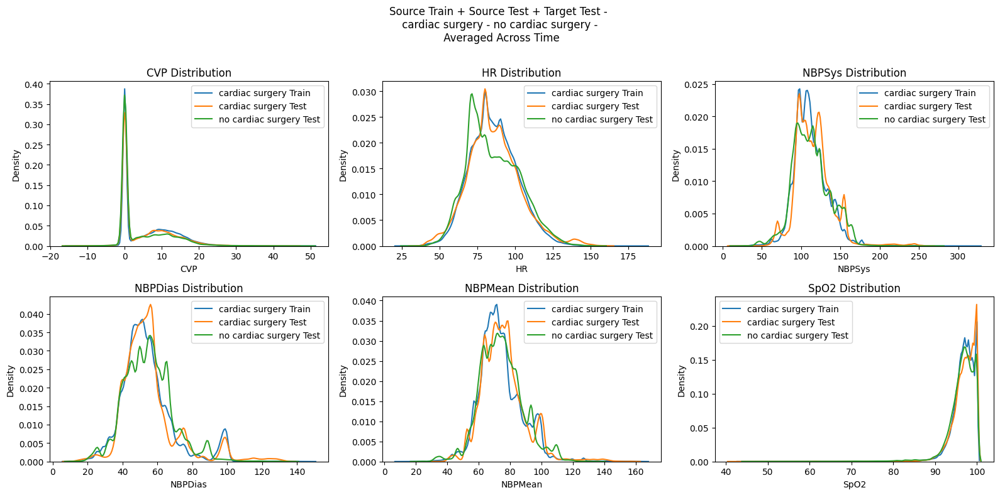

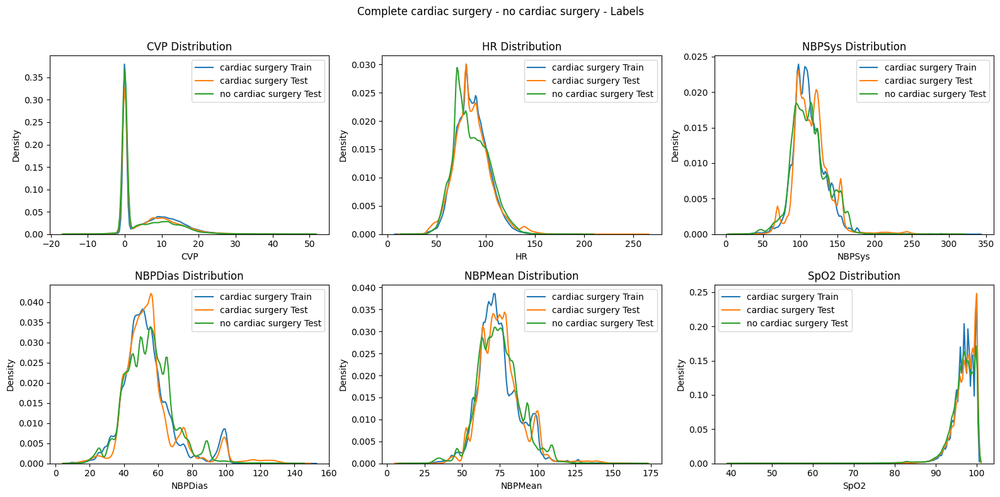

In [ ]:
visual_comparison_source_train_source_test_target_test(cardiac_train, cardiac_test, no_cardiac_train, no_cardiac_test, "cardiac_surgery", "no_cardiac_surgery", plot_distribution_compare)

Classwise - Source Train + Source Test + Target Test


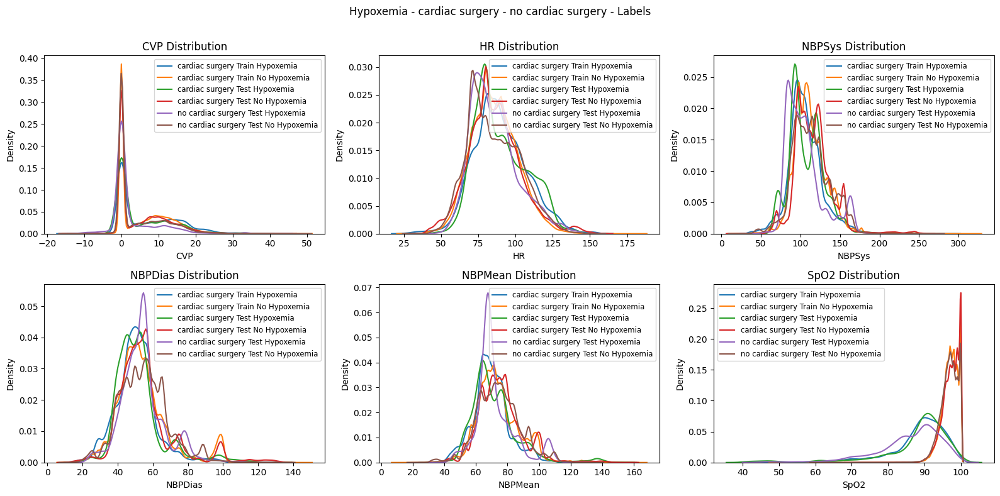

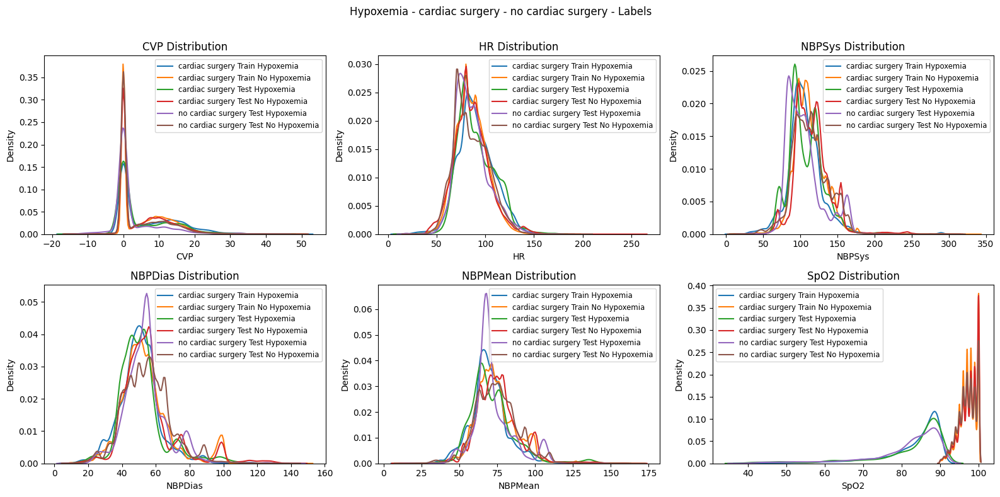

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("cardiac_surgery", "no_cardiac_surgery", "Hypoxemia", plot_distribution_compare_class_wise)

Classwise - Source Train + Source Test + Target Test


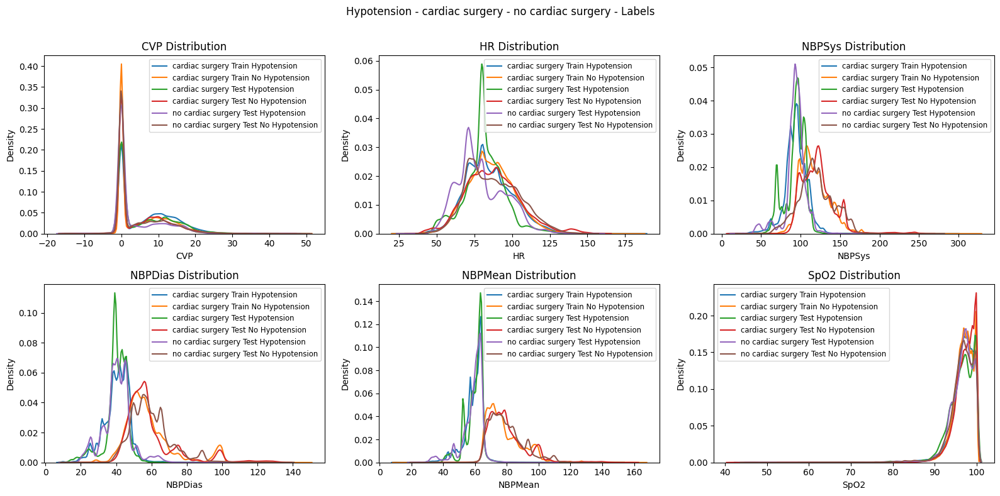

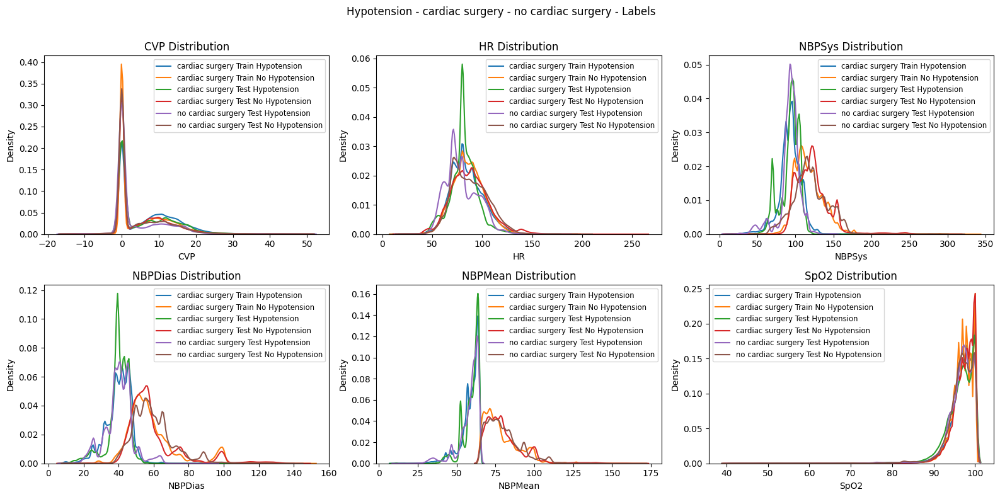

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("cardiac_surgery", "no_cardiac_surgery", "Hypotension", plot_distribution_compare_class_wise)

Source Train + Source Test + Target Test


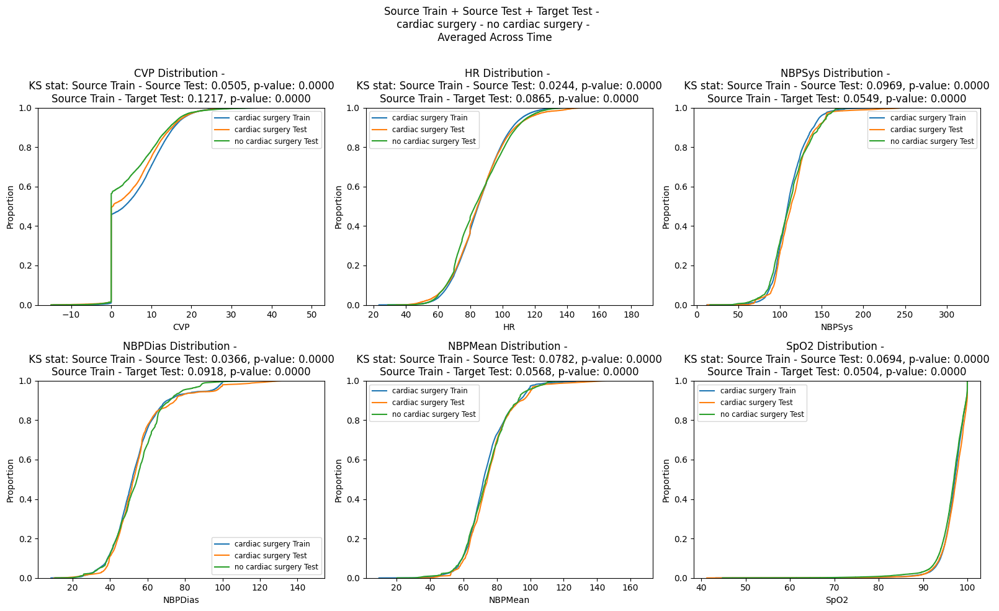

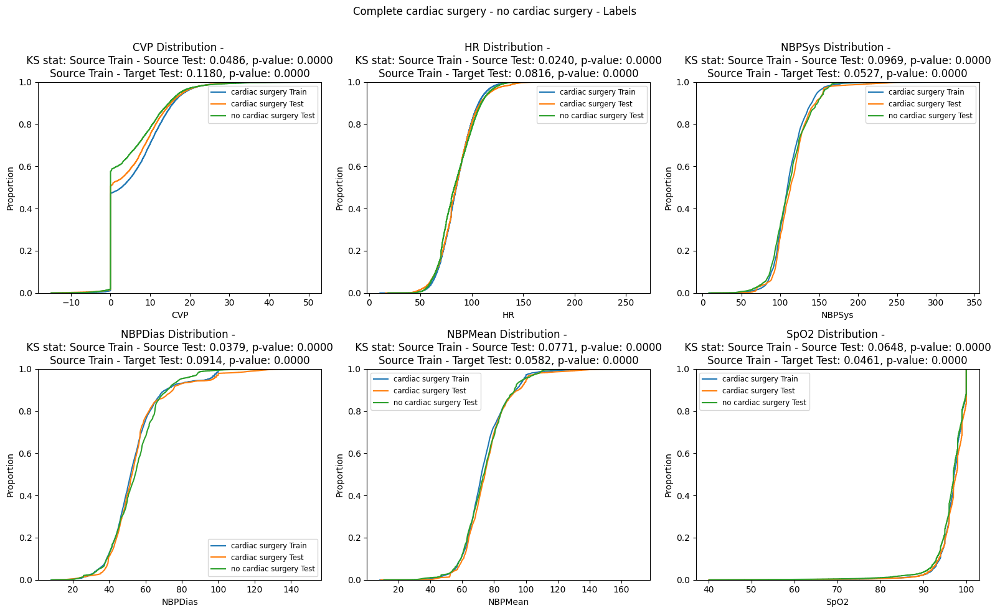

In [ ]:
visual_comparison_source_train_source_test_target_test(cardiac_train, cardiac_test, no_cardiac_train, no_cardiac_test, "cardiac_surgery", "no_cardiac_surgery", plot_cumulative_distribution_compare)

Classwise - Source Train + Source Test + Target Test


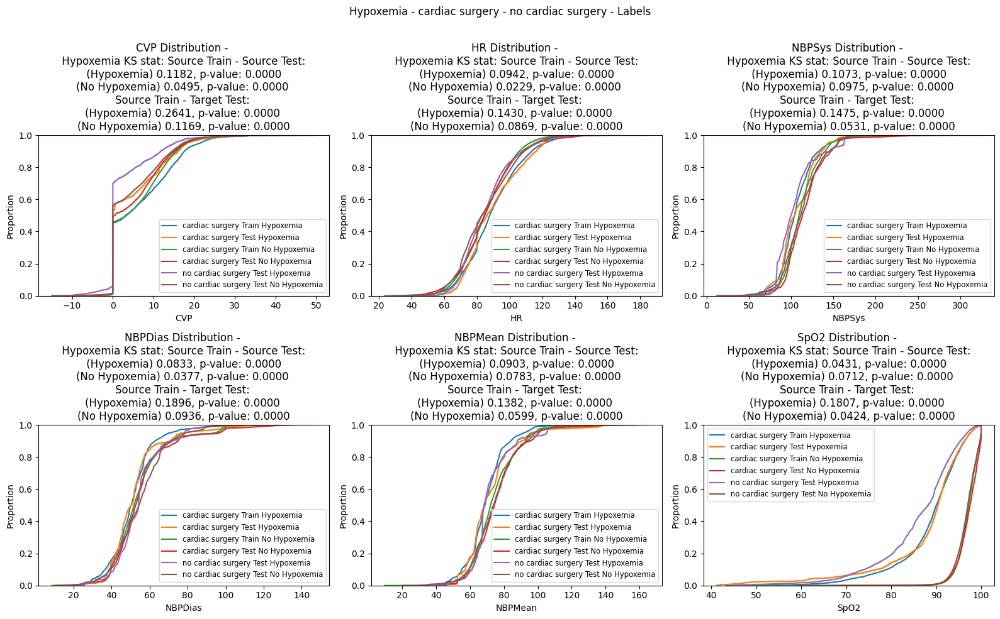

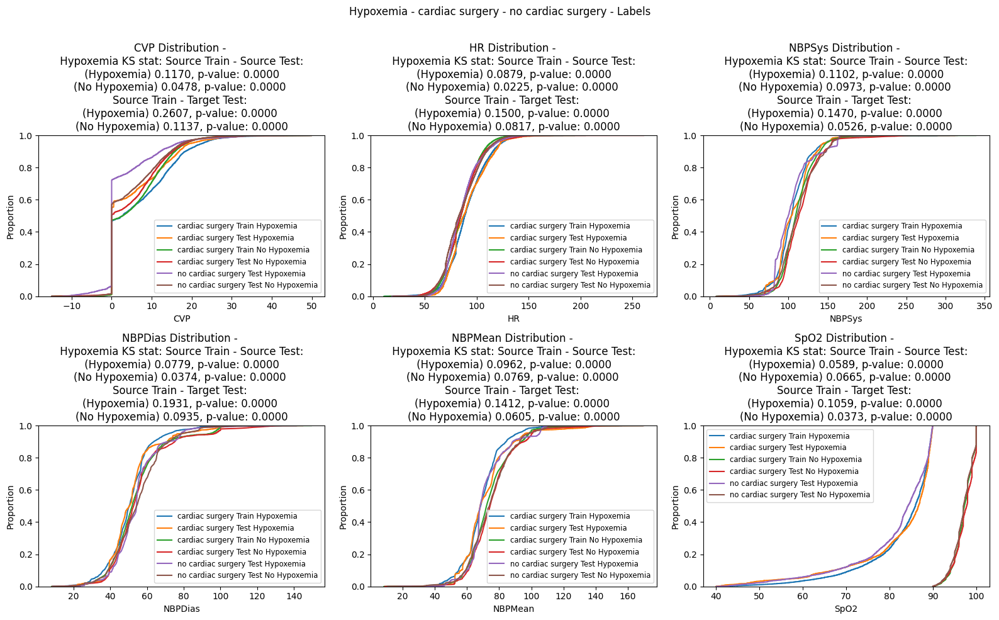

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("cardiac_surgery", "no_cardiac_surgery", "Hypoxemia", plot_cumulative_distribution_compare_classwise)

Classwise - Source Train + Source Test + Target Test


C:\Users\Mayra Elwes\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


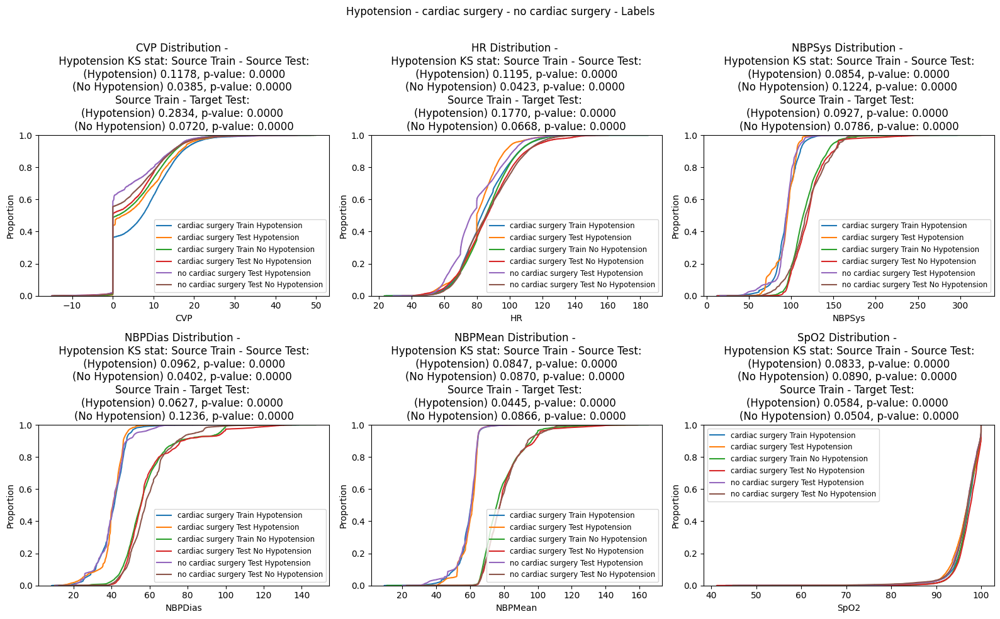

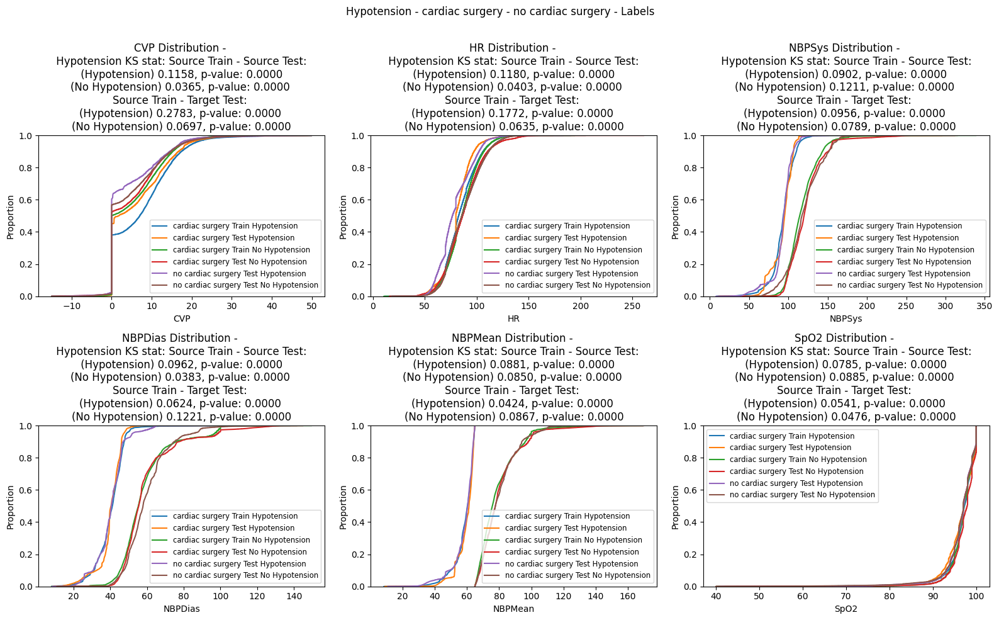

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("cardiac_surgery", "no_cardiac_surgery", "Hypotension", plot_cumulative_distribution_compare_classwise)

## No Cardiac Surgery vs Cardiac Surgery

Source Train + Source Test + Target Test


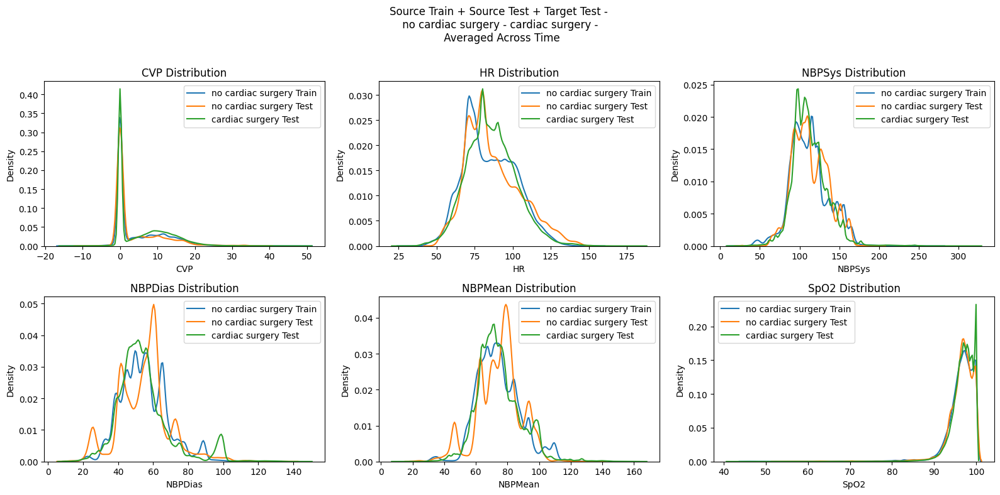

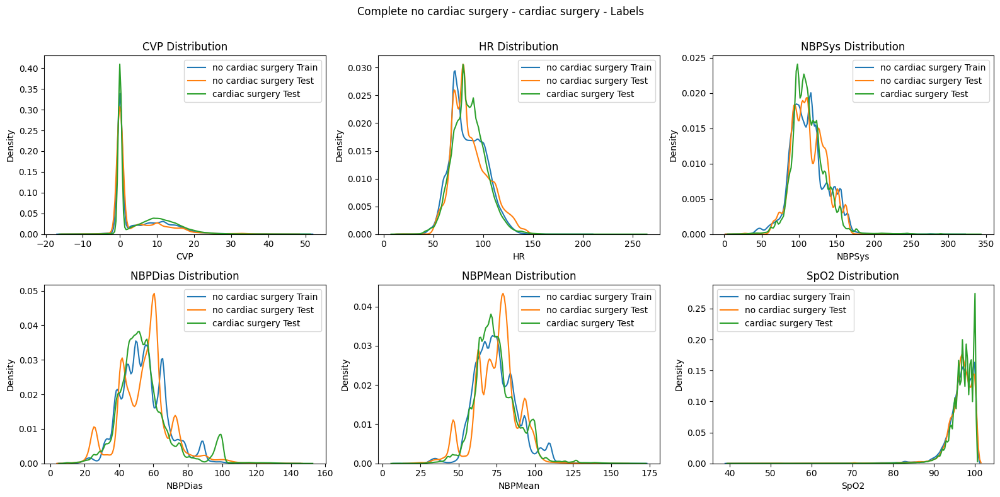

Hypoxemia - No Cardiac Surgery - Cardiac Surgery
Classwise - Source Train + Source Test + Target Test


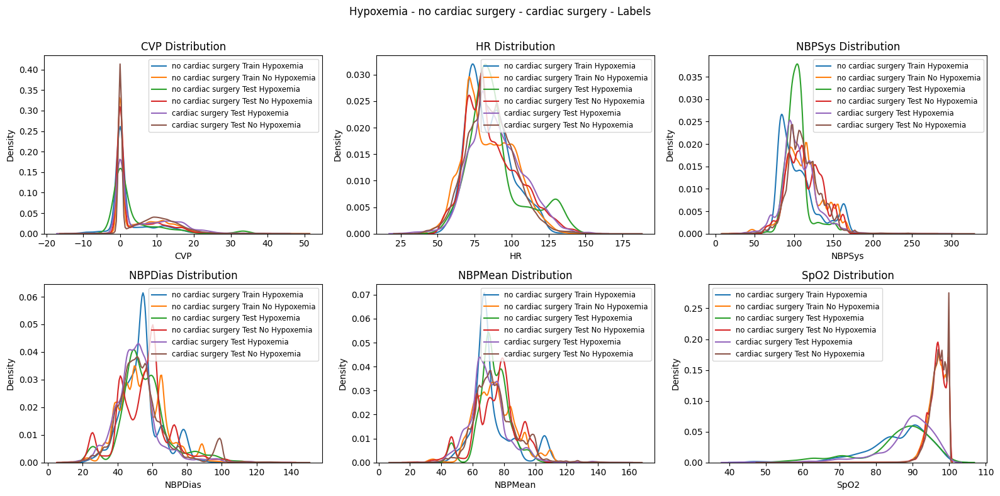

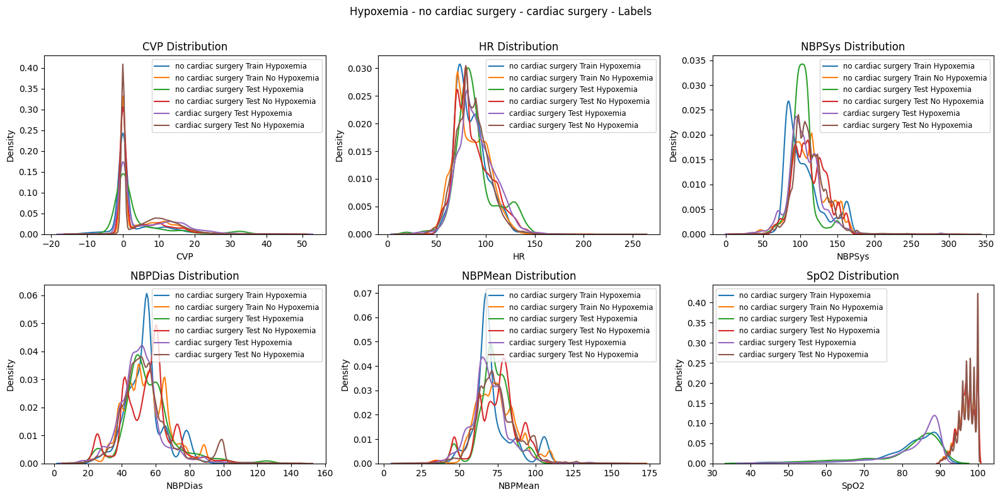

Hypotension - No Cardiac Surgery - Cardiac Surgery
Classwise - Source Train + Source Test + Target Test


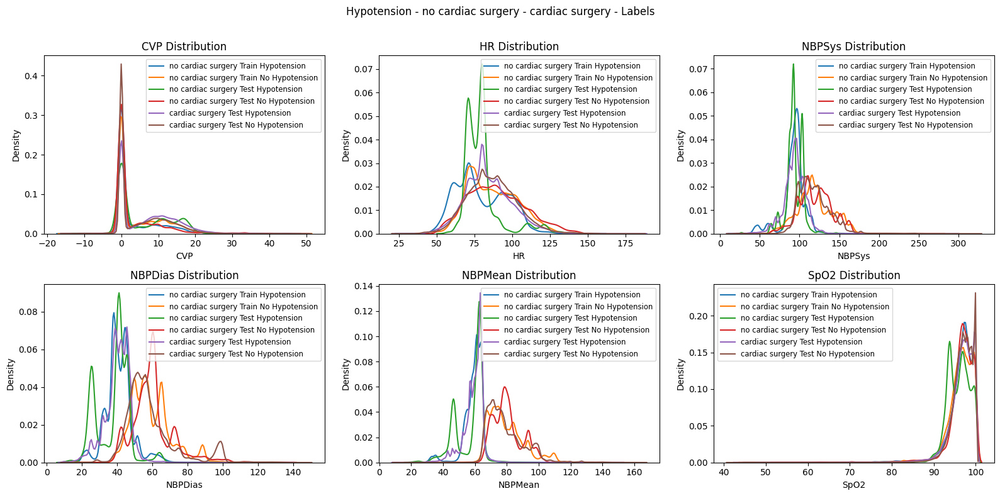

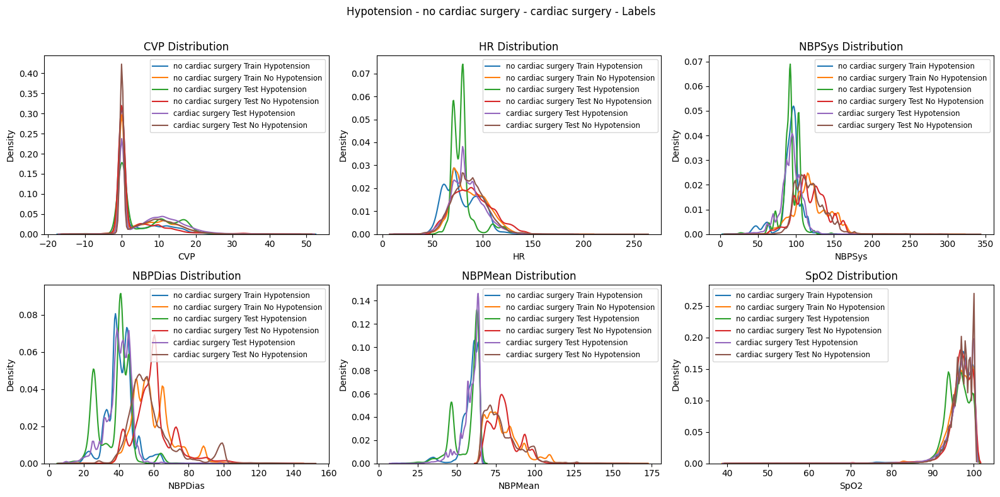

Cumulative - No Cardiac Surgery - Cardiac Surgery
Source Train + Source Test + Target Test


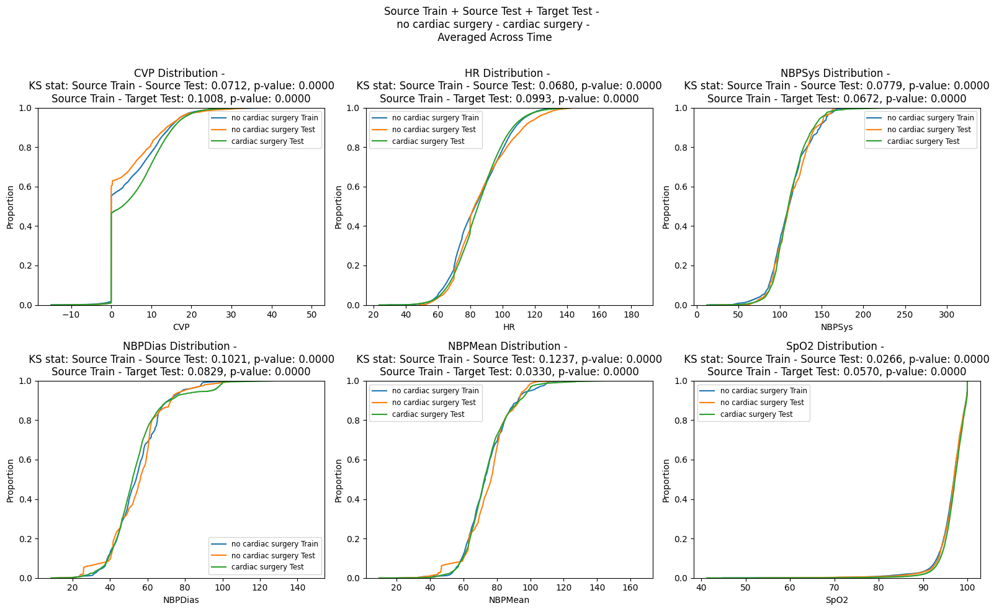

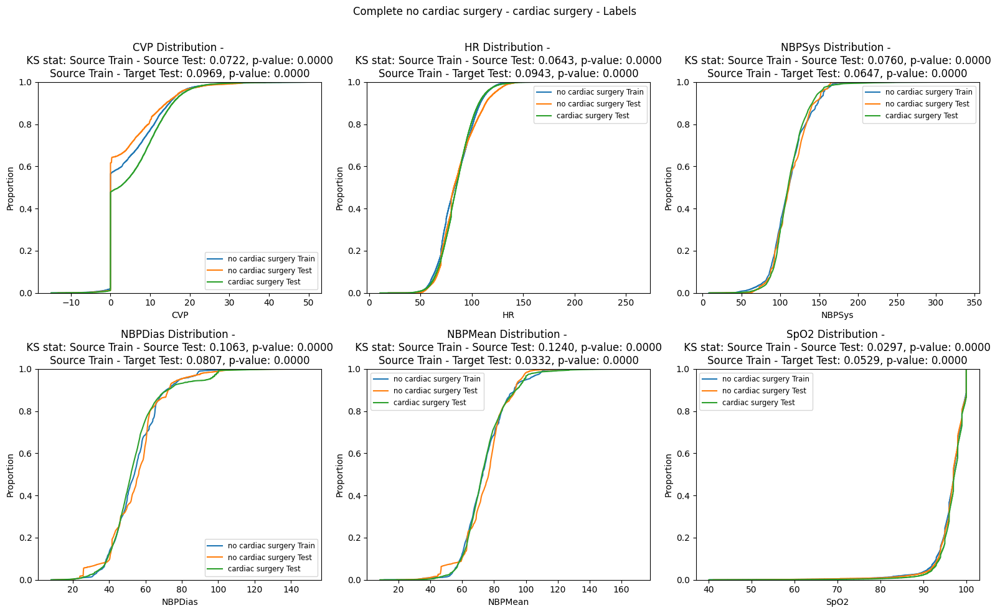

Cumulative - Hypoxemia - No Cardiac Surgery - Cardiac Surgery
Classwise - Source Train + Source Test + Target Test


C:\Users\Mayra Elwes\AppData\Local\Temp\ipykernel_19172\3385178460.py:43: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0, 1, 0.97])
C:\Users\Mayra Elwes\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


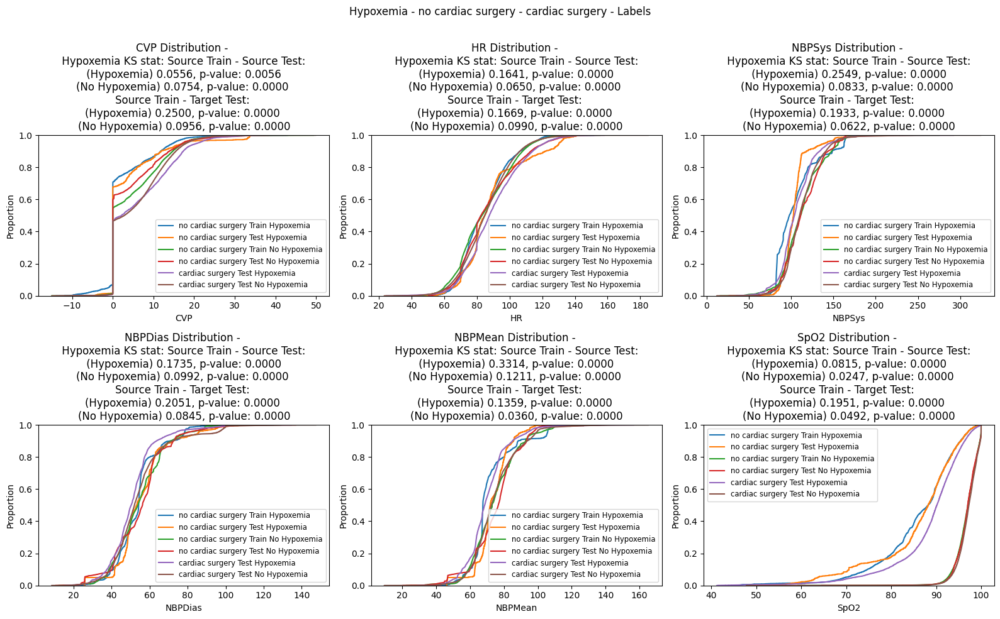

C:\Users\Mayra Elwes\AppData\Local\Temp\ipykernel_19172\3385178460.py:43: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0, 1, 0.97])
C:\Users\Mayra Elwes\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


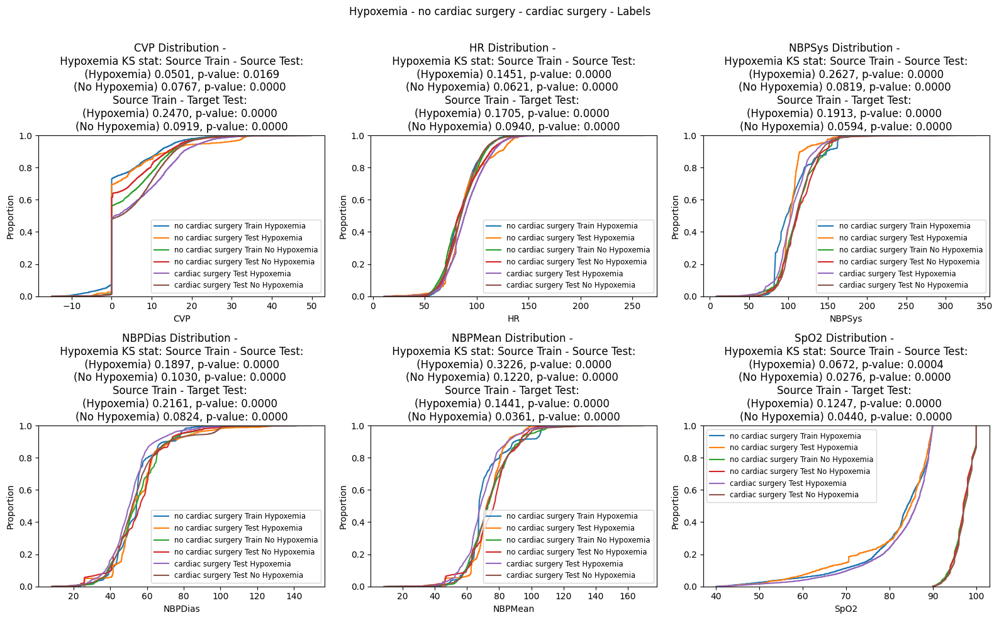

Cumulative - Hypotension - No Cardiac Surgery - Cardiac Surgery
Classwise - Source Train + Source Test + Target Test


C:\Users\Mayra Elwes\AppData\Local\Temp\ipykernel_19172\3385178460.py:43: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0, 1, 0.97])
C:\Users\Mayra Elwes\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


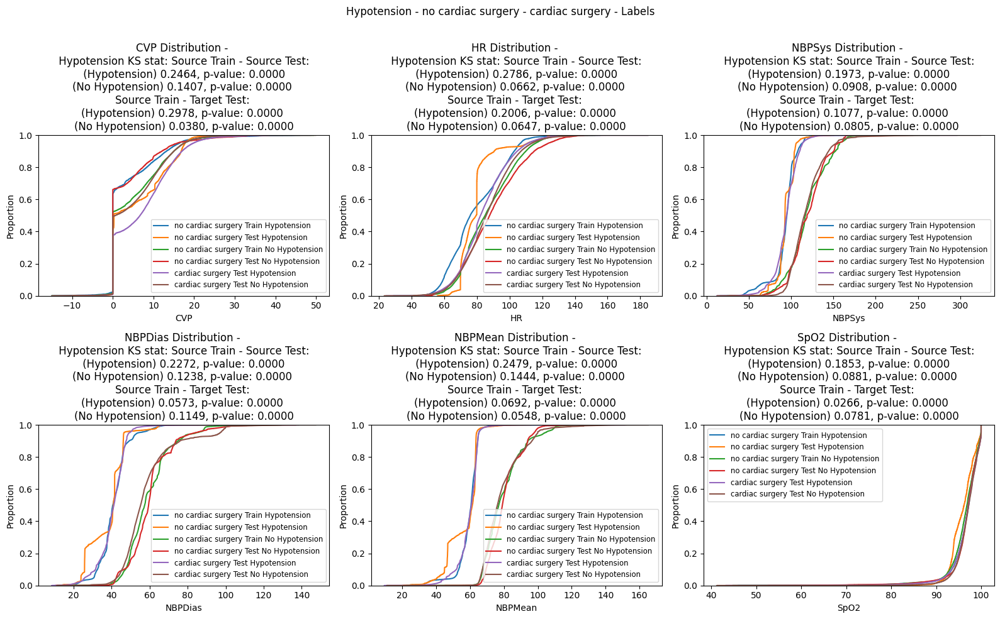

C:\Users\Mayra Elwes\AppData\Local\Temp\ipykernel_19172\3385178460.py:43: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0, 1, 0.97])
C:\Users\Mayra Elwes\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


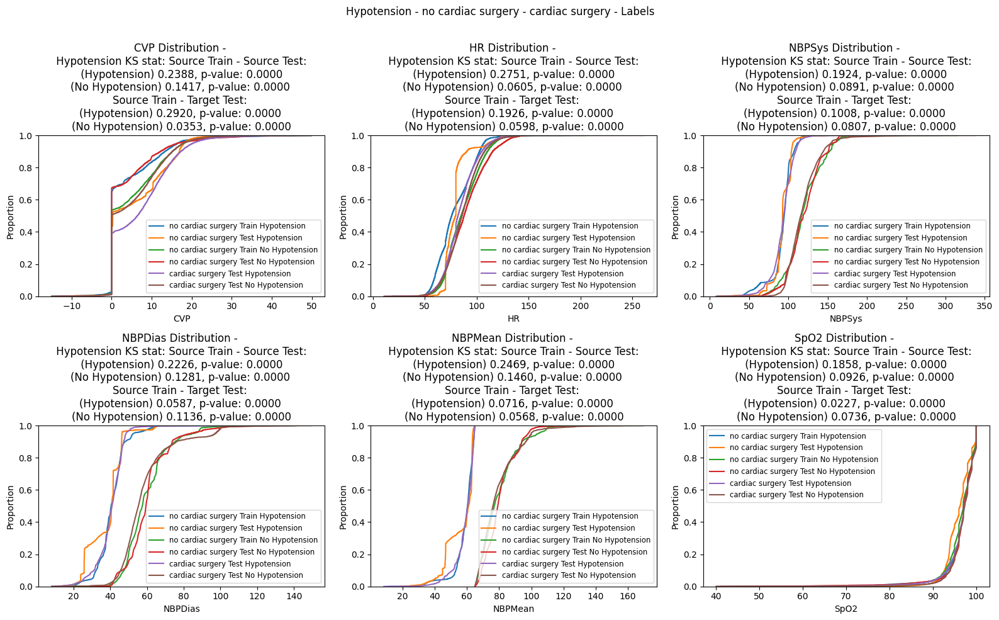

In [ ]:
visual_comparison_source_train_source_test_target_test(no_cardiac_train, no_cardiac_test,cardiac_train, cardiac_test,  "no_cardiac_surgery", "cardiac_surgery", plot_distribution_compare)
print("Hypoxemia - No Cardiac Surgery - Cardiac Surgery")
visual_comparison_source_train_source_test_target_test_class_wise("no_cardiac_surgery", "cardiac_surgery", "Hypoxemia", plot_distribution_compare_class_wise)
print("Hypotension - No Cardiac Surgery - Cardiac Surgery")
visual_comparison_source_train_source_test_target_test_class_wise( "no_cardiac_surgery", "cardiac_surgery","Hypotension", plot_distribution_compare_class_wise)
print("Cumulative - No Cardiac Surgery - Cardiac Surgery")
visual_comparison_source_train_source_test_target_test(no_cardiac_train, no_cardiac_test, cardiac_train, cardiac_test, "no_cardiac_surgery", "cardiac_surgery", plot_cumulative_distribution_compare)
print("Cumulative - Hypoxemia - No Cardiac Surgery - Cardiac Surgery")
visual_comparison_source_train_source_test_target_test_class_wise("no_cardiac_surgery","cardiac_surgery",  "Hypoxemia", plot_cumulative_distribution_compare_classwise)
print("Cumulative - Hypotension - No Cardiac Surgery - Cardiac Surgery")
visual_comparison_source_train_source_test_target_test_class_wise("no_cardiac_surgery", "cardiac_surgery", "Hypotension", plot_cumulative_distribution_compare_classwise)

## Respiratory Surgery vs No Respiratory Surgery

In [ ]:
respiratory_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_respiratory_surgery_cleaned.pt', weights_only=False)
respiratory_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_respiratory_surgery_cleaned.pt', weights_only=False)

no_respiratory_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_no_respiratory_surgery_cleaned.pt', weights_only=False)
no_respiratory_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_no_respiratory_surgery_cleaned.pt', weights_only=False)


Source Train + Source Test + Target Test


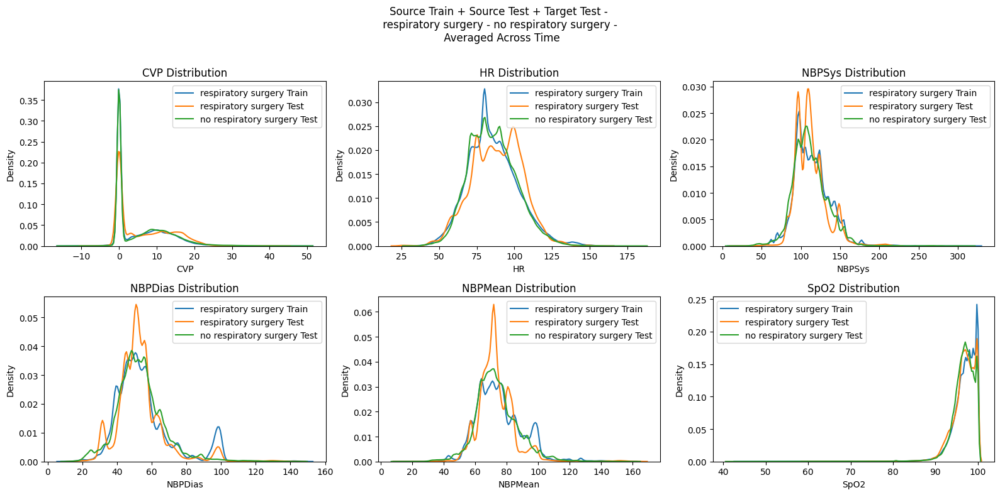

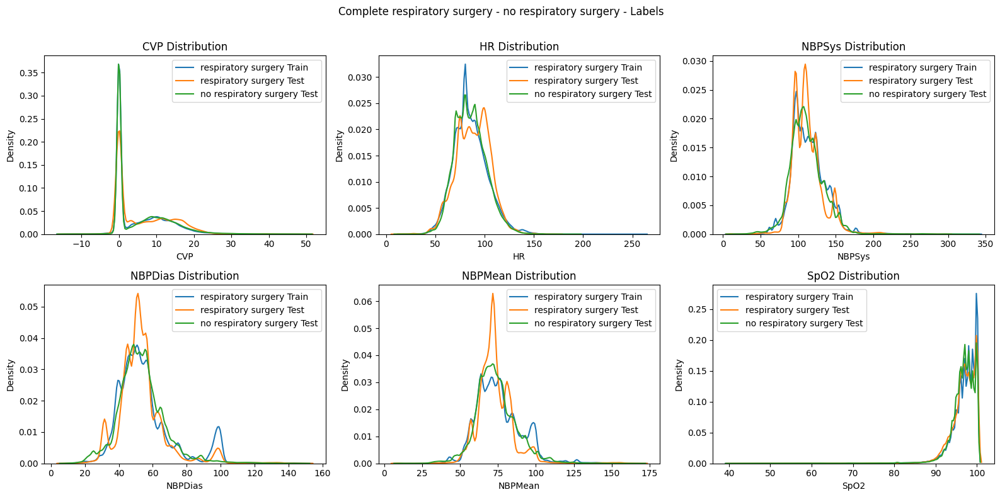

In [ ]:
visual_comparison_source_train_source_test_target_test(respiratory_train, respiratory_test, no_respiratory_train, no_respiratory_test, "respiratory_surgery", "no_respiratory_surgery", plot_distribution_compare)

Classwise - Source Train + Source Test + Target Test


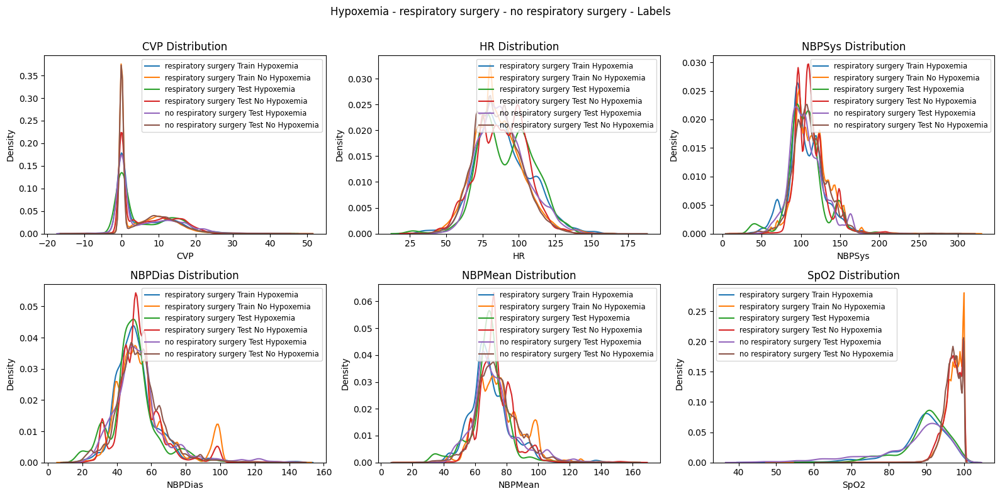

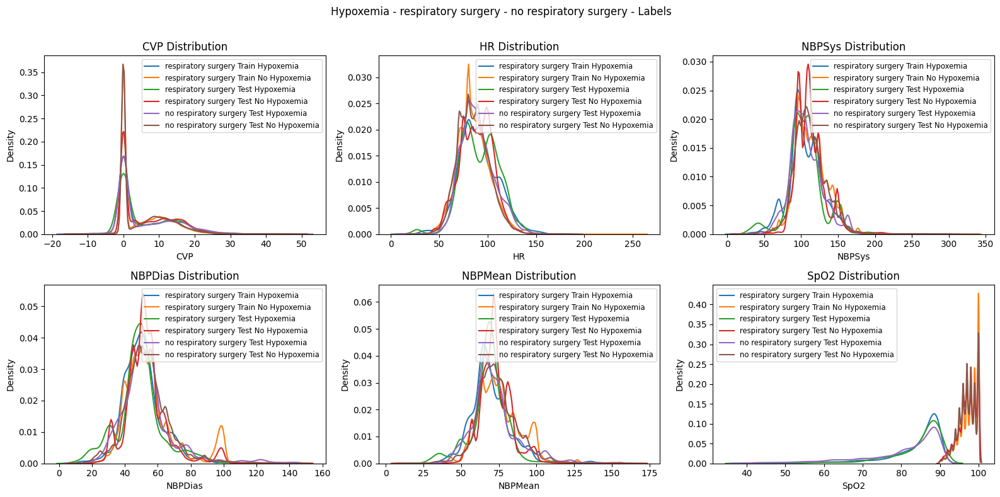

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("respiratory_surgery", "no_respiratory_surgery", "Hypoxemia", plot_distribution_compare_class_wise)

Classwise - Source Train + Source Test + Target Test


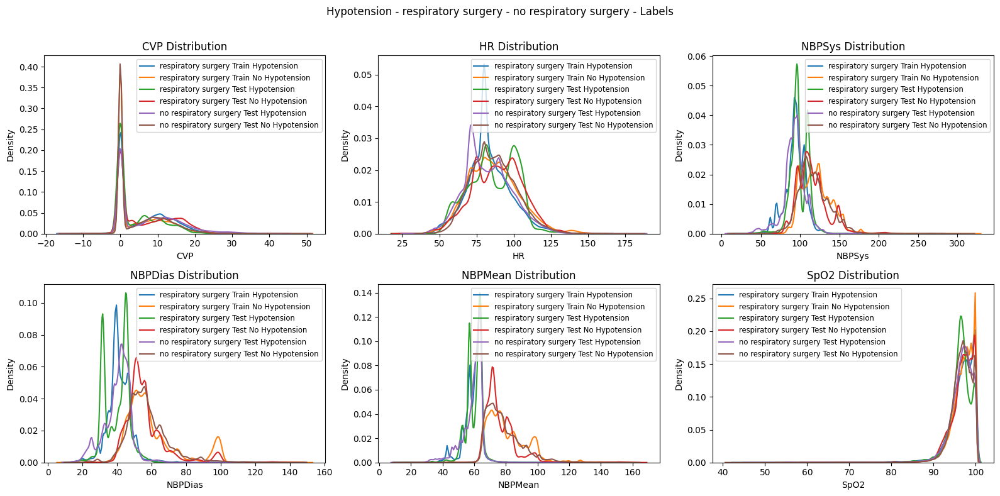

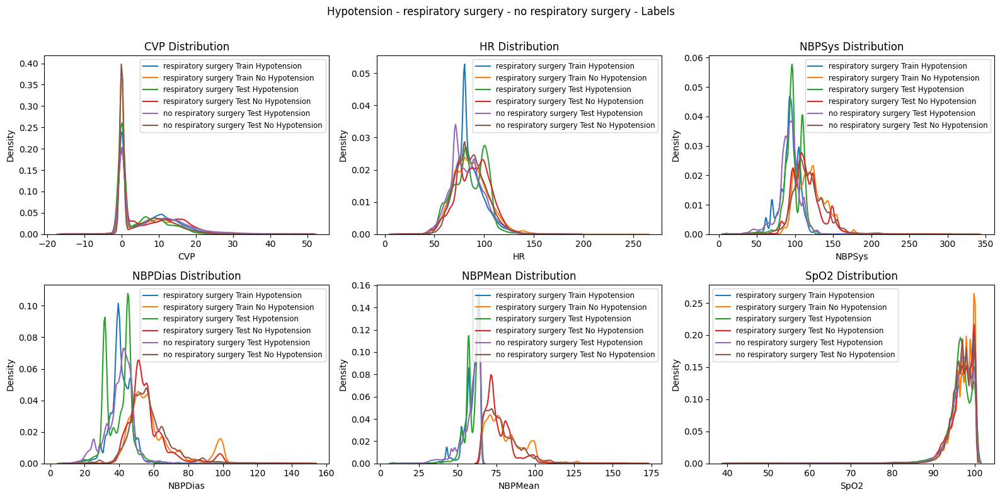

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("respiratory_surgery", "no_respiratory_surgery", "Hypotension", plot_distribution_compare_class_wise)

Source Train + Source Test + Target Test


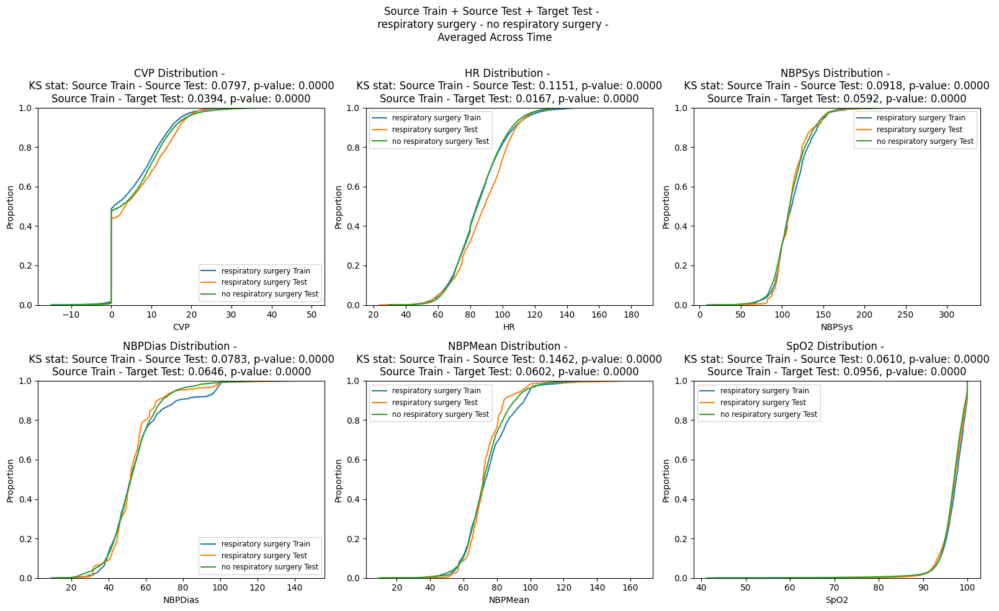

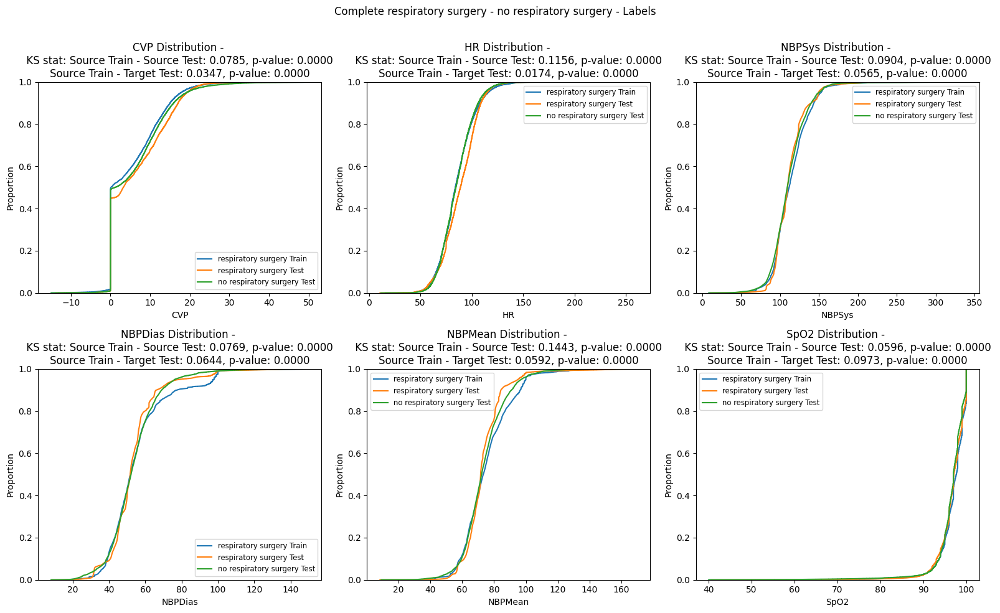

In [ ]:
visual_comparison_source_train_source_test_target_test(respiratory_train, respiratory_test, no_respiratory_train, no_respiratory_test, "respiratory_surgery", "no_respiratory_surgery", plot_cumulative_distribution_compare)

Classwise - Source Train + Source Test + Target Test


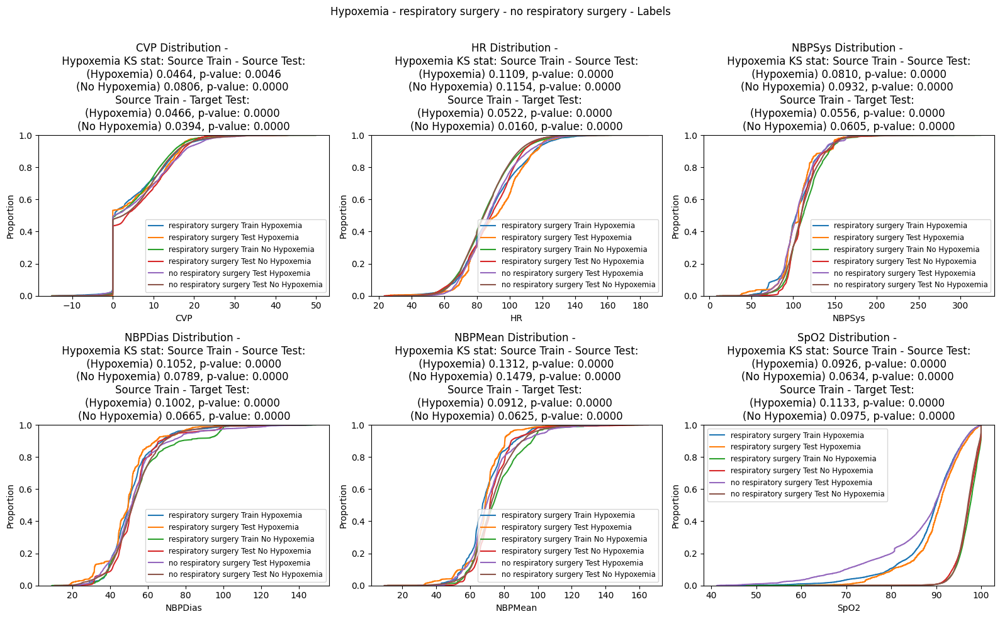

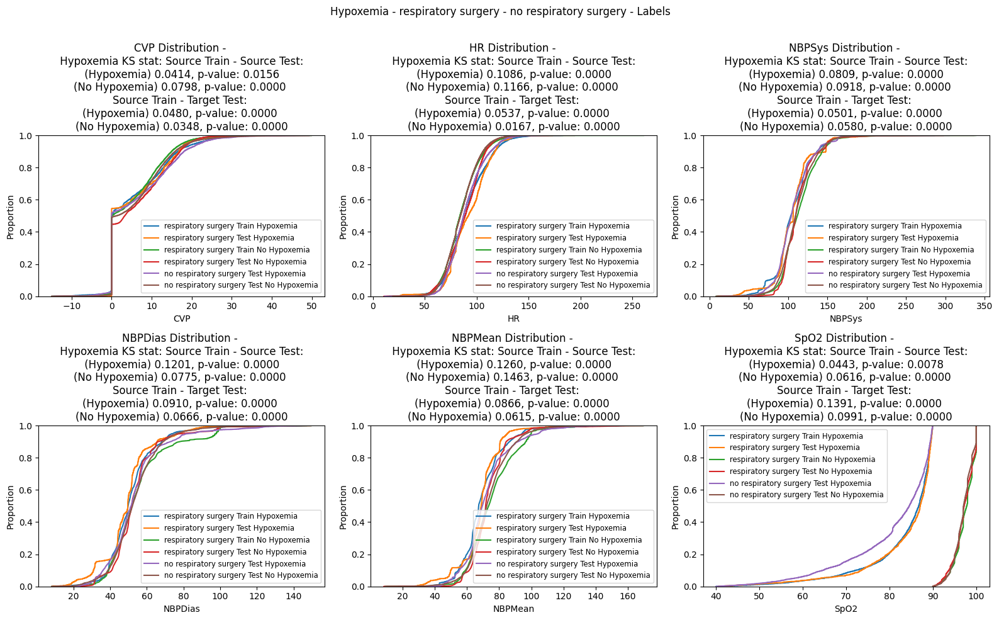

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("respiratory_surgery", "no_respiratory_surgery", "Hypoxemia", plot_cumulative_distribution_compare_classwise)

Classwise - Source Train + Source Test + Target Test


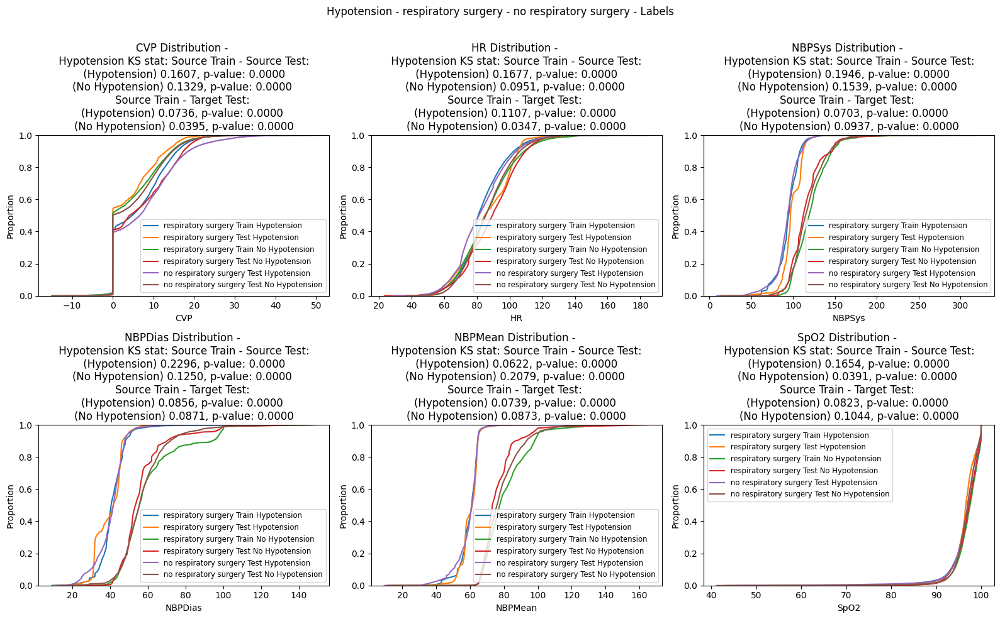

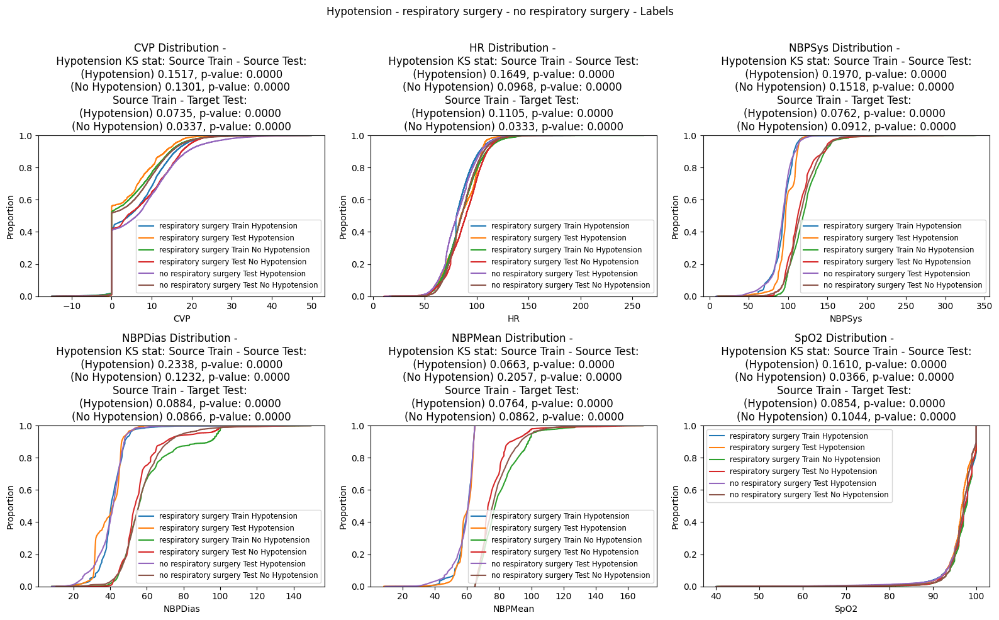

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("respiratory_surgery", "no_respiratory_surgery", "Hypotension", plot_cumulative_distribution_compare_classwise)

## No Respiratory Surgery vs Respiratory Surgery

Source Train + Source Test + Target Test


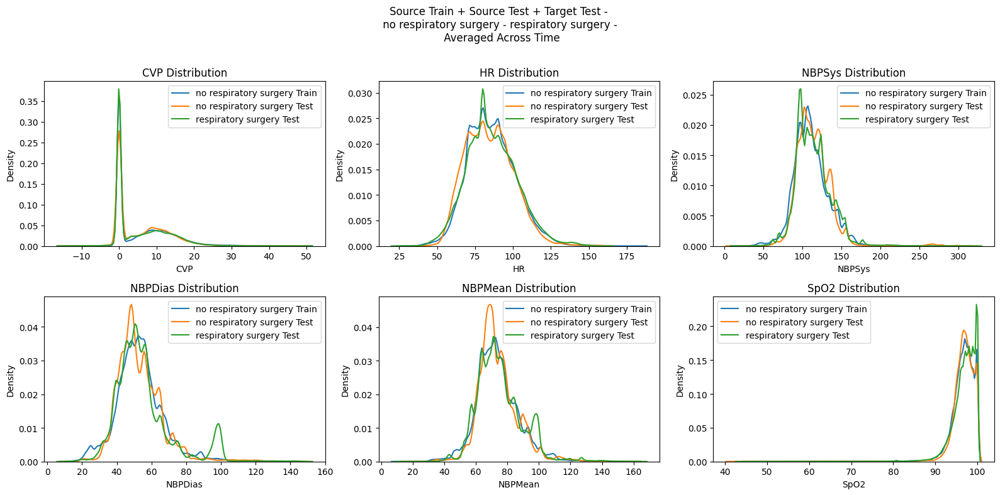

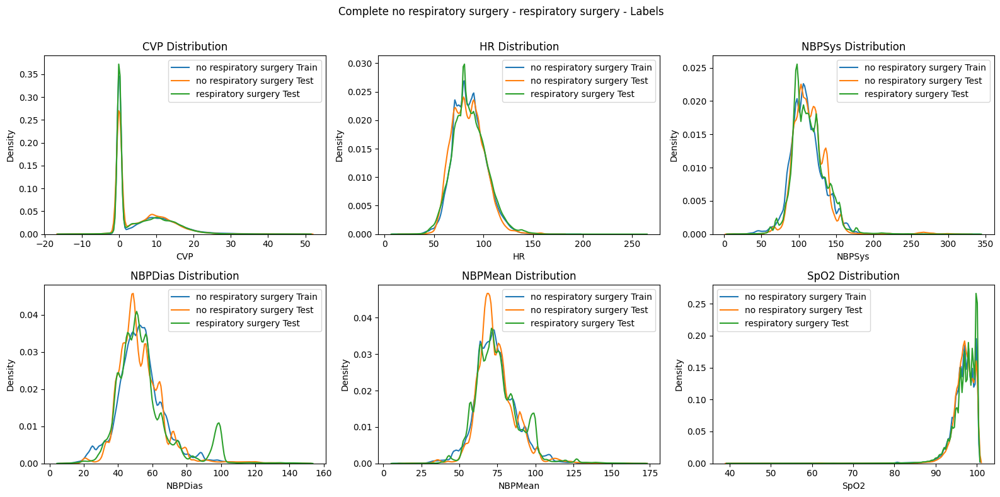

Hypoxemia - No Respiratory Surgery - Respiratory Surgery
Classwise - Source Train + Source Test + Target Test


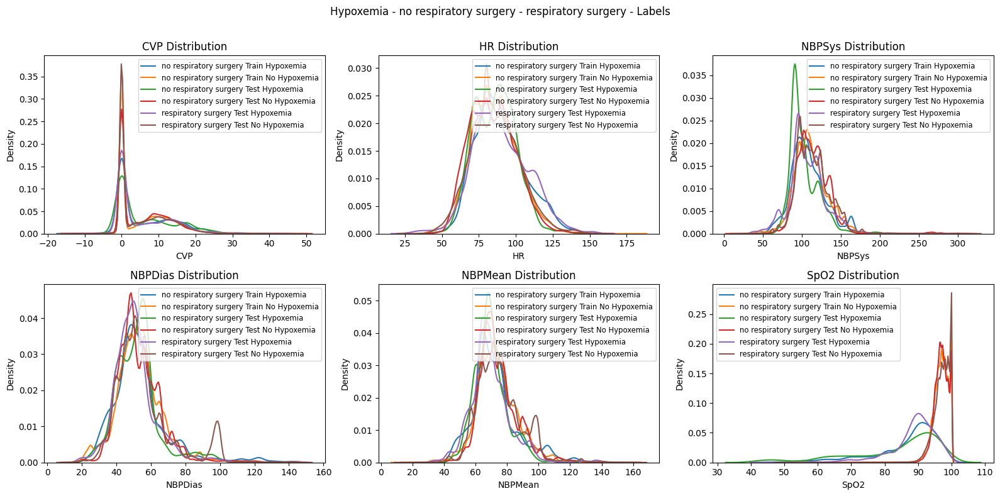

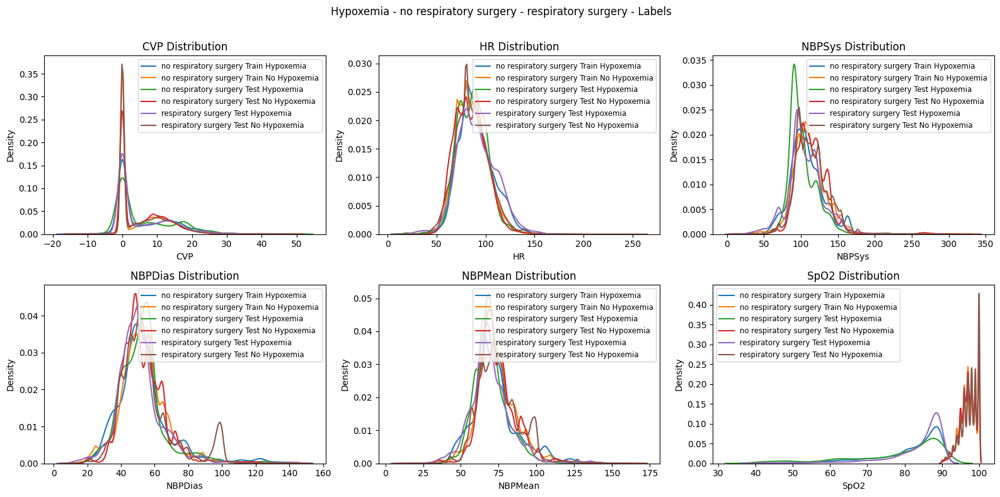

Hypotension - No Respiratory Surgery - Respiratory Surgery
Classwise - Source Train + Source Test + Target Test


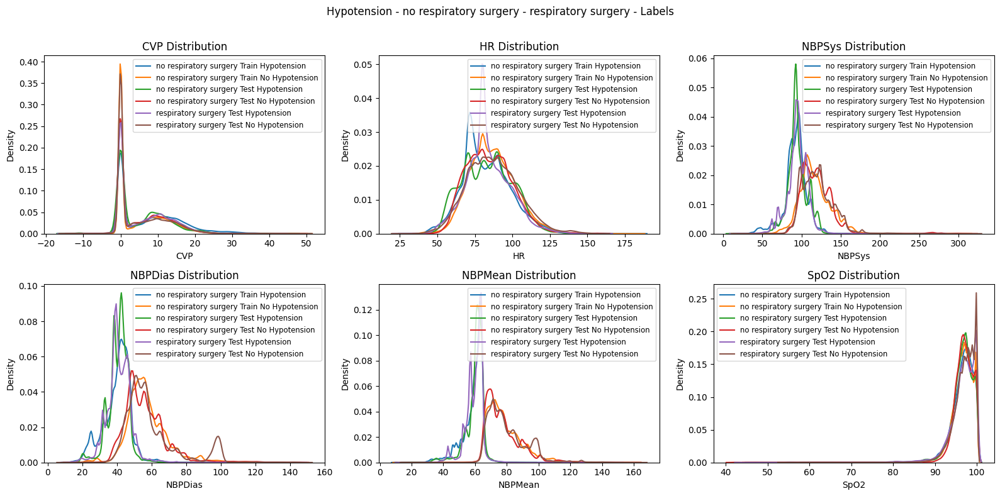

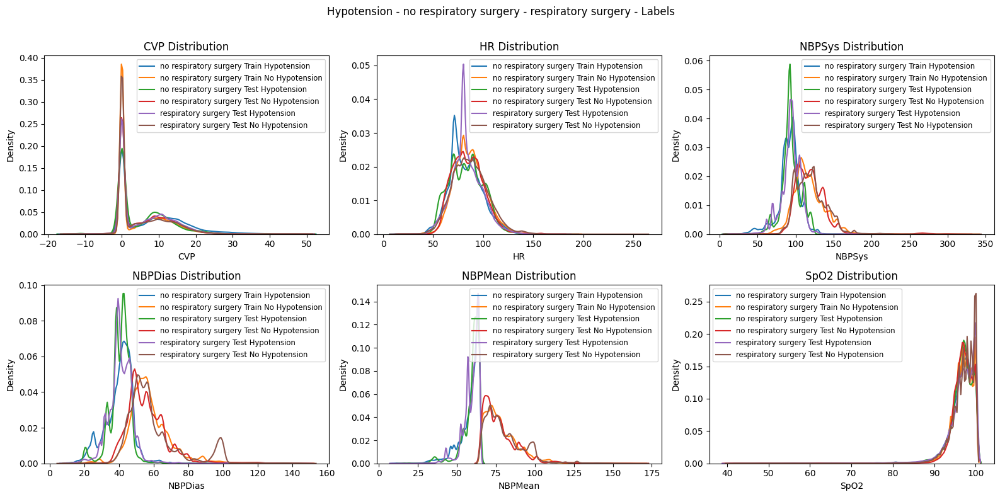

Cumulative - No Respiratory Surgery - Respiratory Surgery
Source Train + Source Test + Target Test


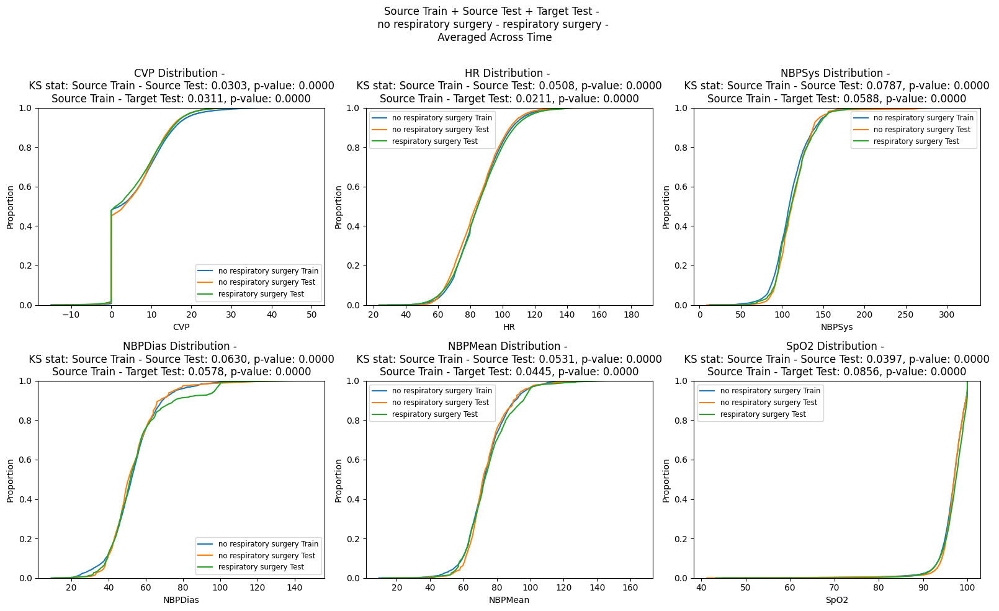

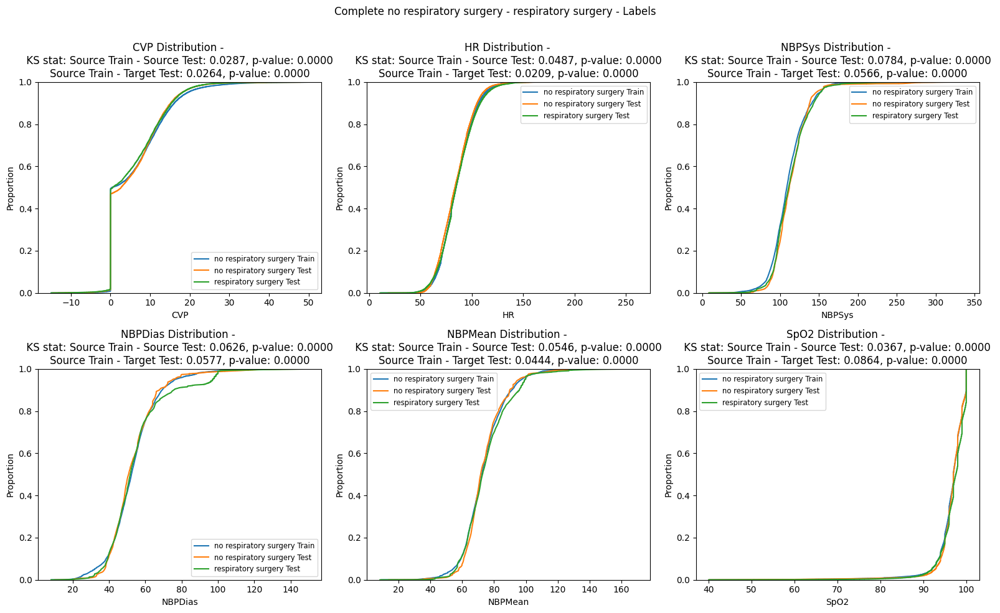

Cumulative - Hypoxemia - No Respiratory Surgery - Respiratory Surgery
Classwise - Source Train + Source Test + Target Test


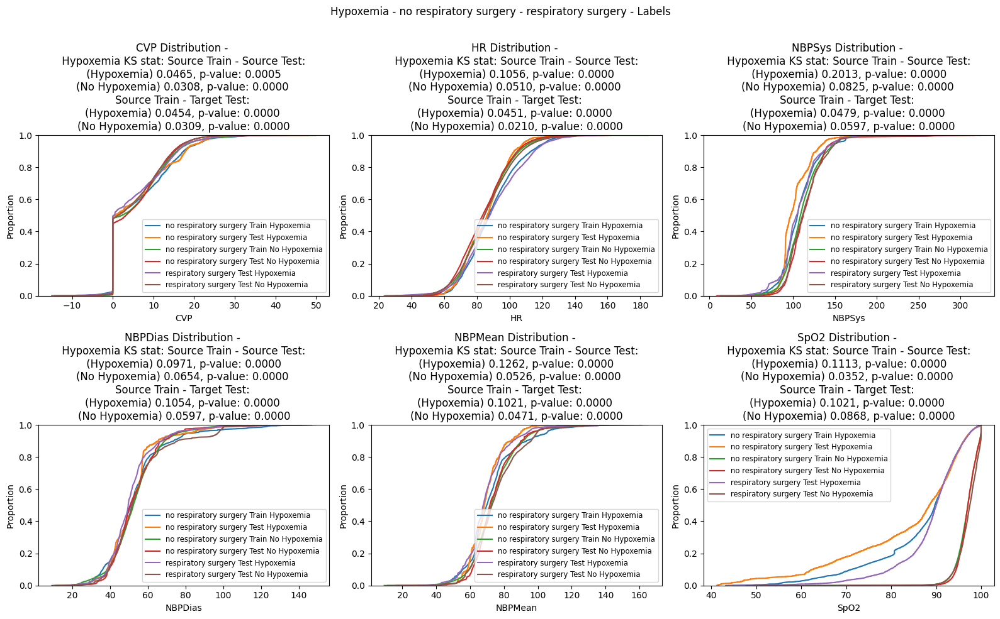

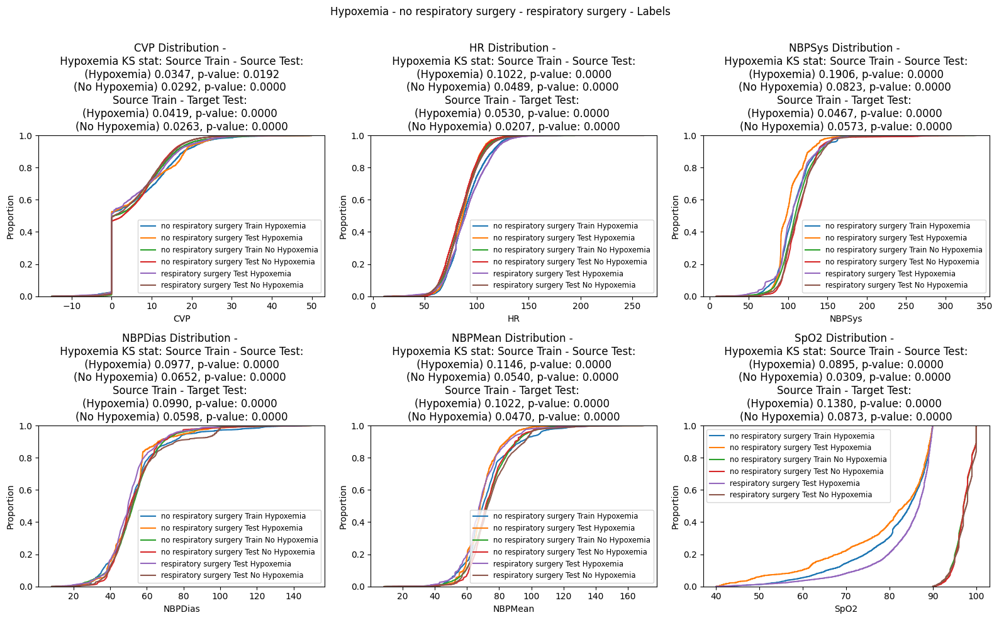

Cumulative - Hypotension - No Respiratory Surgery - Respiratory Surgery
Classwise - Source Train + Source Test + Target Test


C:\Users\Mayra Elwes\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


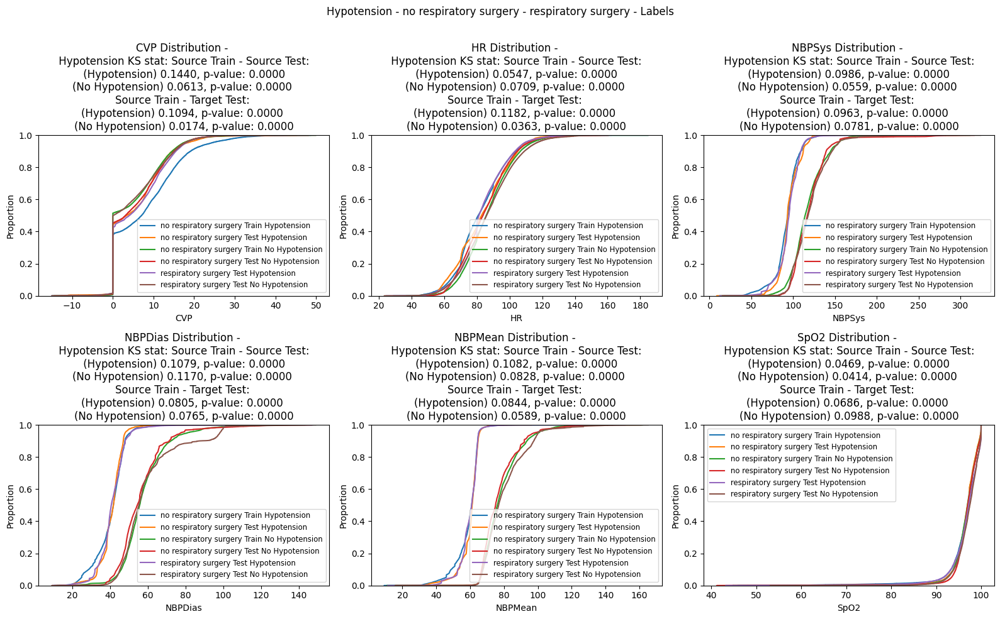

C:\Users\Mayra Elwes\AppData\Local\Temp\ipykernel_19172\3385178460.py:43: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0, 1, 0.97])
C:\Users\Mayra Elwes\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


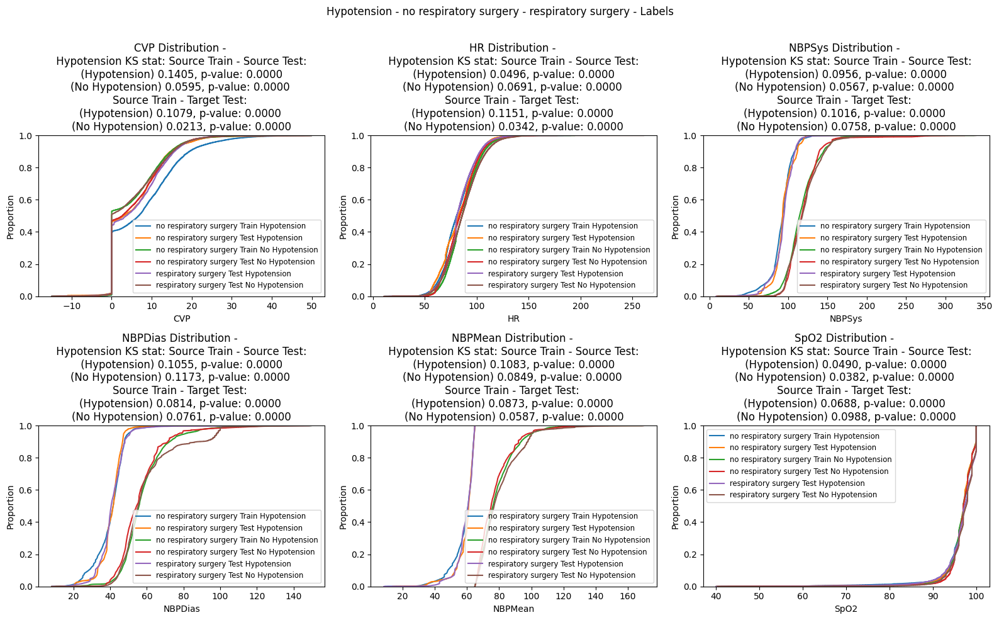

In [ ]:
visual_comparison_source_train_source_test_target_test(no_respiratory_train, no_respiratory_test,respiratory_train, respiratory_test,  "no_respiratory_surgery", "respiratory_surgery", plot_distribution_compare)
print("Hypoxemia - No Respiratory Surgery - Respiratory Surgery")
visual_comparison_source_train_source_test_target_test_class_wise("no_respiratory_surgery", "respiratory_surgery", "Hypoxemia", plot_distribution_compare_class_wise)
print("Hypotension - No Respiratory Surgery - Respiratory Surgery")
visual_comparison_source_train_source_test_target_test_class_wise( "no_respiratory_surgery", "respiratory_surgery","Hypotension", plot_distribution_compare_class_wise)
print("Cumulative - No Respiratory Surgery - Respiratory Surgery")
visual_comparison_source_train_source_test_target_test(no_respiratory_train, no_respiratory_test, respiratory_train, respiratory_test, "no_respiratory_surgery", "respiratory_surgery", plot_cumulative_distribution_compare)
print("Cumulative - Hypoxemia - No Respiratory Surgery - Respiratory Surgery")
visual_comparison_source_train_source_test_target_test_class_wise("no_respiratory_surgery","respiratory_surgery",  "Hypoxemia", plot_cumulative_distribution_compare_classwise)
print("Cumulative - Hypotension - No Respiratory Surgery - Respiratory Surgery")
visual_comparison_source_train_source_test_target_test_class_wise("no_respiratory_surgery", "respiratory_surgery", "Hypotension", plot_cumulative_distribution_compare_classwise)

## Vasopressors vs No Vasopressors

In [ ]:
vasopressors_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_vasopressors_cleaned.pt', weights_only=False)
vasopressors_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_vasopressors_cleaned.pt', weights_only=False)

no_vasopressors_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_no_vasopressors_cleaned.pt', weights_only=False)
no_vasopressors_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_no_vasopressors_cleaned.pt', weights_only=False)

Source Train + Source Test + Target Test


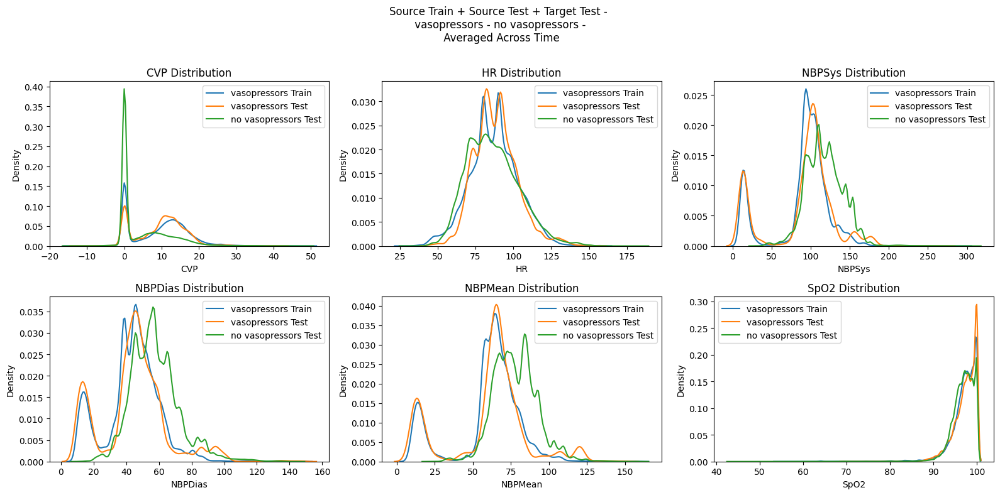

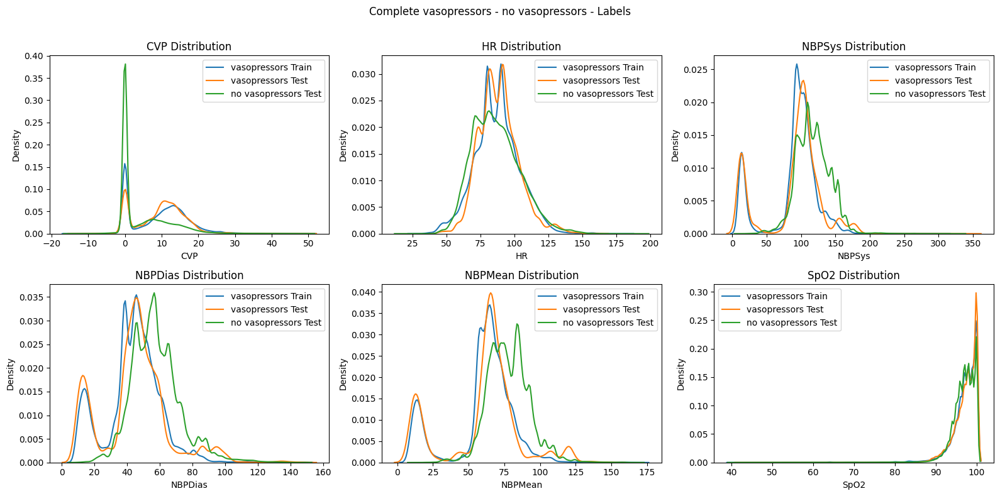

In [ ]:
visual_comparison_source_train_source_test_target_test(vasopressors_train, vasopressors_test, no_vasopressors_train, no_vasopressors_test, "vasopressors", "no_vasopressors", plot_distribution_compare)

Classwise - Source Train + Source Test + Target Test


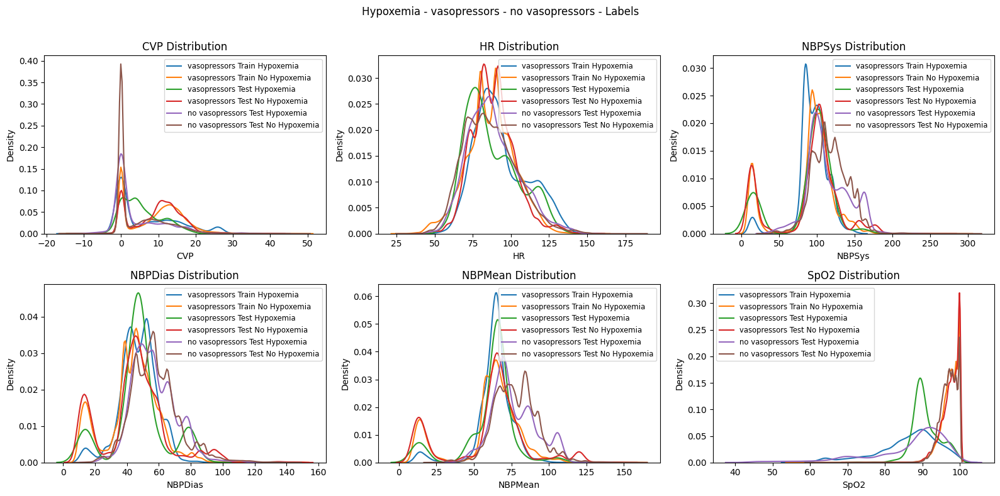

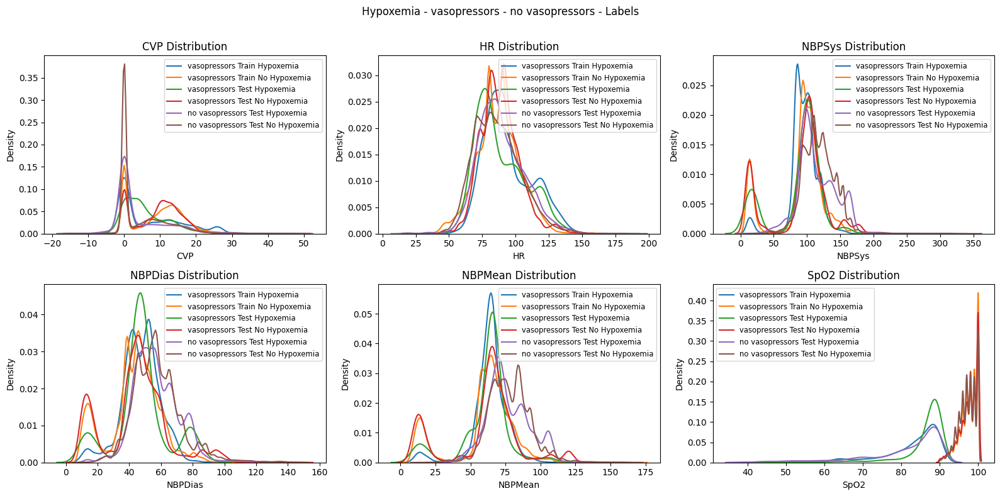

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("vasopressors", "no_vasopressors", "Hypoxemia", plot_distribution_compare_class_wise)

Classwise - Source Train + Source Test + Target Test


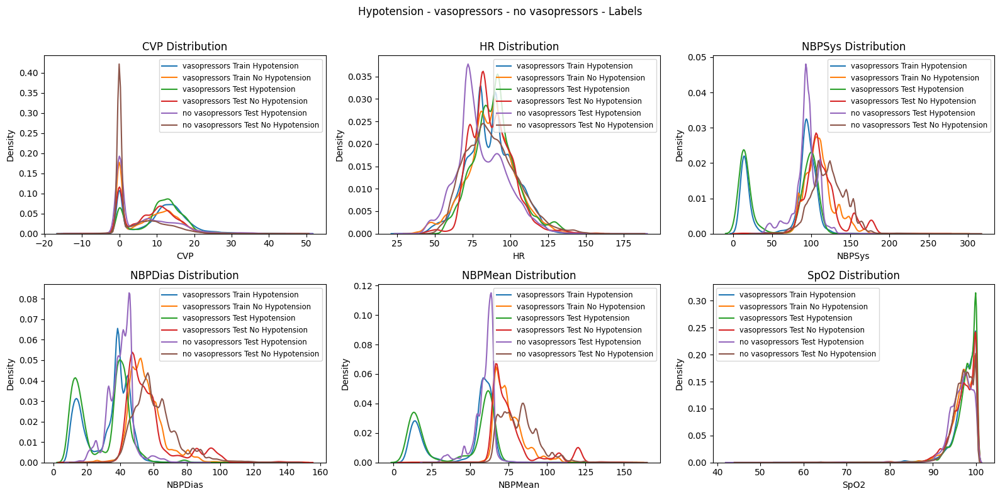

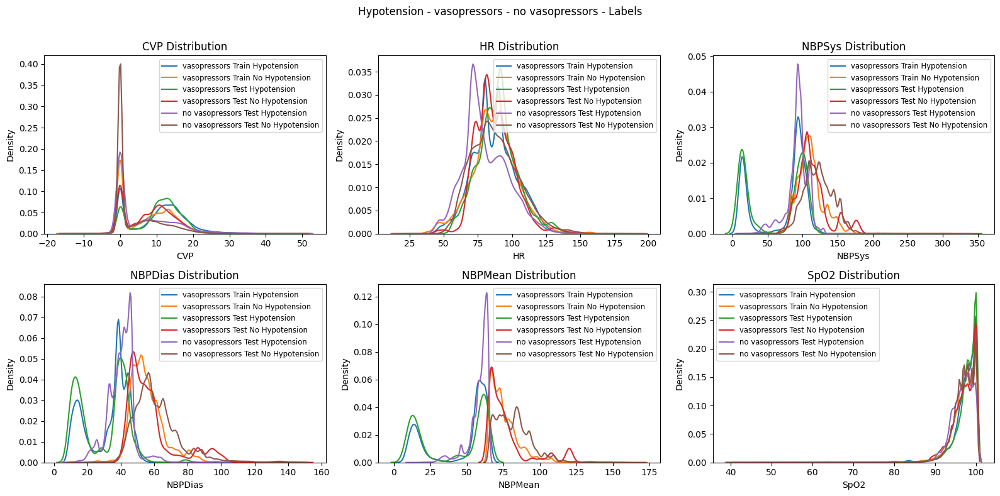

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("vasopressors", "no_vasopressors", "Hypotension", plot_distribution_compare_class_wise)

Source Train + Source Test + Target Test


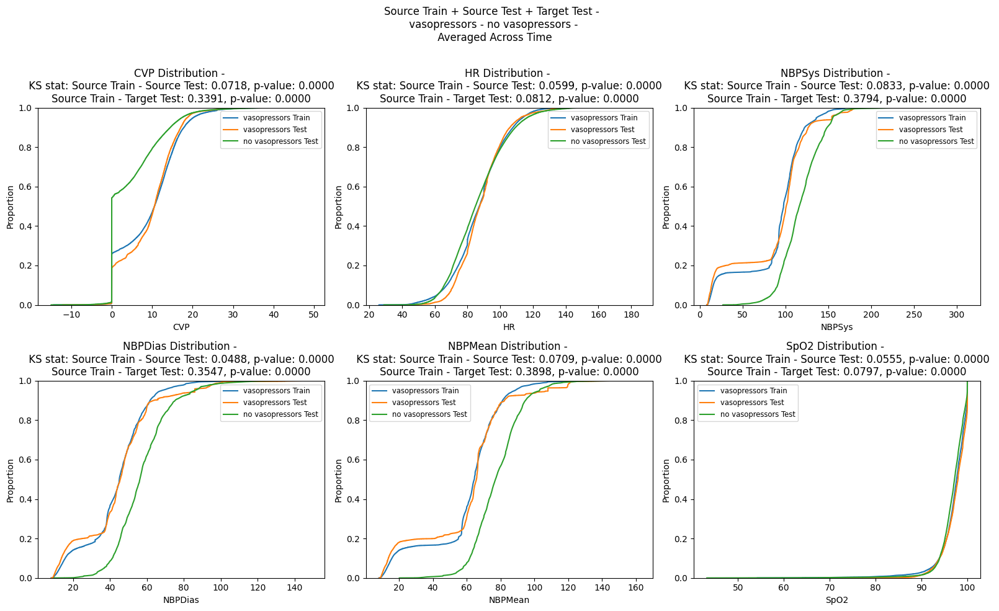

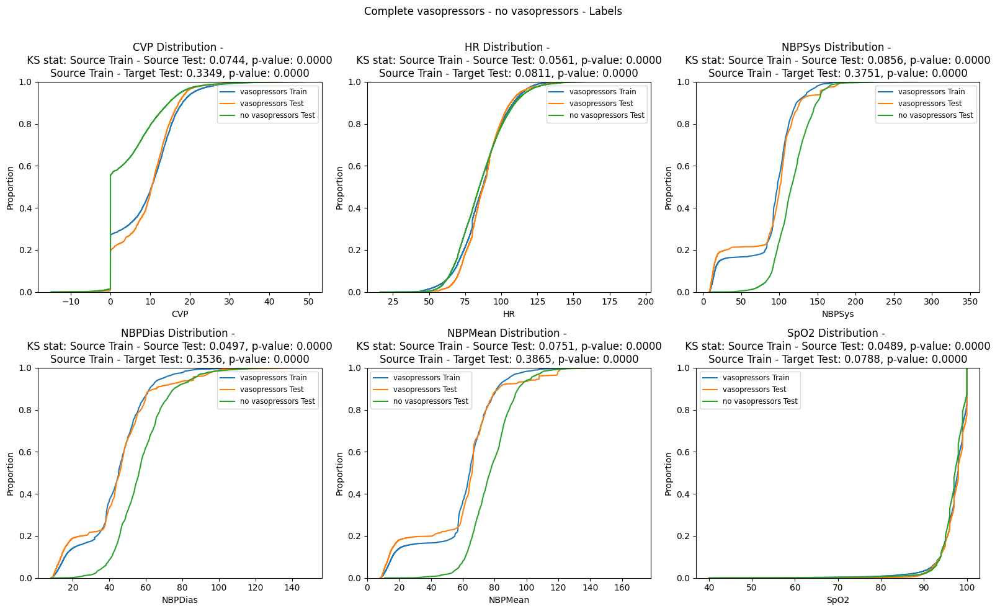

In [ ]:
visual_comparison_source_train_source_test_target_test(vasopressors_train, vasopressors_test, no_vasopressors_train, no_vasopressors_test, "vasopressors", "no_vasopressors", plot_cumulative_distribution_compare)

Classwise - Source Train + Source Test + Target Test


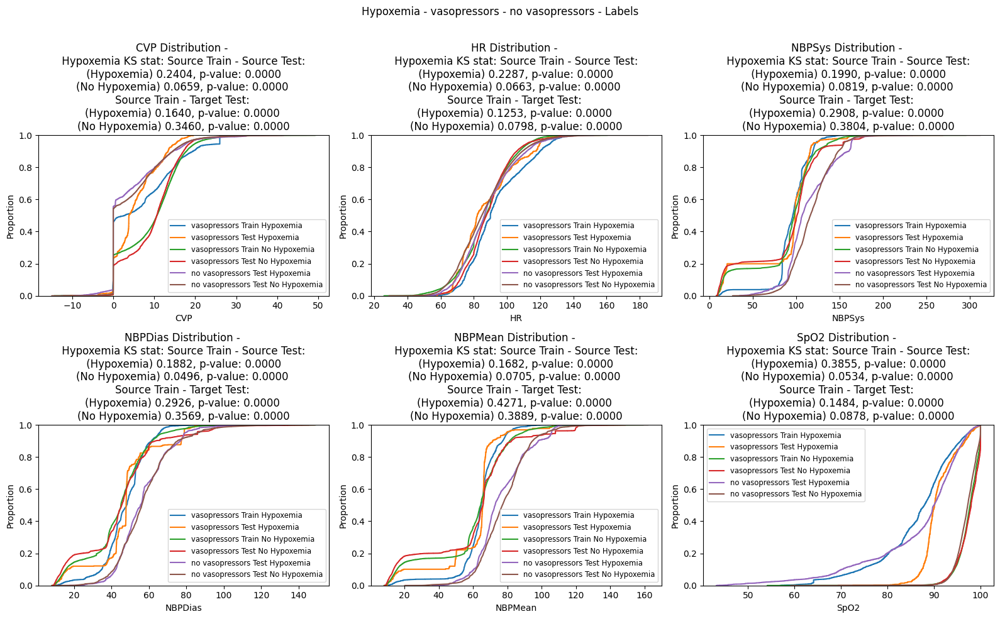

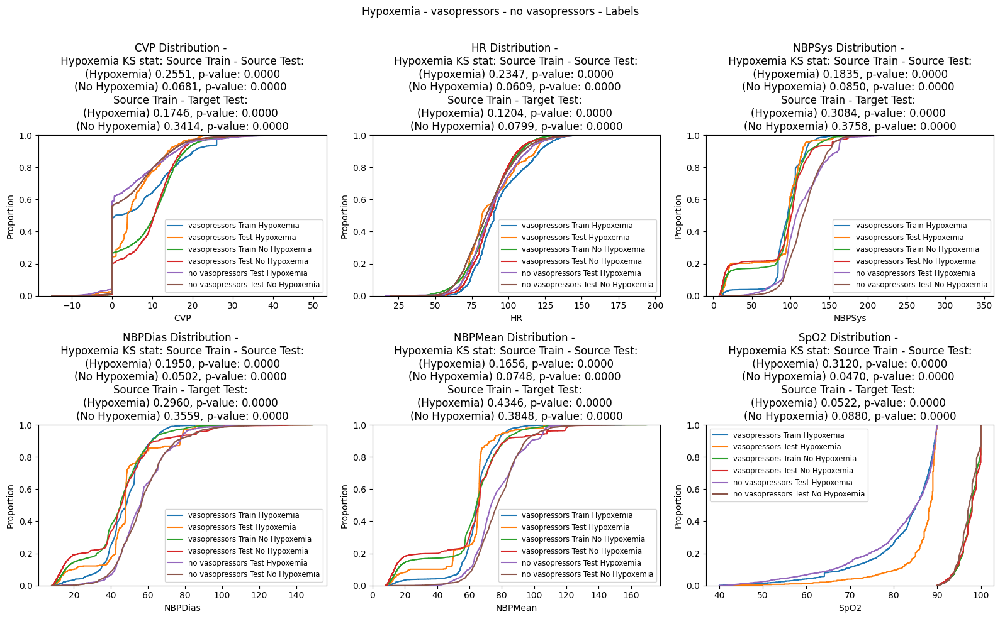

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("vasopressors", "no_vasopressors", "Hypoxemia", plot_cumulative_distribution_compare_classwise)

Classwise - Source Train + Source Test + Target Test


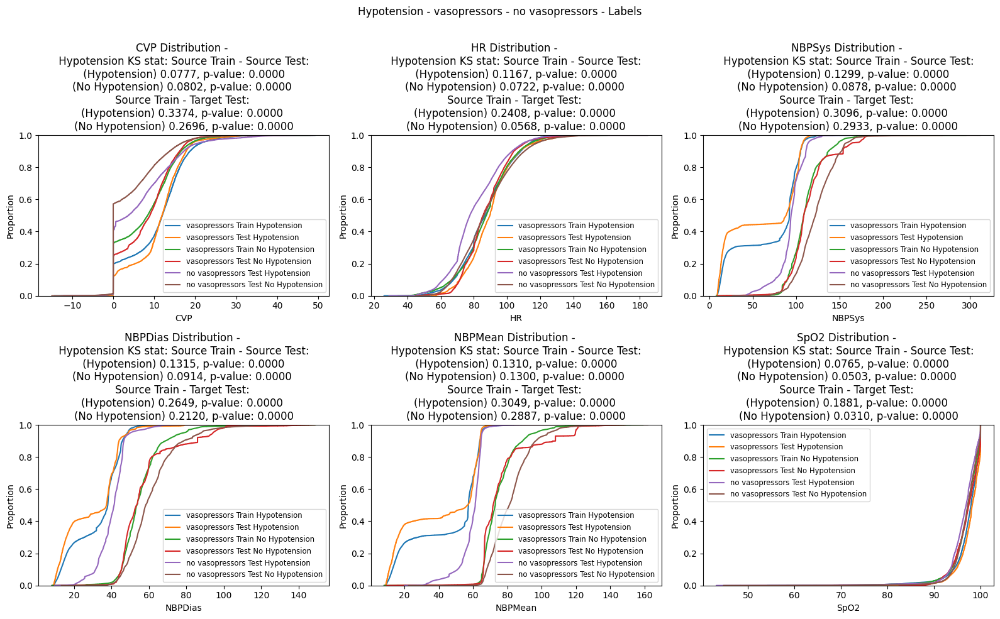

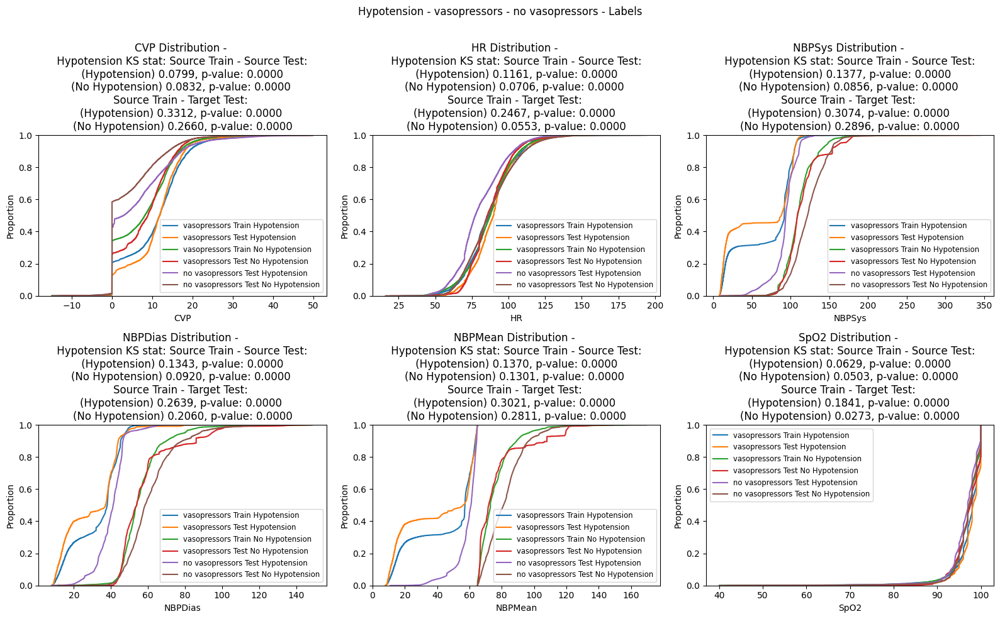

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("vasopressors", "no_vasopressors", "Hypotension", plot_cumulative_distribution_compare_classwise)

## No Vasopressors vs Vasopressors

Source Train + Source Test + Target Test


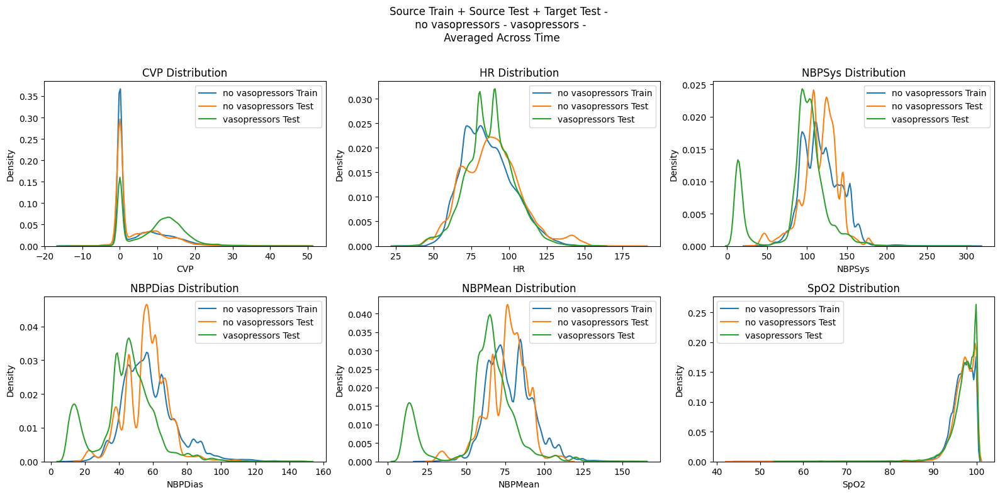

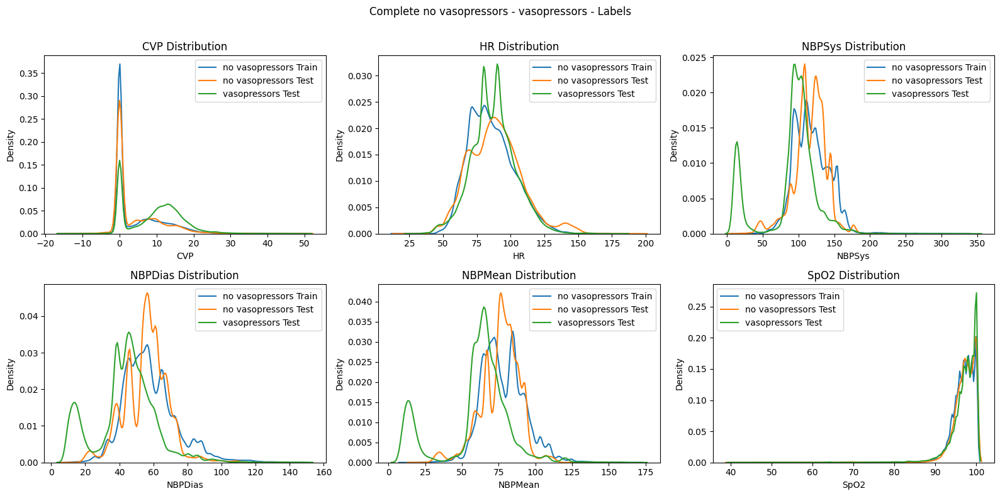

Hypoxemia - No Vasopressors - Vasopressors
Classwise - Source Train + Source Test + Target Test


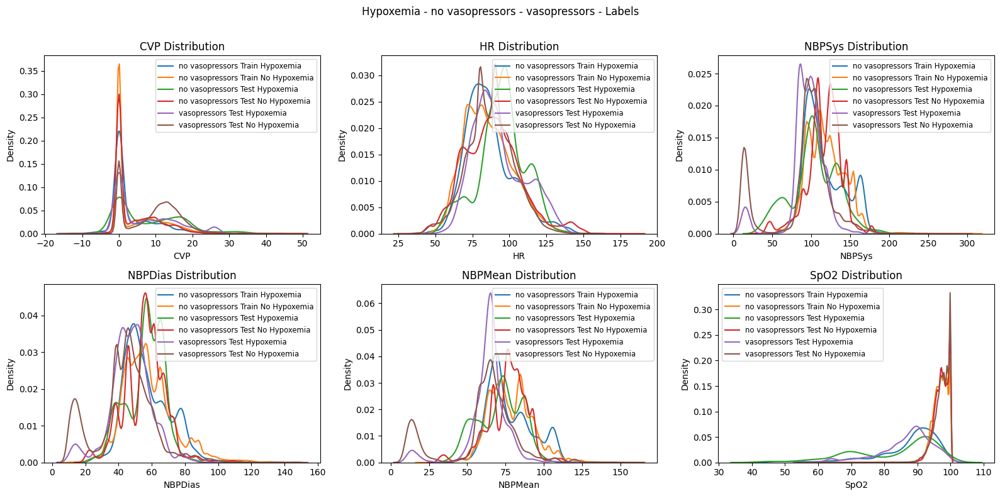

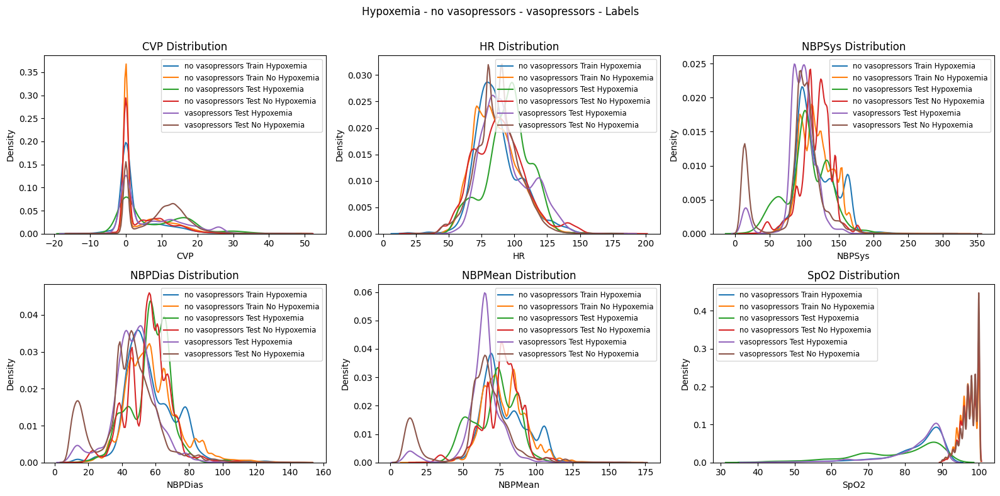

Hypotension - No Vasopressors - Vasopressors
Classwise - Source Train + Source Test + Target Test


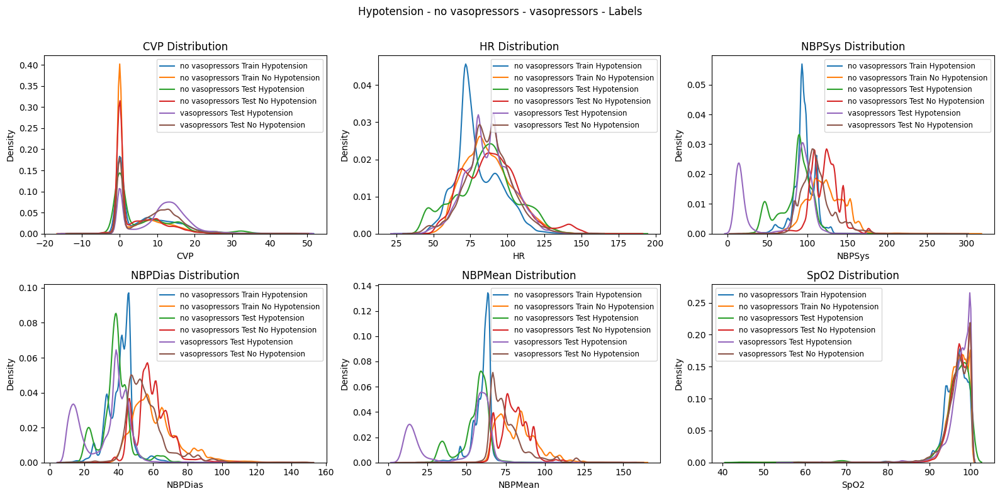

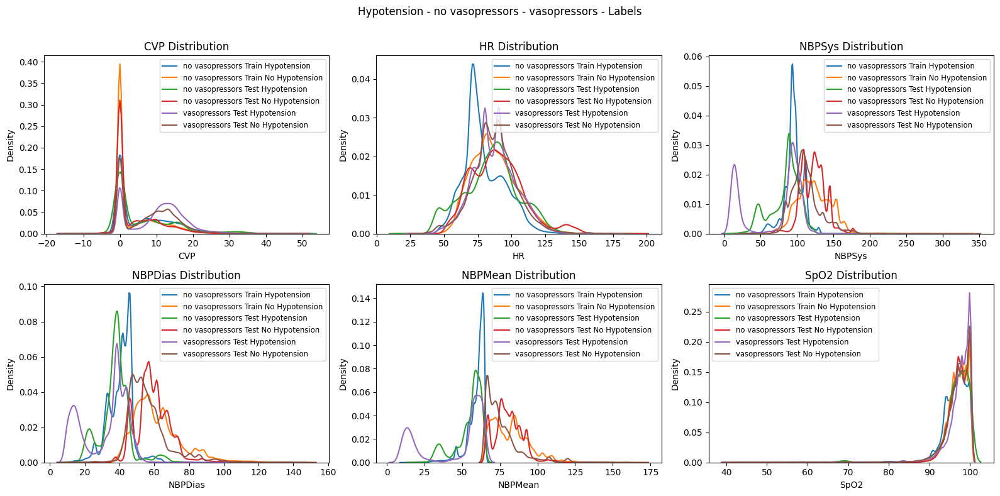

Cumulative - No Vasopressors - Vasopressors
Source Train + Source Test + Target Test


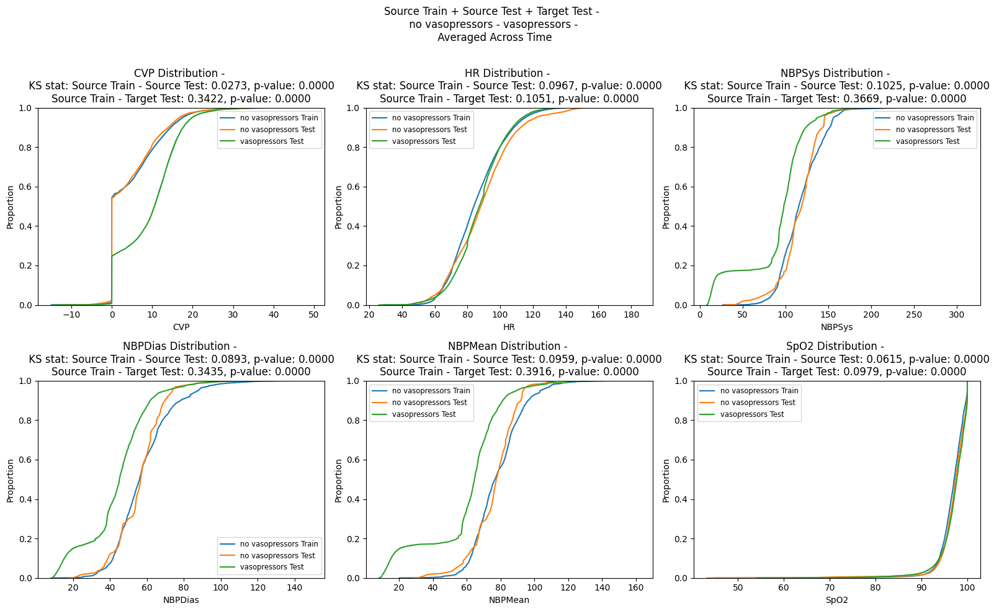

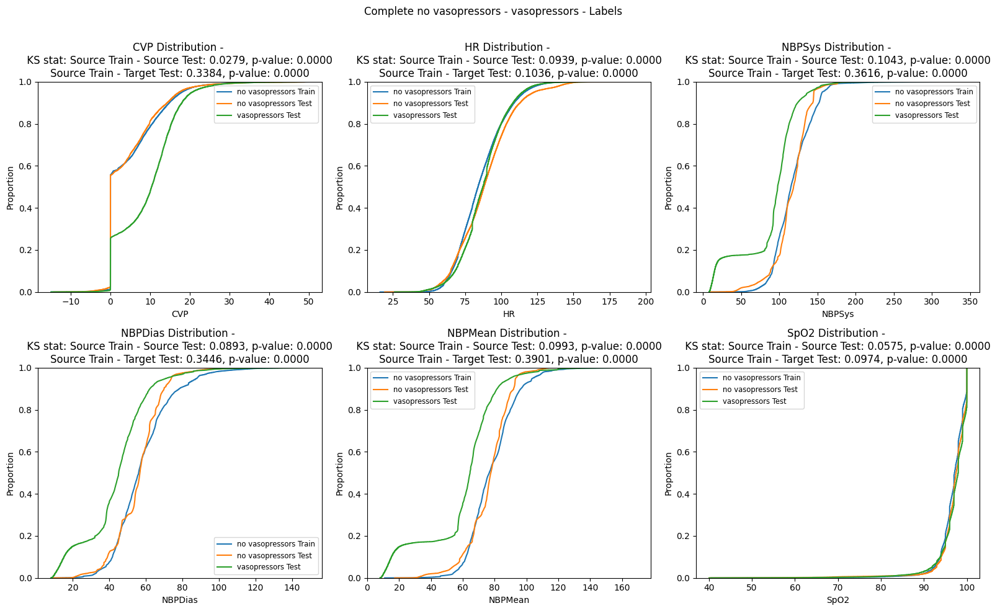

Cumulative - Hypoxemia - No Vasopressors - Vasopressors
Classwise - Source Train + Source Test + Target Test


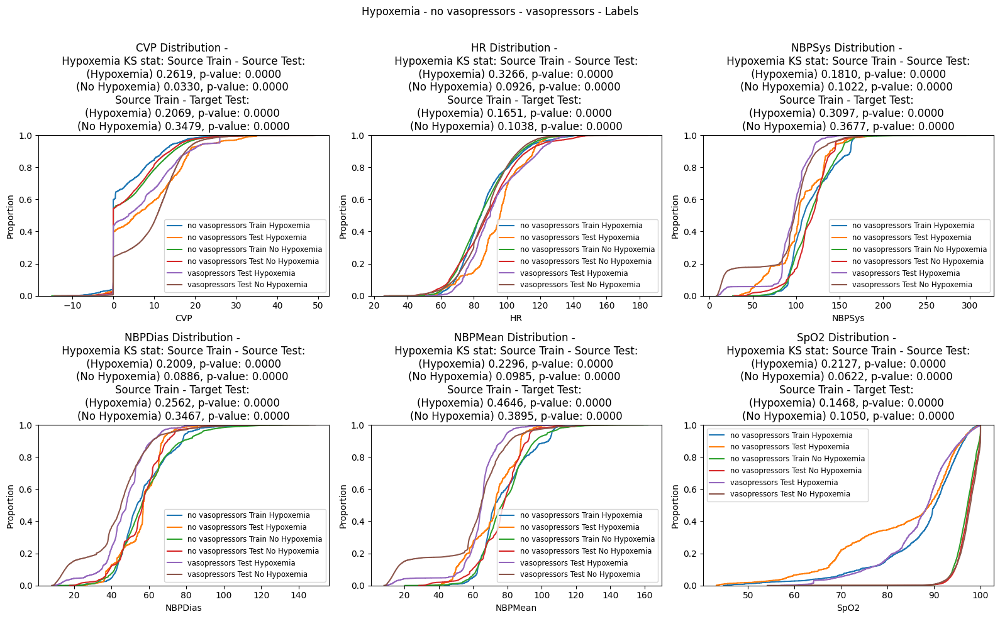

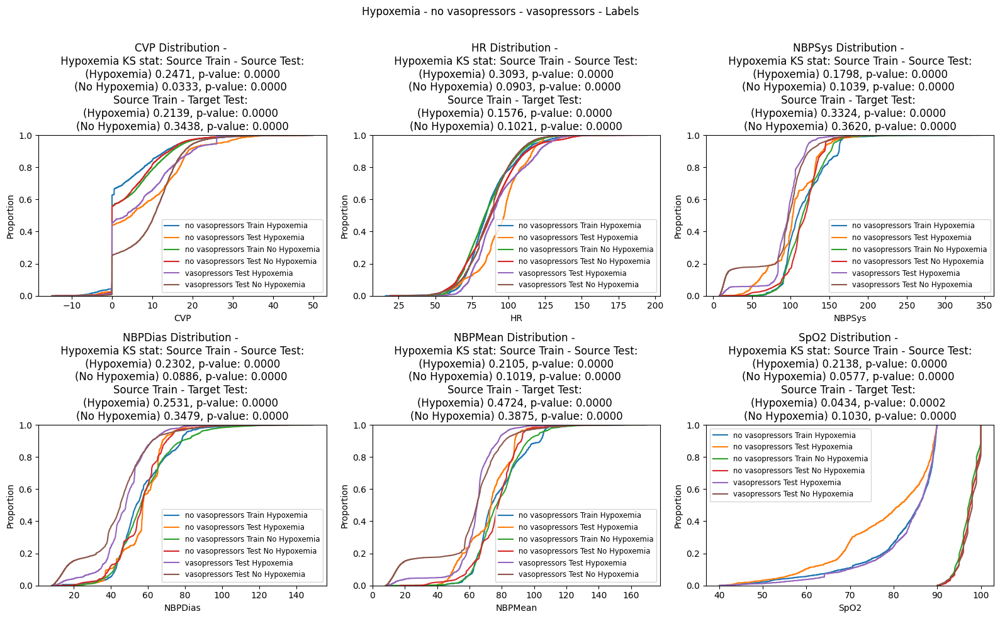

Cumulative - Hypotension - No Vasopressors - Vasopressors
Classwise - Source Train + Source Test + Target Test


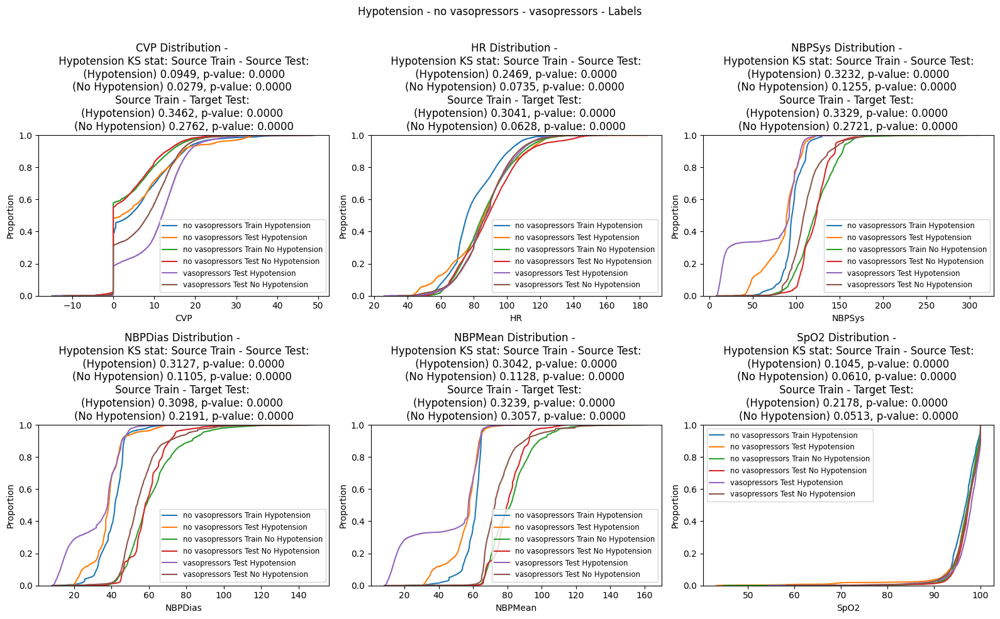

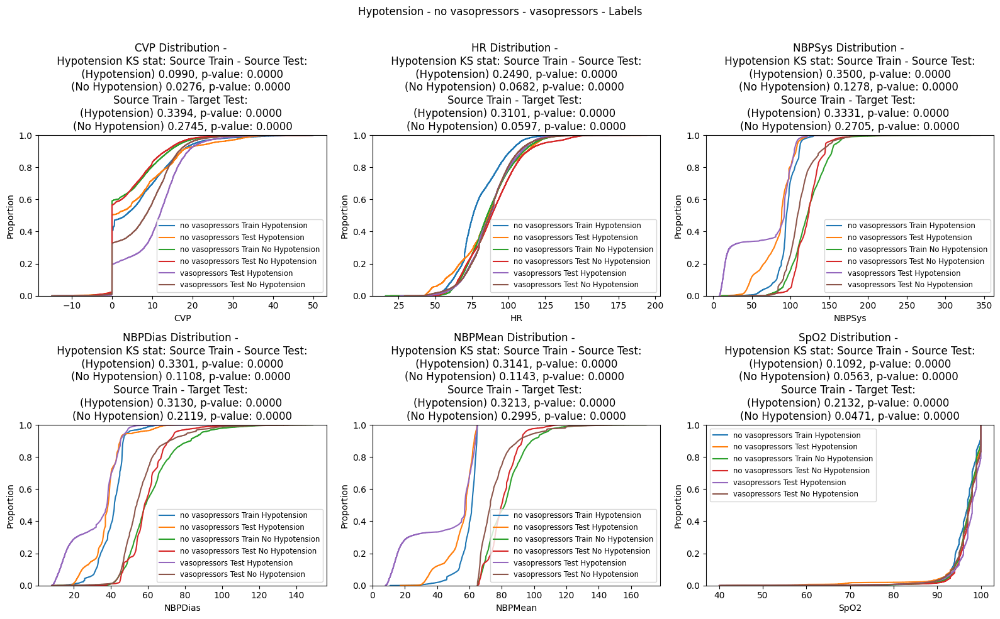

In [ ]:
visual_comparison_source_train_source_test_target_test(no_vasopressors_train, no_vasopressors_test,vasopressors_train, vasopressors_test,  "no_vasopressors", "vasopressors", plot_distribution_compare)
print("Hypoxemia - No Vasopressors - Vasopressors")
visual_comparison_source_train_source_test_target_test_class_wise("no_vasopressors", "vasopressors", "Hypoxemia", plot_distribution_compare_class_wise)
print("Hypotension - No Vasopressors - Vasopressors")
visual_comparison_source_train_source_test_target_test_class_wise( "no_vasopressors", "vasopressors","Hypotension", plot_distribution_compare_class_wise)
print("Cumulative - No Vasopressors - Vasopressors")
visual_comparison_source_train_source_test_target_test(no_vasopressors_train, no_vasopressors_test, vasopressors_train, vasopressors_test, "no_vasopressors", "vasopressors", plot_cumulative_distribution_compare)
print("Cumulative - Hypoxemia - No Vasopressors - Vasopressors")
visual_comparison_source_train_source_test_target_test_class_wise("no_vasopressors","vasopressors",  "Hypoxemia", plot_cumulative_distribution_compare_classwise)
print("Cumulative - Hypotension - No Vasopressors - Vasopressors")
visual_comparison_source_train_source_test_target_test_class_wise("no_vasopressors", "vasopressors", "Hypotension", plot_cumulative_distribution_compare_classwise)

## Ventilation vs No Ventilation

In [ ]:
ventilation_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_ventilation_cleaned.pt', weights_only=False)
ventilation_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_ventilation_cleaned.pt', weights_only=False)

no_ventilation_train = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/train_no_ventilation_cleaned.pt', weights_only=False)
no_ventilation_test = torch.load('../../Algorithm2Domain/Evaluation_Framework/ADATime_data/PHD/test_no_ventilation_cleaned.pt', weights_only=False)

Source Train + Source Test + Target Test


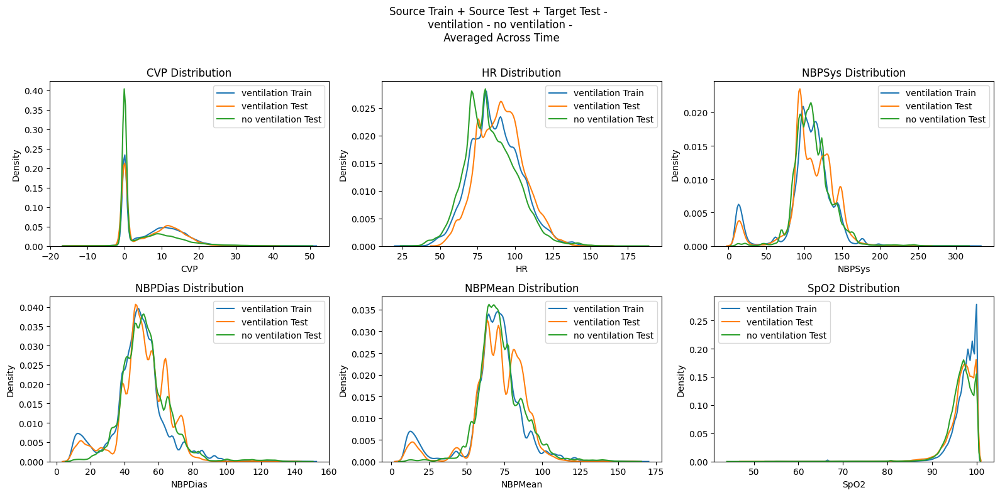

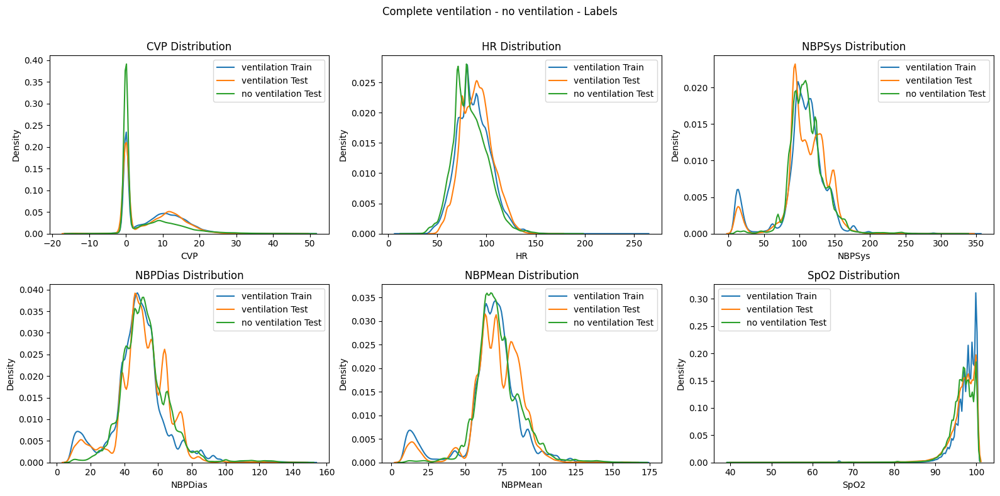

In [ ]:
visual_comparison_source_train_source_test_target_test(ventilation_train, ventilation_test, no_ventilation_train, no_ventilation_test, "ventilation", "no_ventilation", plot_distribution_compare)

Classwise - Source Train + Source Test + Target Test


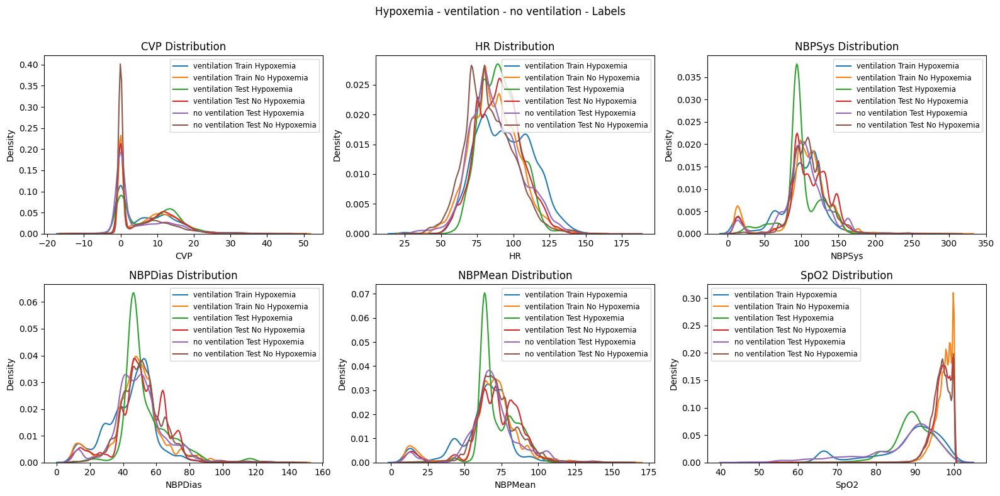

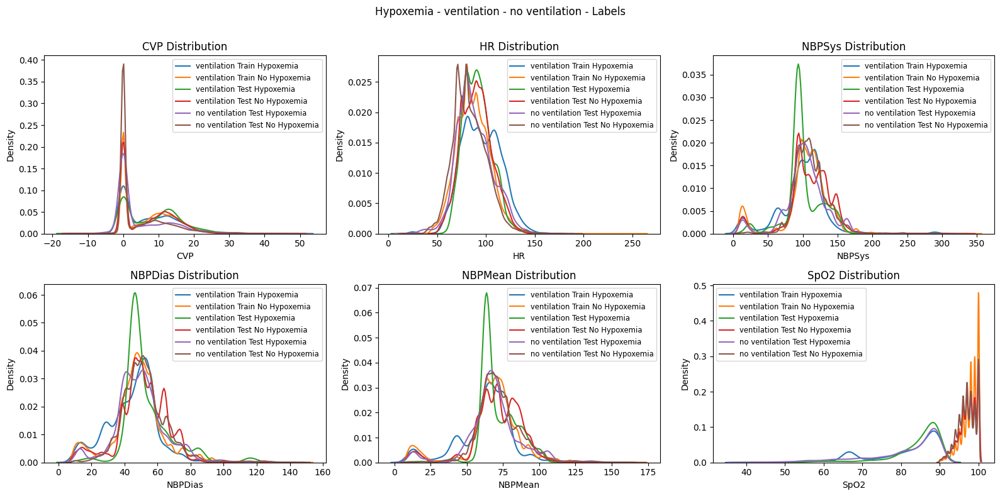

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("ventilation", "no_ventilation", "Hypoxemia", plot_distribution_compare_class_wise)

Classwise - Source Train + Source Test + Target Test


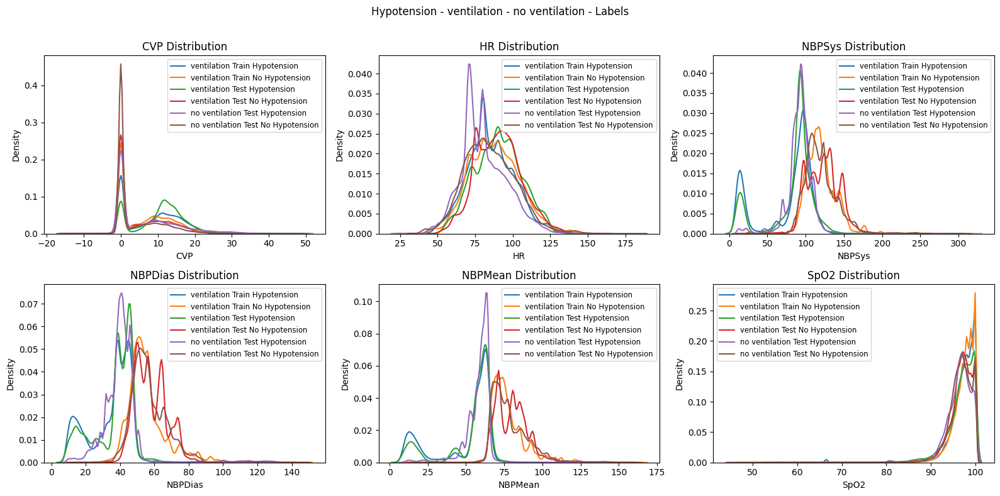

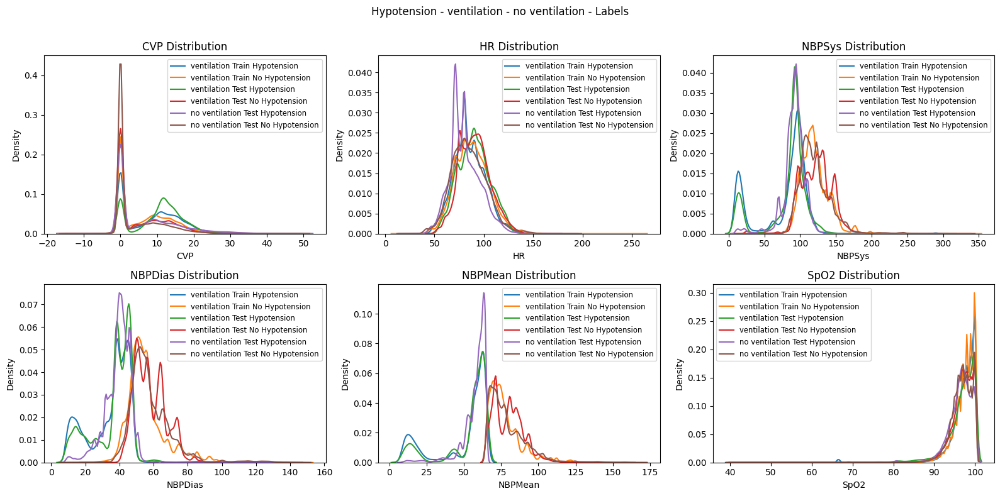

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("ventilation", "no_ventilation", "Hypotension", plot_distribution_compare_class_wise)

Source Train + Source Test + Target Test


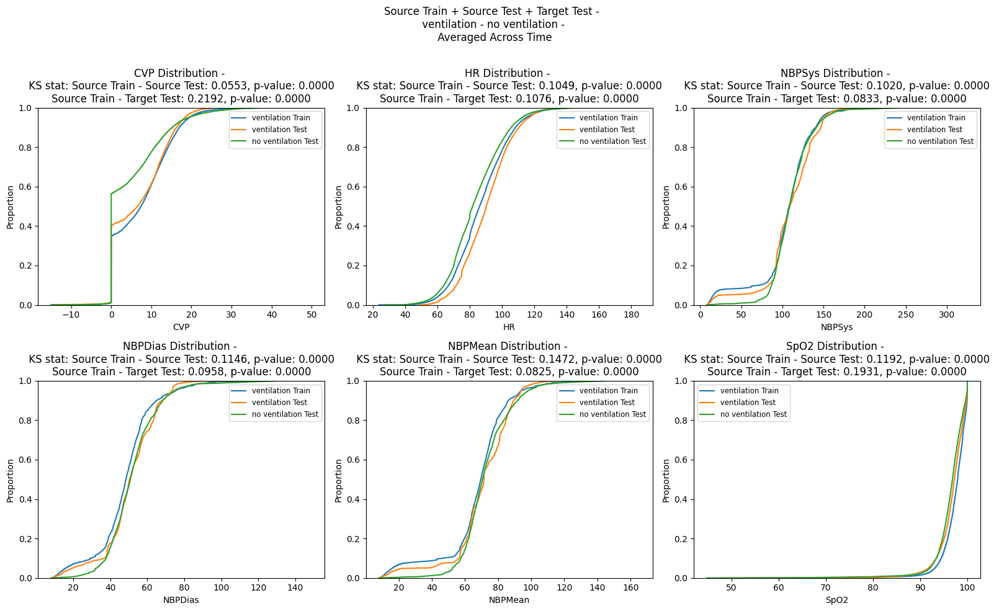

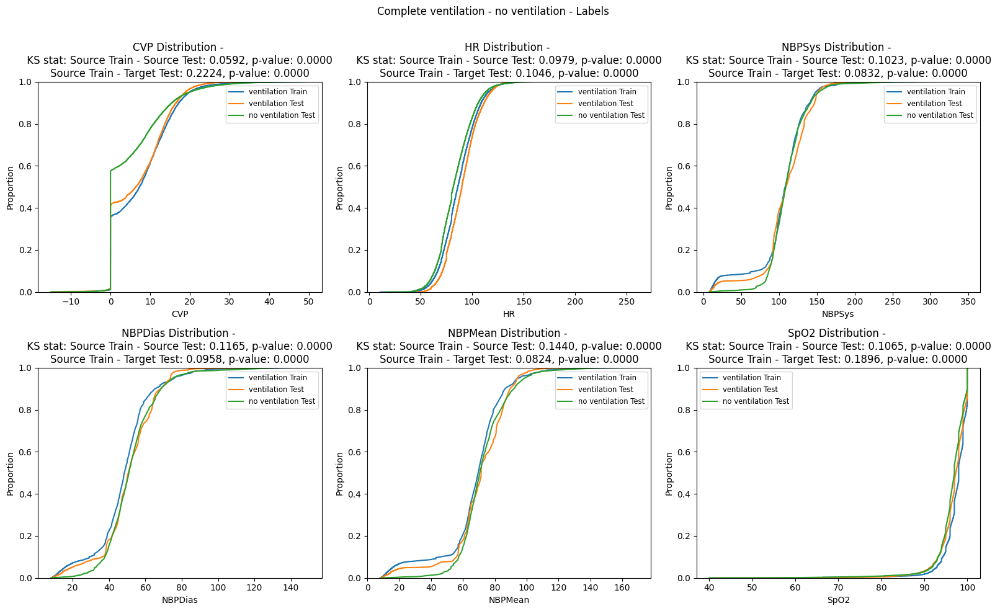

In [ ]:
visual_comparison_source_train_source_test_target_test(ventilation_train, ventilation_test, no_ventilation_train, no_ventilation_test, "ventilation", "no_ventilation", plot_cumulative_distribution_compare)

Classwise - Source Train + Source Test + Target Test


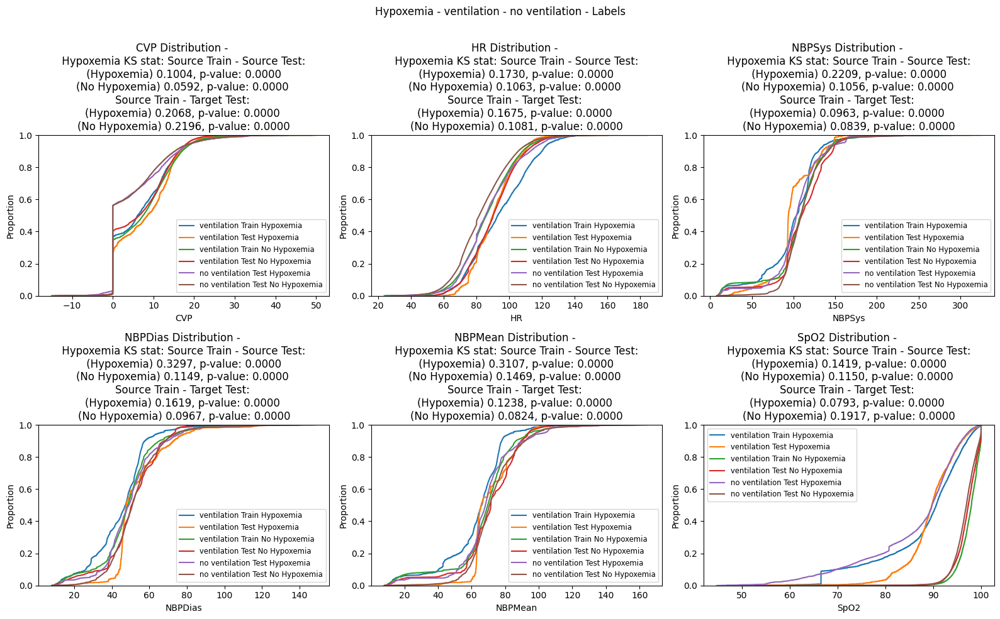

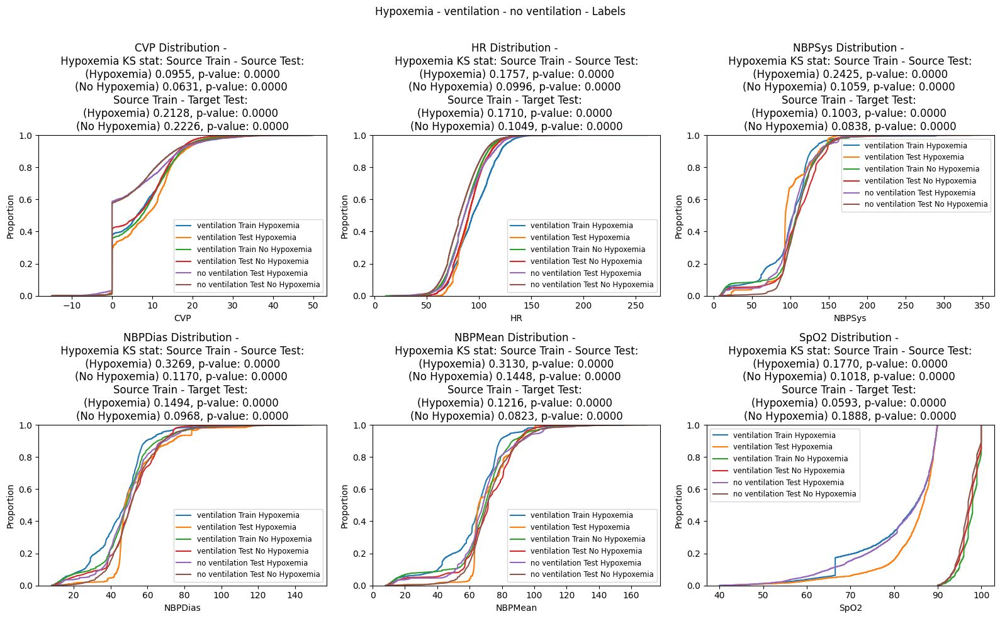

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("ventilation", "no_ventilation", "Hypoxemia", plot_cumulative_distribution_compare_classwise)

Classwise - Source Train + Source Test + Target Test


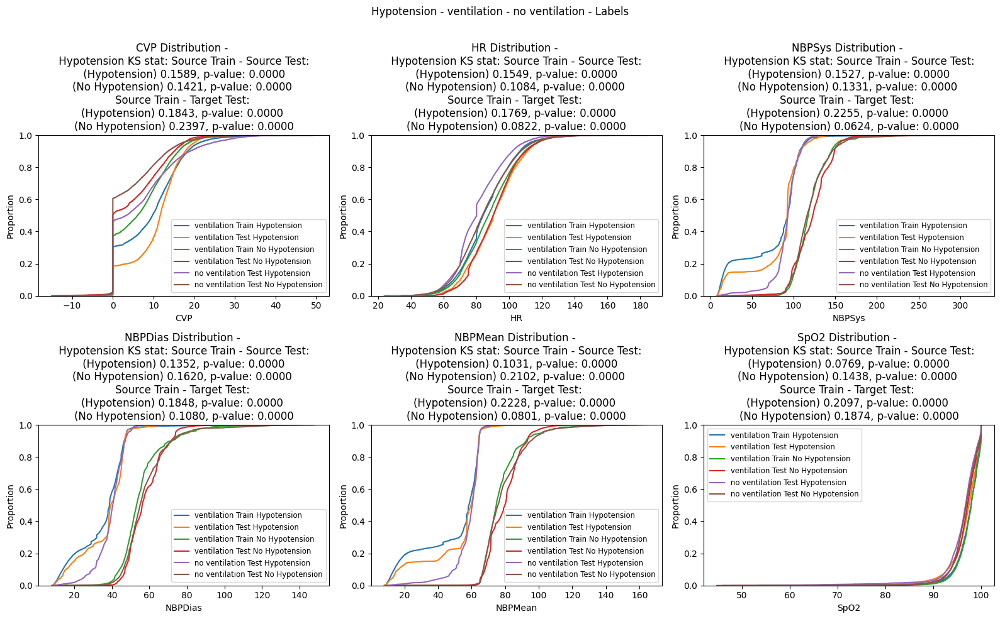

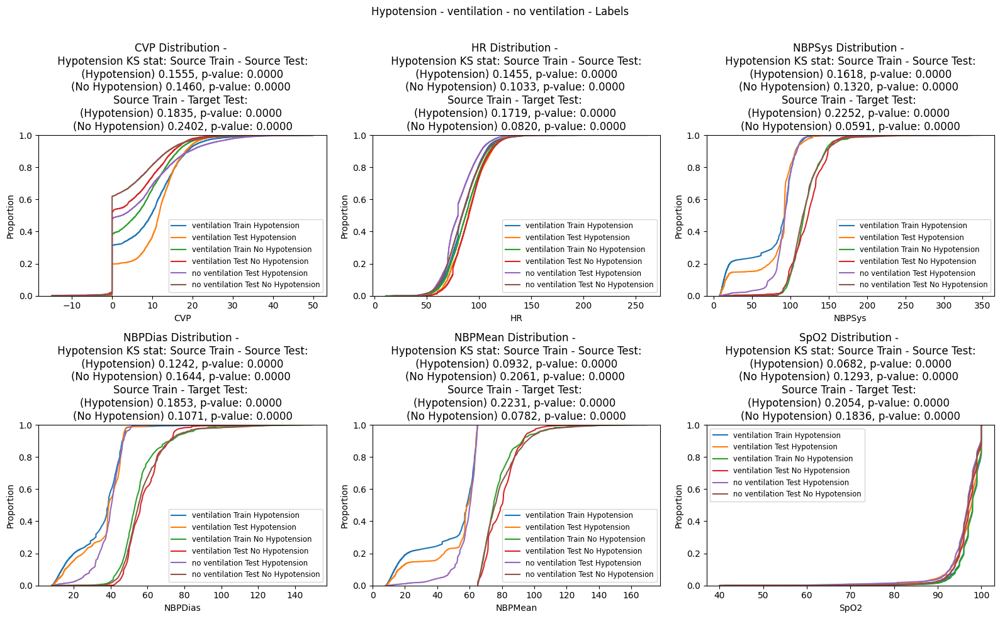

In [ ]:
visual_comparison_source_train_source_test_target_test_class_wise("ventilation", "no_ventilation", "Hypotension", plot_cumulative_distribution_compare_classwise)

## No Ventilation vs Ventilation

Source Train + Source Test + Target Test


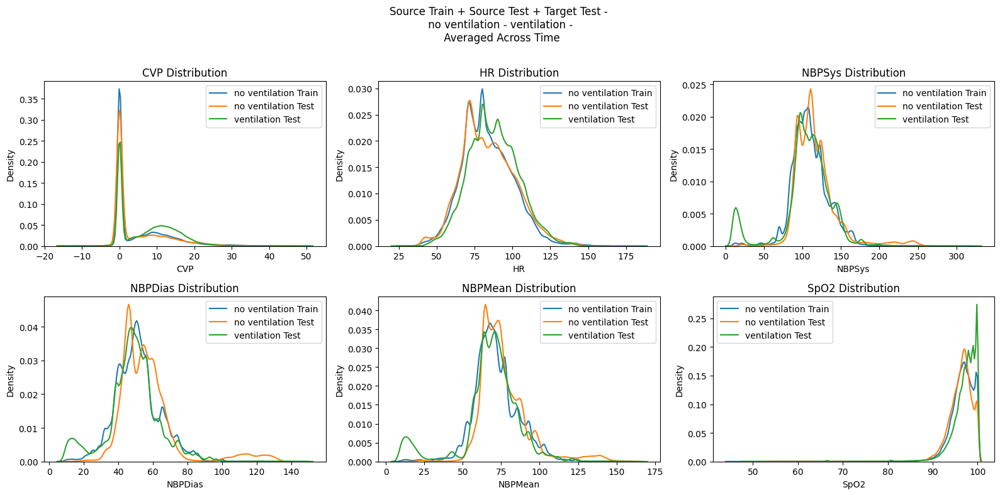

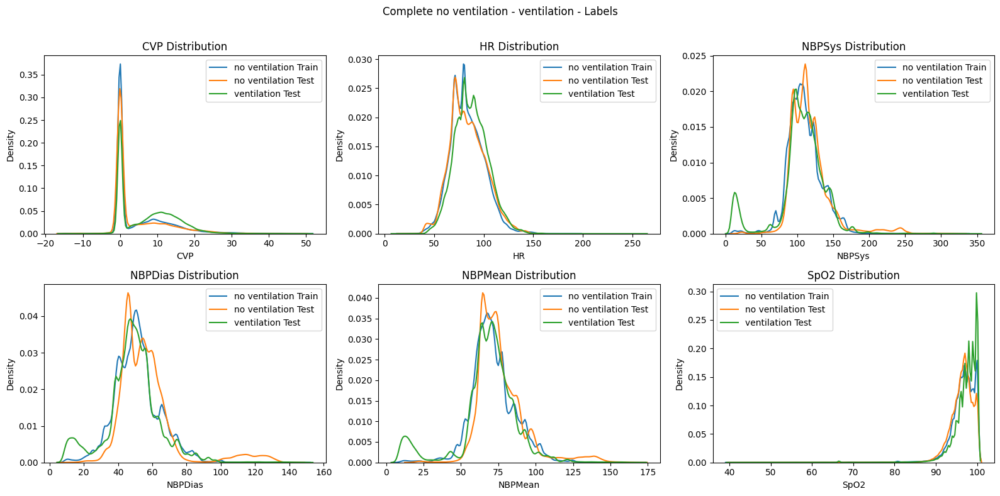

Hypoxemia - No Ventilation - Ventilation
Classwise - Source Train + Source Test + Target Test


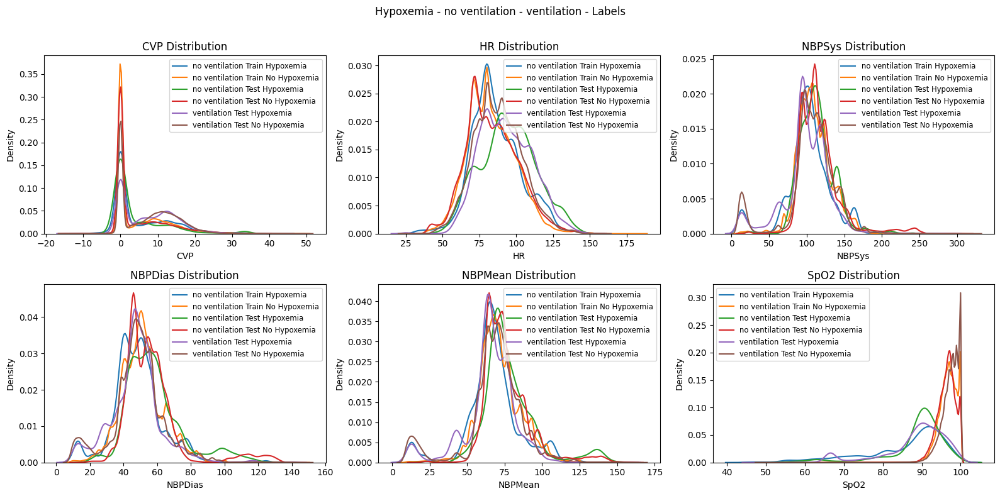

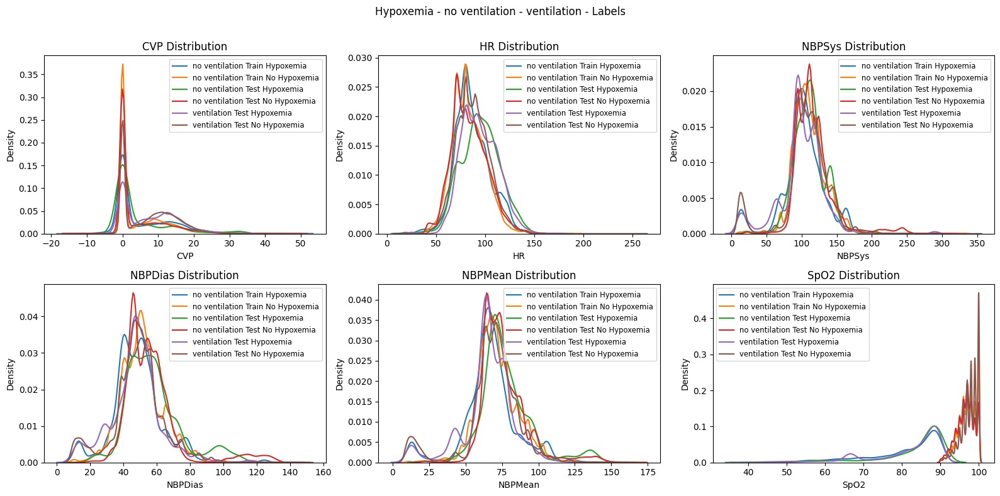

Hypotension
Classwise - Source Train + Source Test + Target Test


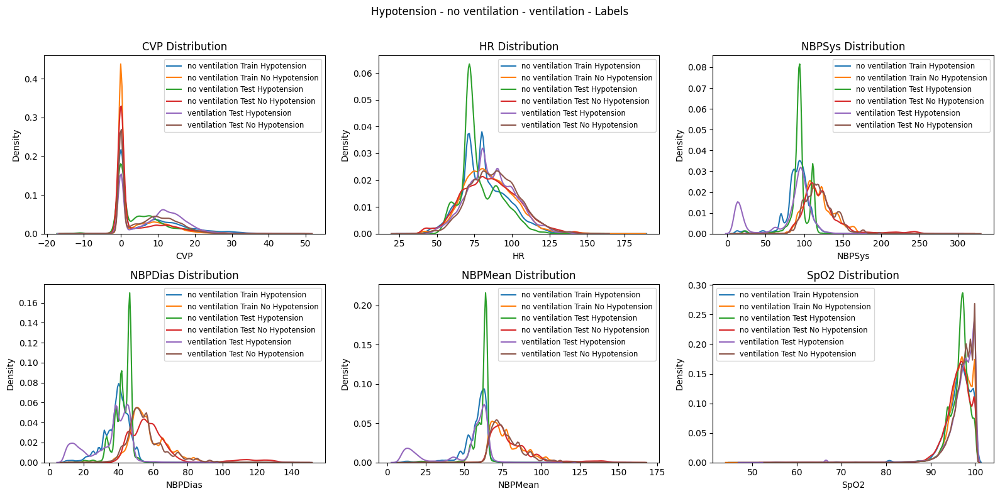

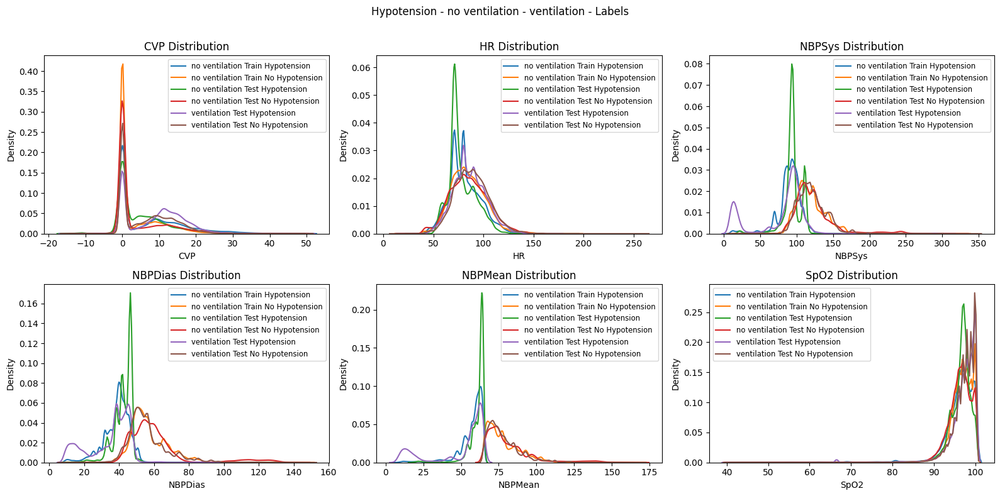

Cumulative
Source Train + Source Test + Target Test


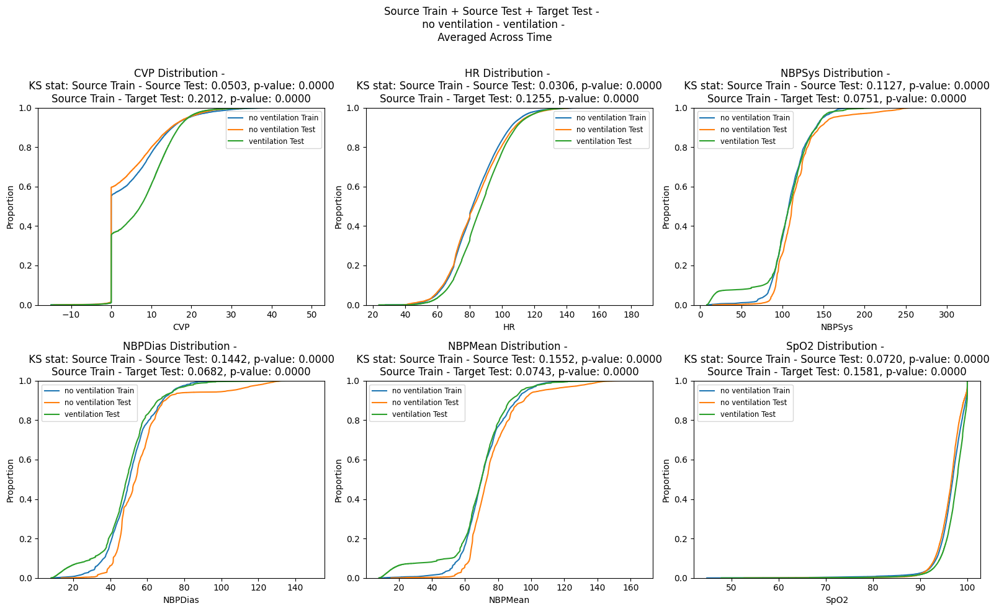

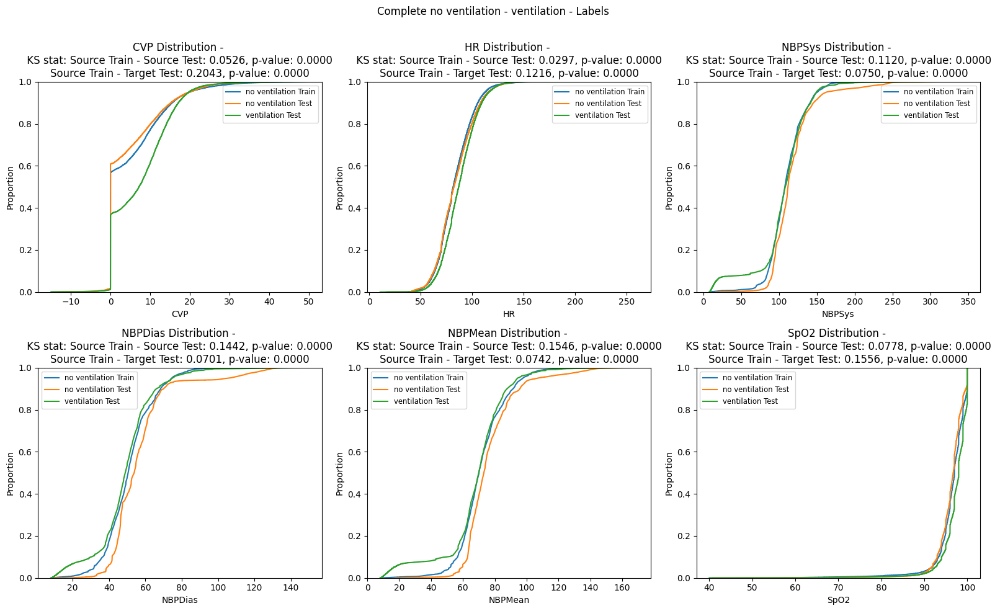

Hypoxemia Cumulative
Classwise - Source Train + Source Test + Target Test


C:\Users\Mayra Elwes\AppData\Local\Temp\ipykernel_19172\3385178460.py:43: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0, 1, 0.97])


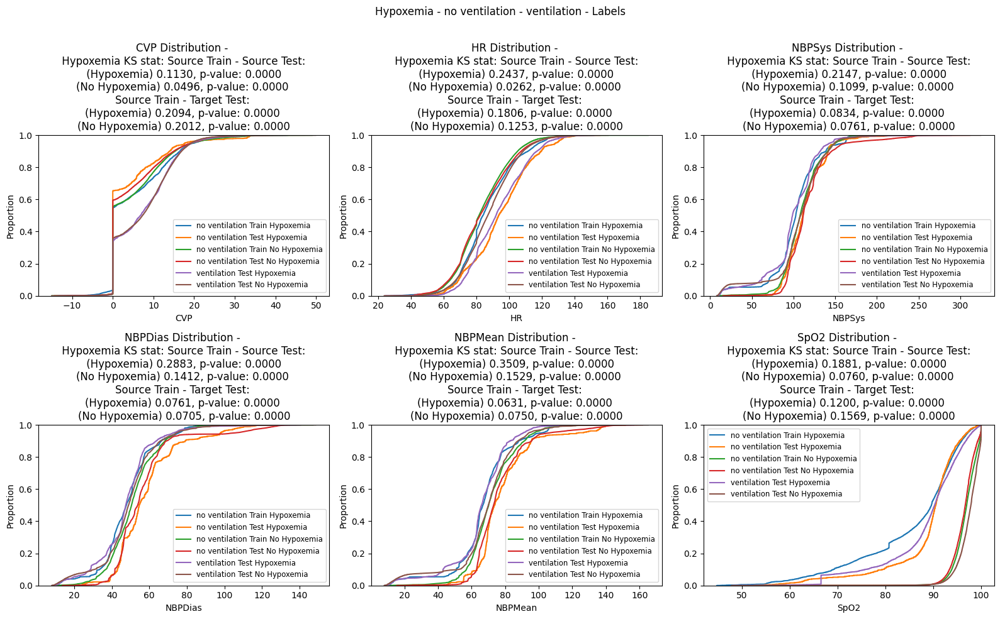

C:\Users\Mayra Elwes\AppData\Local\Temp\ipykernel_19172\3385178460.py:43: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0, 1, 0.97])


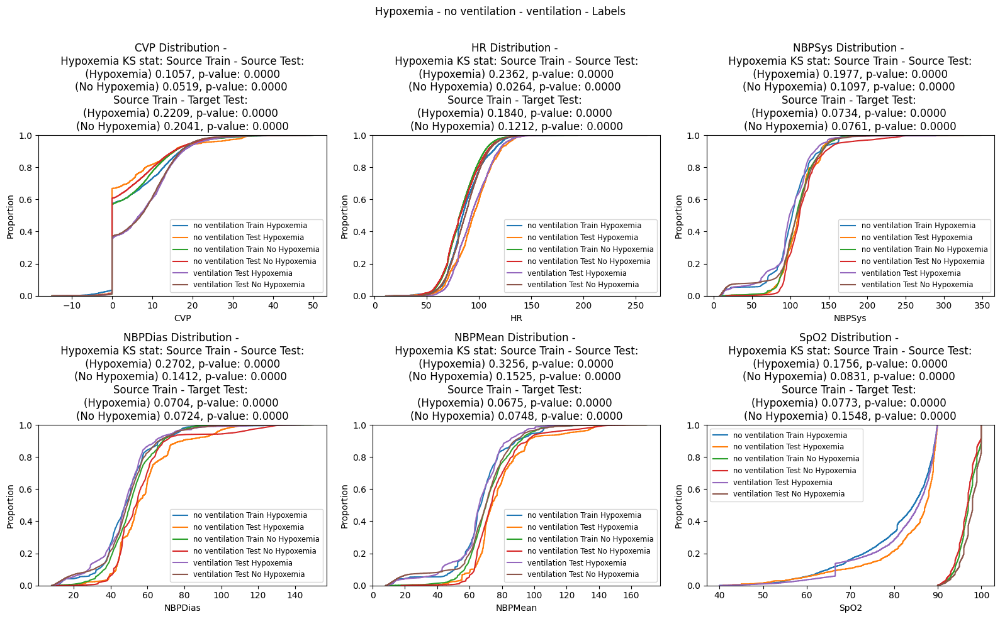

Hypotension Cumulative
Classwise - Source Train + Source Test + Target Test


C:\Users\Mayra Elwes\AppData\Local\Temp\ipykernel_19172\3385178460.py:43: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0, 1, 0.97])


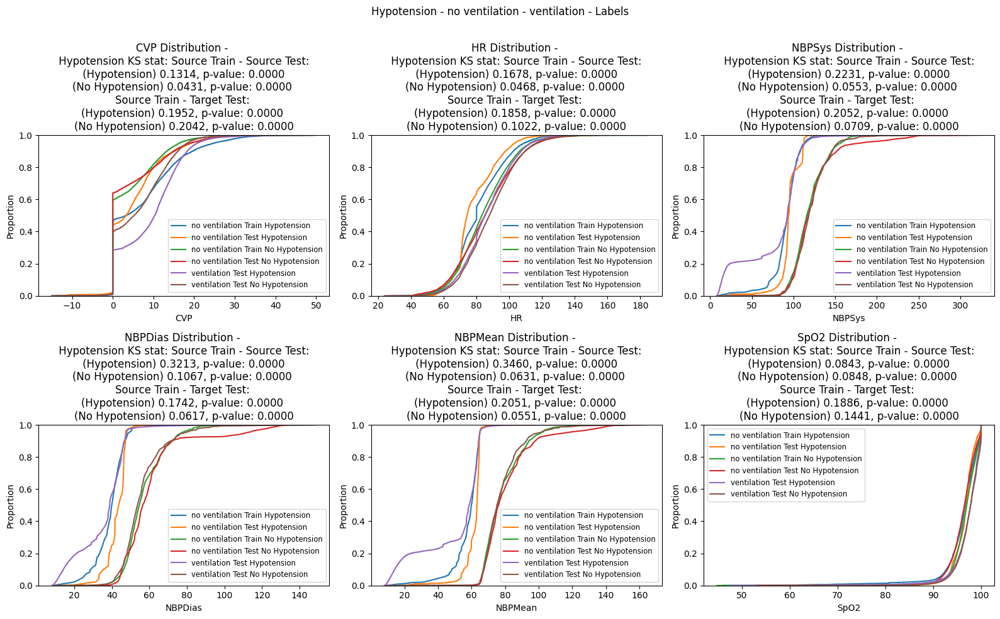

C:\Users\Mayra Elwes\AppData\Local\Temp\ipykernel_19172\3385178460.py:43: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout(rect=[0, 0, 1, 0.97])


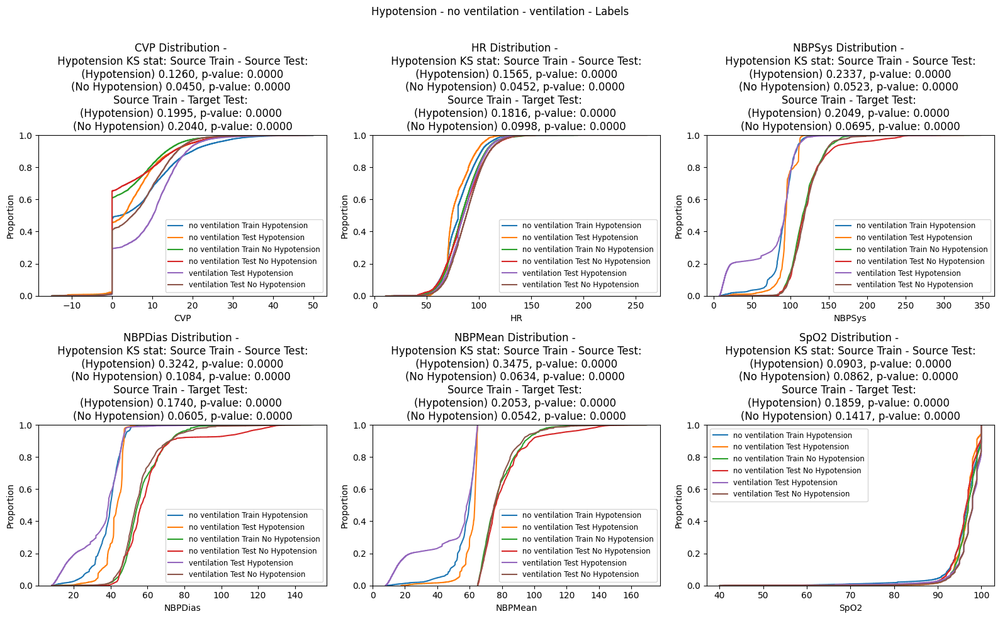

In [ ]:
visual_comparison_source_train_source_test_target_test(no_ventilation_train, no_ventilation_test, ventilation_train, ventilation_test,  "no_ventilation", "ventilation", plot_distribution_compare)
print("Hypoxemia - No Ventilation - Ventilation")
visual_comparison_source_train_source_test_target_test_class_wise("no_ventilation", "ventilation", "Hypoxemia", plot_distribution_compare_class_wise)
print("Hypotension")
visual_comparison_source_train_source_test_target_test_class_wise( "no_ventilation", "ventilation","Hypotension", plot_distribution_compare_class_wise)
print("Cumulative")
visual_comparison_source_train_source_test_target_test(no_ventilation_train, no_ventilation_test, ventilation_train, ventilation_test, "no_ventilation", "ventilation", plot_cumulative_distribution_compare)
print("Hypoxemia Cumulative")
visual_comparison_source_train_source_test_target_test_class_wise("no_ventilation","ventilation",  "Hypoxemia", plot_cumulative_distribution_compare_classwise)
print("Hypotension Cumulative")
visual_comparison_source_train_source_test_target_test_class_wise("no_ventilation", "ventilation", "Hypotension", plot_cumulative_distribution_compare_classwise)